# RSA analysis for 2023 fMRI data
### By: Linjing Jiang
### Updated on 5/25/2024

This script implements an RSA analysis for fMRI subjects collected from July 2023 to Dec 2024.
Here, I used the most updated RSA toolbox: https://rsatoolbox.readthedocs.io/en/stable/getting_started.html, 
https://github.com/rsagroup/rsatoolbox.

Before running this analysis, please run the following in order:
1. Spatiotemporal GLM first level in SPM (MATLAB) using '/mnt/Data1/linjdata1/vswmda/script/spm_glm/first_level_glm_spatiotemporal.m'. The output is under '/mnt/Data1/linjdata1/vswmda/scan_data/spm/output/preproc_st_spatiotemporal_censor'

2. Extract Beta map per experimental condition per run per ROI,using the '/mnt/Data1/linjdata1/vswmda/script/rsa_lj/prep_beta_map_for_mvpa.m' and '/mnt/Data1/linjdata1/vswmda/script/rsa_lj/get_beta_labels.m'. The output is under '/mnt/Data1/linjdata1/vswmda/scan_data/rsa/beta_run_rsa/f16/beta'

3. Prepare beta maps for rsa, using '/mnt/Data1/linjdata1/vswmda/script/rsa_lj/rsa_data_prep_beta_run_2024.m'. The output is a variable called 'responsePatterns' that is stored under '/mnt/Data1/linjdata1/vswmda/scan_data/rsa/beta_run_rsa/f16/'

After running these scripts, you will get a .mat files under the '/mnt/Data1/linjdata1/vswmda/scan_data/rsa/beta_run_rsa/f16/' folder:

1) responsePattern.mat: Contains extracted bold data across voxels for different ROIs and different sessions/participants.
- 'responsePatterns': data ready for RSA
- This is a 1 x 1 structure, containing 
    - responsePatterns.stim
    - responsePatterns.delay
    - responsePatterns.response
    - corresponding to different task epochs(stimulus, delay, and response)
    - output directory:  '/mnt/Data1/linjdata1/vswmda/scan_data/rsa/beta_run_rsa/f16/'

- for each task epoch, e.g., responsePatterns.stim. It is a 1 x N structure, where N is the number of ROIs x number of sessions x number of participants. For example, if there are 7 ROIs, 1 participants and 2 sessions per participant, then we get a 1 x 14 structure. 

- Within each structure, there are several fields:
    - 'name': ROI name | session | participant id
    - 'data': a V x R x C matrix, where V is the number of voxels in that ROI, R is the number of runs (not trials, because we are using run-wise beta maps derived from first-level GLM), C is the number of conditions. For example, if there are 400 voxels in that ROI, 3 runs of beta maps per condition, and 8 conditions, then we get a 400 x 3 x 8 matrix.
    
You will get another .mat file under the '/mnt/Data1/linjdata1/vswmda/scan_data/rsa/beta_run_rsa/' folder:

2) model.mat: Contains models



In [1]:
# relevant imports
import numpy as np
from scipy import io
import matplotlib.pyplot as plt
from matplotlib import rcParams
import rsatoolbox
import rsatoolbox.data as rsd # abbreviation to deal with dataset
import rsatoolbox.rdm as rsr
import os
import seaborn as sns
import sklearn as sk
import math
import pandas as pd
import pickle
import copy
import nibabel as nib
import re

In [2]:
# change the working directory to be the timecourse data
#os.chdir('/mnt/Data1/linjdata1/vswmda/scan_data/rsa/full_GLM_mgs_0.05_50/')
#os.chdir('/gpfs/scratch/linjjiang/scan_data/rsa/full_GLM_mgs_0.05_50/')
os.chdir('/gpfs/scratch/linjjiang/scan_data/rsa/full_GLM_atlas_roi/')

In [3]:
pwd

'/gpfs/scratch/linjjiang/scan_data/rsa/full_GLM_atlas_roi'

In [4]:
subjects = ['f09','f10','f11','f12','f15','f16','f17','f18','f19']
epochs = ['delay','response','stimulus']
exp1_subjects = ['f09','f10','f11','f12','f15','f16']
exp2_subjects = ['f17','f18','f19']

In [5]:
# get ROI name
# # if full_GLM_atlas_roi
order = ['area4-ju50',        
          'v1-wang25','v2-wang25',
          'ips0-wang15','ips1-wang15','ips2-wang15','ips3-wang15',
          'ips4-wang15','ips5-wang15','spl1-wang15','ips-wang15',
         'fef-wang25','spcs-md','ipcs-md','pmfg-md','amfg-md','ifg-md'
          ] 
         #'area8-hcp','area9-hcp','area9|46-hcp','area44|45|47l-hcp','fef-hcp',


# for atlas_roi:
order_full = ['area4-ju50',        
          'v1-wang25','v2-wang25',
          'ips0-wang15','ips1-wang15','ips2-wang15','ips3-wang15',
          'ips4-wang15','ips5-wang15','spl1-wang15','ips-wang15',
         'fef-wang25','spcs-md','ipcs-md','pmfg-md','amfg-md','ifg-md',
              'area8-hcp','area9-hcp','area9|46-hcp','area44|45|47l-hcp','fef-hcp'
          ] 
         #'area8-hcp','area9-hcp','area9|46-hcp','area44|45|47l-hcp','fef-hcp',
    
    
# if full_GLM_mgs_xxx
# order = ['area4', 'v1', 'v2', 'ips', 'fef', 'sfg', 'mfg', 'ifg',
#          'ips0', 'ips1', 'ips2', 'ips3', 'ips4', 'ips5', 'spl1']
# for mgs roi:
# order_full = order

In [6]:
print(order)

['area4-ju50', 'v1-wang25', 'v2-wang25', 'ips0-wang15', 'ips1-wang15', 'ips2-wang15', 'ips3-wang15', 'ips4-wang15', 'ips5-wang15', 'spl1-wang15', 'ips-wang15', 'fef-wang25', 'spcs-md', 'ipcs-md', 'pmfg-md', 'amfg-md', 'ifg-md']


In [7]:
# change the following as needed
# roi_labels = {'area4': 'M1', 'v1': 'V1', 'v2': 'V2', 
              
#               'ips0': 'IPS0', 'ips1': 'IPS1', 'ips2': 'IPS2', 
#               'ips3': 'IPS3', 'ips4': 'IPS4', 'ips5': 'IPS5', 'spl1': 'SPL1',
              
#           'ips': 'IPS', 'fef': 'FEF', 'sfg': 'SFG', 
#           'mfg': 'MFG', 'ifg': 'IFG'}

roi_labels = {'area4-ju50': 'M1-Julich', 'v1-wang25': 'V1-Wang25', 'v2-wang25': 'V2-Wang25', 
              
              'ips0-wang15': 'IPS0-Wang15', 'ips1-wang15': 'IPS1-Wang15', 'ips2-wang15': 'IPS2-Wang15', 
              'ips3-wang15': 'IPS3-Wang15', 'ips4-wang15': 'IPS4-Wang15', 'ips5-wang15': 'IPS5-Wang15', 
              'spl1-wang15': 'SPL1-Wang15',
              
          'ips-wang15': 'IPS-Wang15', 'fef-wang25': 'FEF-Wang25', 'spcs-md': 'sPCS-MD', 
          'ipcs-md': 'iPCS-MD', 'amfg-md': 'aMFG-MD', 'pmfg-md': 'pMFG-MD','ifg-md': 'IFG-MD'}

# roi_order = list(roi_labels.values())
subj_labels = {index: subject for index, subject in enumerate(subjects, start=0)}
epoch_labels = {0: 'stimulus', 1: 'delay', 2: 'response'}

In [8]:
def list_subfolders(directory):
    subfolders = [f.name for f in os.scandir(directory) if f.is_dir()]
    return subfolders

# directory = 'path/to/your/folder'
# subfolders = list_subfolders(directory)

## Calculate complex RDM (8 spatiotemporal categories) using cross-nobis distance

In [9]:
def sort_list(lst1,lst2):
    # Create a dictionary to map strings to values, eliminating duplicates
    correspondence = dict(zip(lst1,lst2))

    # Convert the dictionary to a list of tuples
    unique_pairs = list(correspondence.items())

    # Sort the list of tuples based on the scalar values
    sorted_pairs = sorted(unique_pairs, key=lambda x: x[0])

    # Extract the sorted unique strings
    sorted_lst = [pair[1] for pair in sorted_pairs]
    
    return sorted_lst

In [10]:
# Now let's remove outliers
def detect_outliers_mad_2d(residuals, threshold=3.5):
    median_resid = np.median(residuals)
    mad_resid = np.median(np.abs(residuals - median_resid))
    modified_z_scores = 0.6745 * (residuals - median_resid) / mad_resid
    outliers = np.where(np.abs(modified_z_scores) > threshold)
    return outliers

def remove_outliers(residuals, outliers):
    unique_cols = np.unique(outliers[1])
    filtered_residuals = np.delete(residuals, unique_cols, axis=1)
    return filtered_residuals

def combine_outliers(outliers1, outliers2):
    combined_rows = np.union1d(outliers1[0], outliers2[0])
    combined_columns = np.union1d(outliers1[1], outliers2[1])
    return (combined_rows, combined_columns)

# Cross-nobis distance by subject, roi and session

In [11]:
# For debug

In [134]:
epoch = 0
subject = 'f12'

# 4) _dataset_merge_across_sess_all: combined runs and sessions for complex conditions
# suitable for running complex spatiotemporal condition model
with open(os.path.join(subject,subject+'_'+epochs[epoch]+'_dataset_merge_across_sess_all.pkg'),'rb') as f:
    dataset = pickle.load(f)


uniq_roi = order #['area4', 'v1', 'v2', 'ips', 'fef', 'sfg', 'mfg', 'ifg']
uniq_sess = sorted(set(dataset[0].obs_descriptors['sess_index']))

full_sess_name = sorted(list_subfolders(os.path.join(subject,'res')))
        
curr_roi = uniq_roi[1]
data_temp = copy.deepcopy([x for x in dataset if (x.descriptors['roi'] == curr_roi)])

datas = data_temp[0].split_obs('sess_index')

data = datas[0]
sess_idx = data.obs_descriptors['sess_index'][0]
curr_sess = full_sess_name[sess_idx]

with open(os.path.join(subject,'res',curr_sess,'all_subset_residual_'+curr_roi+'.pkg'),'rb') as f:
    residual_mat,dof_task,dof_all = pickle.load(f)  

In [136]:
print(data.measurements.shape,residual_mat.shape)
print(data.measurements.max(),residual_mat.max())

(24, 1200) (2490, 1200)
58.624794006347656 37.49806064275455


In [137]:
noise = rsatoolbox.data.noise.prec_from_residuals(residual_mat,dof_all,method='diag')


In [139]:
print(noise.max())

2.3714870115154927


In [140]:
# Let's calculate the cross-nobis distance
rdm = rsatoolbox.rdm.calc.calc_rdm_crossnobis(data,'pattern_index', noise=noise, cv_descriptor= 'run_pair_index',
                                              remove_mean = True)

/gpfs/home/linjjiang/.local/lib/python3.11/site-packages/numpy/core/numeric.py:407: RuntimeWarning: invalid value encountered in cast
  multiarray.copyto(res, fill_value, casting='unsafe')


In [142]:
print(rdm.get_matrices()[0].max())

22.15540404464238


In [12]:
# Now let's remove outliers
def detect_outliers_mad_2d(residuals, threshold=3.5):
    median_resid = np.median(residuals)
    mad_resid = np.median(np.abs(residuals - median_resid))
    modified_z_scores = 0.6745 * (residuals - median_resid) / mad_resid
    outliers = np.where(np.abs(modified_z_scores) > threshold)
    return outliers

def remove_outliers(residuals, outliers):
    unique_cols = np.unique(outliers[1])
    filtered_residuals = np.delete(residuals, unique_cols, axis=1)
    return filtered_residuals

def combine_outliers(outliers1, outliers2):
    combined_rows = np.union1d(outliers1[0], outliers2[0])
    combined_columns = np.union1d(outliers1[1], outliers2[1])
    return (combined_rows, combined_columns)

In [199]:
outliers_z = combine_outliers(detect_outliers_mad_2d(data.measurements),
                              detect_outliers_mad_2d(residual_mat))
filtered_data_z = remove_outliers(data.measurements, outliers_z)
filtered_residual = remove_outliers(residual_mat, outliers_z)

In [200]:
print(outliers_z)

(array([   0,    1,    2, ..., 2487, 2488, 2489]), array([   0,    1,    2, ..., 1197, 1198, 1199]))


In [201]:
print(filtered_data_z.shape)

(24, 196)


In [202]:
data.channel_descriptors

{'voxels': array(['voxel_0', 'voxel_1', 'voxel_2', ..., 'voxel_1197', 'voxel_1198',
        'voxel_1199'], dtype='<U10')}

In [203]:
data1 = copy.deepcopy(data)
data1.measurements = filtered_data_z
data1.n_channel = filtered_data_z.shape[1]
data1.channel_descriptors['voxels'] = ['voxel_'+str(i) for i in range(data1.n_channel)]
len(data1.channel_descriptors['voxels'])

196

In [204]:
print(data1.measurements.shape,filtered_residual.shape)
print(data1.measurements.max(),filtered_residual.max())

(24, 196) (2490, 196)
8.140278816223145 4.32281371091527


In [206]:
noise = rsatoolbox.data.noise.prec_from_residuals(filtered_residual,dof_all,method='shrinkage_diag')
print(noise.max())

24.322580739729744


In [207]:
rdm = rsatoolbox.rdm.calc.calc_rdm_crossnobis(data1,'pattern_index', noise=noise, cv_descriptor= 'run_pair_index',
                                                              remove_mean = True)

In [208]:
print(rdm.get_matrices()[0].max())

1.7886323237501902


In [209]:
print(rdm)

rsatoolbox.rdm.RDMs
1 RDM(s) over 8 conditions

dissimilarity_measure = 
crossnobis

dissimilarities[0] = 
[[ 0.         -0.14999363  1.78863232  0.86906655 -0.59087388  0.1266246
  -0.35138727  1.18665378]
 [-0.14999363  0.          1.47502683  1.51098473 -2.87925291 -2.21848364
   0.04791633 -0.29050594]
 [ 1.78863232  1.47502683  0.         -0.93527495 -2.75349879 -1.55393811
  -0.98527523  0.06663993]
 [ 0.86906655  1.51098473 -0.93527495  0.         -4.28337982  0.36231097
  -1.04506282 -2.29766494]
 [-0.59087388 -2.87925291 -2.75349879 -4.28337982  0.         -2.3335997
  -1.47208111 -3.208724  ]
 [ 0.1266246  -2.21848364 -1.55393811  0.36231097 -2.3335997   0.
  -0.91399325 -0.51553279]
 [-0.35138727  0.04791633 -0.98527523 -1.04506282 -1.47208111 -0.91399325
   0.         -0.90218591]
 [ 1.18665378 -0.29050594  0.06663993 -2.29766494 -3.208724   -0.51553279
  -0.90218591  0.        ]]

descriptors: 
noise = [[ 1.49626248  0.04865777 -0.17073983 ... -0.11355498  0.01021119
   0.

In [13]:
RDM = []
import itertools
for epoch,subject in itertools.product(range(3), subjects):
        print(epoch,subject)
        # 4) _dataset_merge_across_sess_all: combined runs and sessions for complex conditions
        # suitable for running complex spatiotemporal condition model
        with open(os.path.join(subject,subject+'_'+epochs[epoch]+'_dataset_merge_across_sess_all.pkg'),'rb') as f:
            dataset = pickle.load(f)

        uniq_roi = order #['area4', 'v1', 'v2', 'ips', 'fef', 'sfg', 'mfg', 'ifg']
        uniq_sess = sorted(set(dataset[0].obs_descriptors['sess_index']))
        
        full_sess_name = sorted(list_subfolders(os.path.join(subject,'res')))
        
        #print(len(dataset))
        for curr_roi in uniq_roi:
            data_temp = copy.deepcopy([x for x in dataset if (x.descriptors['roi'] == curr_roi)])
            #print(len(data_temp),data_temp)
            
            datas = data_temp[0].split_obs('sess_index')
             
            for data in datas:
                sess_idx = data.obs_descriptors['sess_index'][0]
                curr_sess = full_sess_name[sess_idx]
                
                with open(os.path.join(subject,'res',curr_sess,'all_subset_residual_'+curr_roi+'.pkg'),'rb') as f:
                    residual_mat,dof_task,dof_all = pickle.load(f)  
                
                
                outliers_z = detect_outliers_mad_2d(data.measurements)
                filtered_data_z = remove_outliers(data.measurements, outliers_z)
                filtered_residual = remove_outliers(residual_mat, outliers_z)
                
                data1 = copy.deepcopy(data)
                data1.measurements = filtered_data_z
                data1.n_channel = filtered_data_z.shape[1]
                data1.channel_descriptors['voxels'] = ['voxel_'+str(i) for i in range(data1.n_channel)]

                noise = rsatoolbox.data.noise.prec_from_residuals(filtered_residual,dof_all,method='diag')
                rdm = rsatoolbox.rdm.calc.calc_rdm_crossnobis(data1,'pattern_index', noise=noise, cv_descriptor= 'run_pair_index',
                                                                              remove_mean = True)                
                
                #noise = rsatoolbox.data.noise.prec_from_measurements(data, 'run_pair_index', dof=None, method='shrinkage_diag')
#                 noise = rsatoolbox.data.noise.prec_from_residuals(residual_mat,dof_all,method='shrinkage_diag')
                
#                 # Let's calculate the cross-nobis distance
#                 rdm = rsatoolbox.rdm.calc.calc_rdm_crossnobis(data,'pattern_index', noise=noise, cv_descriptor= 'run_pair_index',
#                                                               remove_mean = True)
                rdm.rdm_descriptors['session'] = sess_idx
                rdm.rdm_descriptors['session_name'] = curr_sess
                rdm.rdm_descriptors['epoch'] = epochs[epoch]
                rdm.rdm_descriptors['name'] = rdm.rdm_descriptors['name'][0]+' | Session '+str(rdm.rdm_descriptors['session'])
                RDM.append(rdm)
        
with open('rdm_crossnobis_split_by_sess_all.pkg','wb') as f:
    pickle.dump(RDM,f)           


0 f09


/gpfs/home/linjjiang/.local/lib/python3.11/site-packages/numpy/core/numeric.py:407: RuntimeWarning: invalid value encountered in cast
  multiarray.copyto(res, fill_value, casting='unsafe')
/gpfs/home/linjjiang/.local/lib/python3.11/site-packages/rsatoolbox/data/computations.py:36: RuntimeWarning: invalid value encountered in multiply
  average = np.nan * np.empty(


0 f10
0 f11


/gpfs/home/linjjiang/.local/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/gpfs/home/linjjiang/.local/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/gpfs/home/linjjiang/.local/lib/python3.11/site-packages/rsatoolbox/rdm/calc.py:352: RuntimeWarning: Mean of empty slice.
  measurements_train -= measurements_train.mean(axis=1, keepdims=True)
/gpfs/home/linjjiang/.local/lib/python3.11/site-packages/numpy/core/_methods.py:121: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
/gpfs/home/linjjiang/.local/lib/python3.11/site-packages/rsatoolbox/rdm/calc.py:353: RuntimeWarning: Mean of empty slice.
  measurements_test -= measurements_test.mean(axis=1, keepdims=True)
/gpfs/home/linjjiang/.local/lib/python3.11/site-packages/rsatoolbox/rdm/calc.py:473: RuntimeWarni

0 f12
0 f15
0 f16
0 f17
0 f18
0 f19
1 f09
1 f10
1 f11
1 f12
1 f15
1 f16
1 f17
1 f18
1 f19
2 f09
2 f10
2 f11
2 f12
2 f15
2 f16
2 f17
2 f18
2 f19


In [15]:
print(len(RDM))

867


# Plot cross-nobis distance (split by session)

In [11]:
with open('rdm_crossnobis_split_by_sess_all.pkg','rb') as f:
    RDM = pickle.load(f)

In [12]:
rdm = RDM[0]
conds = rdm.pattern_descriptors['conds']
print(conds)
print(rdm.rdm_descriptors)

['3WL' '3TL' '3WR' '3TR' '5.5WL' '5.5TL' '5.5WR' '5.5TR']
{'subj': ['f09'], 'roi': ['area4'], 'name': 'f09 | area4 | Session 0', 'index': [0], 'session': 0, 'session_name': 'S5752', 'epoch': 'delay'}


In [13]:
rdm = RDM[-1]
conds = rdm.pattern_descriptors['conds']
print(conds)

['CWL' 'CTL' 'CWR' 'CTR' 'NWL' 'NTL' 'NWR' 'NTR']


In [14]:
idx = 0
new_conds = [x[-1] for x in conds]
new_conds_index = [idx if x == 'L'
                   else idx+1 for x in new_conds]
print(new_conds,new_conds_index)

['L', 'L', 'R', 'R', 'L', 'L', 'R', 'R'] [0, 0, 1, 1, 0, 0, 1, 1]


In [15]:
a = rdm.get_matrices()[0]
val = np.nanmean(a[np.where(~np.eye(a.shape[0],dtype=bool))])
# for L-R
labels = [x[-1] for x in conds]
rows_L = [i for i, label in enumerate(labels) if label == 'L']
cols_R = [i for i, label in enumerate(labels) if label == 'R']
print(rows_L,cols_R,np.ix_(rows_L, cols_R))
print(a[np.ix_(rows_L, cols_R)])
val_LR = np.nanmean(a[np.ix_(rows_L, cols_R)])
print(val_LR)
indices = np.array([[0, 2], [1, 3], [4, 6], [5, 7]])
val_LR = np.nanmean([a[row, col] for row, col in indices])
print(val_LR)

[0, 1, 4, 5] [2, 3, 6, 7] (array([[0],
       [1],
       [4],
       [5]]), array([[2, 3, 6, 7]]))
[[-0.7013848  -0.16593322 -0.27723952 -0.11380333]
 [-0.92883082  1.17556575  0.45158437  0.95617333]
 [-1.06373732 -0.4801227   1.01612973 -0.03482151]
 [-0.32582623  0.32188585  0.89292521 -0.1526919 ]]
0.03561705510379806
0.33440469499558695


In [16]:
print(a)

[[ 0.         -0.05329147 -0.7013848  -0.16593322 -0.39273593  0.39286165
  -0.27723952 -0.11380333]
 [-0.05329147  0.         -0.92883082  1.17556575  0.81141247  1.00171815
   0.45158437  0.95617333]
 [-0.7013848  -0.92883082  0.         -0.92901505 -1.06373732 -0.32582623
  -0.58465751 -0.36653677]
 [-0.16593322  1.17556575 -0.92901505  0.         -0.4801227   0.32188585
   0.65335315 -0.23771341]
 [-0.39273593  0.81141247 -1.06373732 -0.4801227   0.          0.42854922
   1.01612973 -0.03482151]
 [ 0.39286165  1.00171815 -0.32582623  0.32188585  0.42854922  0.
   0.89292521 -0.1526919 ]
 [-0.27723952  0.45158437 -0.58465751  0.65335315  1.01612973  0.89292521
   0.          0.06429238]
 [-0.11380333  0.95617333 -0.36653677 -0.23771341 -0.03482151 -0.1526919
   0.06429238  0.        ]]


In [17]:
labels = [x[-2] for x in conds]
rows_W = [i for i, label in enumerate(labels) if label == 'W']
cols_T = [i for i, label in enumerate(labels) if label == 'T']
print(np.ix_(rows_W, cols_T))
print(a[np.ix_(rows_W, cols_T)])

(array([[0],
       [2],
       [4],
       [6]]), array([[1, 3, 5, 7]]))
[[-0.05329147 -0.16593322  0.39286165 -0.11380333]
 [-0.92883082 -0.92901505 -0.32582623 -0.36653677]
 [ 0.81141247 -0.4801227   0.42854922 -0.03482151]
 [ 0.45158437  0.65335315  0.89292521  0.06429238]]


In [18]:
labels = [x[0] for x in conds]
rows_3_C = [i for i, label in enumerate(labels) if (label == '3') | (label == 'C')]
cols_5_N = [i for i, label in enumerate(labels) if (label == '5') | (label == 'N')]
print(rows_3_C,cols_5_N,np.ix_(rows_3_C, cols_5_N))

[0, 1, 2, 3] [4, 5, 6, 7] (array([[0],
       [1],
       [2],
       [3]]), array([[4, 5, 6, 7]]))


In [19]:
print('f19' in exp1_subjects)

False


# Plot any condition-pair differences

In [16]:
dis_val_all = pd.DataFrame()
      
for rdm in RDM:
    subj = rdm.rdm_descriptors['subj']
    roi = rdm.rdm_descriptors['roi']
    session = rdm.rdm_descriptors['session']+1
    epoch = rdm.rdm_descriptors['epoch']
    conds = rdm.pattern_descriptors['conds']
    #print(subj,roi,session,epoch)


    a = rdm.get_matrices()[0]
    val = np.nanmean(a[np.where(~np.eye(a.shape[0],dtype=bool))])

#     # for L-R
#     labels = [x[-1] for x in conds]
#     rows_L = [i for i, label in enumerate(labels) if label == 'L']
#     cols_R = [i for i, label in enumerate(labels) if label == 'R']
#     val_LR = np.nanmean(a[np.ix_(rows_L, cols_R)])

#     # for W-T
#     labels = [x[-2] for x in conds]
#     rows_W = [i for i, label in enumerate(labels) if label == 'W']
#     cols_T = [i for i, label in enumerate(labels) if label == 'T']
#     val_WT = np.nanmean(a[np.ix_(rows_W, cols_T)])

#     # for ecc or CN
#     labels = [x[0] for x in conds]
#     rows_3_C = [i for i, label in enumerate(labels) if (label == '3') | (label == 'C')]
#     cols_5_N = [i for i, label in enumerate(labels) if (label == '5') | (label == 'N')]
#     val_ecc_or_CN = np.nanmean(a[np.ix_(rows_3_C, cols_5_N)])

    indices = np.array([[0, 2], [1, 3], [4, 6], [5, 7]])
    val_LR = np.nanmean([a[row, col] for row, col in indices])
    
    indices = np.array([[0, 1], [2, 3], [4, 5], [6, 7]])
    val_WT = np.nanmean([a[row, col] for row, col in indices])
    
    indices = np.array([[0, 4], [1, 5], [2, 6], [3, 7]])
    val_ecc = np.nanmean([a[row, col] for row, col in indices])
    
    indices = np.array([[0, 3], [1, 2], [4, 7], [5, 6]])
    val_LRWT = np.nanmean([a[row, col] for row, col in indices])
    
    indices = np.array([[0, 5], [1, 4], [2, 7], [3, 6]])
    val_eccWT = np.nanmean([a[row, col] for row, col in indices])
    
    indices = np.array([[0, 6], [1, 7], [2, 4], [3, 5]])
    val_eccLR = np.nanmean([a[row, col] for row, col in indices])
    
    indices = np.array([[0, 7], [1, 6], [2, 5], [3, 4]])
    val_all = np.nanmean([a[row, col] for row, col in indices]) 
    

    if subj[0] in exp1_subjects:
        df = pd.DataFrame({'rdm':[a],'data':[val],'data_LR':[val_LR],'data_WT':[val_WT],'data_ecc':[val_ecc],
                           'data_LRWT':[val_LRWT],'data_eccWT':[val_eccWT],'data_eccLR':[val_eccLR],'data_eccLRWT':[val_all],
                           'subj':subj,'roi':roi,'session':['Session '+str(session)],'epoch':[epoch]})
    else:
        df = pd.DataFrame({'rdm':[a],'data':[val],'data_LR':[val_LR],'data_WT':[val_WT],'data_CN':[val_ecc],
                            'data_LRWT':[val_LRWT],'data_CNWT':[val_eccWT],'data_CNLR':[val_eccLR],'data_CNLRWT':[val_all],
                           'subj':subj,'roi':roi,'session':['Session '+str(session)],'epoch':[epoch]})                
    dis_val_all = pd.concat([dis_val_all,df],axis=0)


/tmp/ipykernel_2187/983526267.py:13: RuntimeWarning: Mean of empty slice
  val = np.nanmean(a[np.where(~np.eye(a.shape[0],dtype=bool))])
/tmp/ipykernel_2187/983526267.py:34: RuntimeWarning: Mean of empty slice
  val_LR = np.nanmean([a[row, col] for row, col in indices])
/tmp/ipykernel_2187/983526267.py:37: RuntimeWarning: Mean of empty slice
  val_WT = np.nanmean([a[row, col] for row, col in indices])
/tmp/ipykernel_2187/983526267.py:40: RuntimeWarning: Mean of empty slice
  val_ecc = np.nanmean([a[row, col] for row, col in indices])
/tmp/ipykernel_2187/983526267.py:43: RuntimeWarning: Mean of empty slice
  val_LRWT = np.nanmean([a[row, col] for row, col in indices])
/tmp/ipykernel_2187/983526267.py:46: RuntimeWarning: Mean of empty slice
  val_eccWT = np.nanmean([a[row, col] for row, col in indices])
/tmp/ipykernel_2187/983526267.py:49: RuntimeWarning: Mean of empty slice
  val_eccLR = np.nanmean([a[row, col] for row, col in indices])
/tmp/ipykernel_2187/983526267.py:52: RuntimeWarnin

In [17]:
print(subj)

['f19']


In [18]:
print(dis_val_all)

                                                  rdm      data   data_LR  \
0   [[0.0, -0.9625671907270866, -0.017911087878801...  0.144980 -0.367578   
0   [[0.0, 0.3893989903902995, 0.6421662144474842,... -0.128582 -1.063385   
0   [[0.0, -1.452618902700597, 1.0121536383810021,... -0.273145 -0.621271   
0   [[0.0, 0.8556501284906982, 0.2913574939882276,...  0.256217 -0.149066   
0   [[0.0, 1.4842180853328413, -0.2401073655840118...  0.289828 -0.310048   
..                                                ...       ...       ...   
0   [[0.0, 0.23646292570501395, -0.311723769812066...  0.140781  0.175008   
0   [[0.0, -0.052436473283121836, -0.1741575483884...  0.084724 -0.153978   
0   [[0.0, 0.0659021477418542, 0.09502194380267888...  0.154708  0.064824   
0   [[0.0, 0.050692312651401415, -0.14537019907348... -0.119007 -0.064371   
0   [[0.0, -0.10459504163401283, -0.53196204603165...  0.113465  0.064193   

     data_WT  data_ecc  data_LRWT  data_eccWT  data_eccLR  data_eccLRWT sub

In [19]:
print(dis_val_all[(dis_val_all['subj']=='f10') 
                  & (dis_val_all['epoch']=='delay')  
                  & (dis_val_all['session']=='Session 1')])

                                                 rdm      data   data_LR  \
0  [[0.0, -0.33901905855604353, -0.13753803911899... -0.183829 -0.200319   
0  [[0.0, 0.002592876569077048, -0.55137901089915...  0.484743 -0.183474   
0  [[0.0, 0.8792577377672752, -0.9893767086361939...  0.611417 -0.386078   
0  [[0.0, -0.24213169386066477, -0.52702057131558...  0.246194 -0.027919   
0  [[0.0, -0.9010710218212914, -1.087052168446161...  0.511733  0.231733   
0  [[0.0, -0.5000880809505803, -0.784400083506104...  0.891339  0.453124   
0  [[0.0, 0.10977715094649575, -0.604963741150379...  0.108660  0.428955   
0  [[0.0, 0.029780175447857105, -0.28712566995620...  0.336307  0.311525   
0  [[0.0, -0.4095439831672925, -0.108391317720147...  0.113193 -0.062117   
0  [[0.0, 0.19174662723679847, -0.547925150632862...  0.366942  0.080069   
0  [[0.0, -0.3575368177271594, -0.838223381402251...  0.484576  0.095530   
0  [[0.0, -0.11288217803422511, -0.30767133012494...  0.055458 -0.131590   
0  [[0.0, -0

In [20]:
dis_val_all['roi'] = dis_val_all['roi'].map(roi_labels)

# set up index of the dataframe
dis_val_all.index = range(len(dis_val_all))

In [21]:
dis_val_all['subj'].unique().shape[0]

9

In [22]:
print(sns.color_palette("Set2", dis_val_all['subj'].unique().shape[0])[0])

(0.4, 0.7607843137254902, 0.6470588235294118)


In [23]:
# # let's plot!
from matplotlib.patches import Patch
def plot_group_dsm(dis_val_all,title,roi_labels,subj_labels,epoch_labels,data_column_name,session_palette):
    roi_order = list(roi_labels.values())

    # Define color-blind friendly palettes
    #session_palette = ['#D3D3D3', '#A9A9A9']  #sns.color_palette("colorblind", 2) 
    # A distinct color palette for participants
    participant_palette = sns.color_palette("colorblind", dis_val_all['subj'].unique().shape[0])

    # Offset for the scatter points to align with the bar centers
    session_offsets = {'Session 1': -0.2, 'Session 2': 0.2}

    # Function to plot scatter points and connecting lines
    def scatter_and_lines(data, **kwargs):
        ax = plt.gca()
        
        # Plot scatter points
        for session, offset in session_offsets.items():
            subset = data[data['session'] == session]
            x_coords = [roi_order.index(roi) + offset for roi in subset['roi']]
            if session == 'Session 1':
                sns.scatterplot(x=x_coords, y=subset[data_column_name], hue=subset['subj'], palette=participant_palette, 
                                style=subset['session'], edgecolor='black', s=50, ax=ax, alpha=1, **kwargs)
            else:
                sns.scatterplot(x=x_coords, y=subset[data_column_name], hue=subset['subj'], palette=participant_palette[1:], 
                                style=subset['session'], edgecolor='black', s=50, ax=ax, alpha=1, **kwargs)                
        # Plot connecting lines
        for _, group in data.groupby(['subj', 'roi']):
            participant_index = list(subj_labels.values()).index(group['subj'].iloc[0])  # Use integer index to access the palette
            x_coords = [roi_order.index(roi) + session_offsets[session] for roi, session in zip(group['roi'], group['session'])]
            ax.plot(x_coords, group[data_column_name], color=participant_palette[participant_index], linewidth=2, linestyle='--', alpha=1)

    # Plotting
    task_epoch_order = ["stimulus", "delay", "response"]
    plt.figure(figsize=(8, 12))
    g = sns.FacetGrid(dis_val_all, col="epoch", col_order=task_epoch_order, col_wrap=1, height=4, aspect=4)
#     g.map_dataframe(sns.boxplot, x='roi', y=data_column_name, hue='session', 
#            order=roi_order,dodge=True, palette=session_palette) #ci='sd',errcolor='#A9A9A9', errwidth=1, capsize=0, 
    g.map_dataframe(sns.barplot, x='roi', y=data_column_name, hue='session',
                    order=roi_order,errorbar=None,dodge=True, palette=session_palette,zorder=1) #hue='session',
    
    # Adjusting the labels and titles
    g.set_axis_labels("Regions of Interest (ROI)", "Crossnobis distance")
    g.set_titles(col_template="{col_name}", row_template="")

    # # Setting an overall title
    # g.fig.suptitle("Comparison of ROI Values Across Sessions and Task Epochs", fontsize=16)

    # Adjusting the legend
    for ax in g.axes.flat:
        if ax.legend_:
            ax.legend_.remove()
        ax.axhline(0, color='black', linestyle='--', linewidth=2)

    # Manually create a legend
    handles, labels = [], []
    for participant, color in zip(subj_labels.values(), participant_palette):
        handles.append(plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=color, alpha = 1, markersize=10, label=participant))

    handles += [
        Patch(facecolor=session_palette[0], edgecolor='black', label='Session 1'),
        Patch(facecolor=session_palette[1], edgecolor='black', label='Session 2')
    ]

    g.map_dataframe(scatter_and_lines)
    
    # Adjusting font sizes for axes
    for ax in g.axes.flat:
        ax.set_xlabel(ax.get_xlabel(), fontsize=20)
        ax.set_ylabel(ax.get_ylabel(), fontsize=20)
        ax.set_title(ax.get_title(), fontsize=22)
        ax.tick_params(axis='x', labelsize=20)
        ax.tick_params(axis='y', labelsize=20)

    # # Adjust layout to make room for the overall title
    # plt.subplots_adjust(top=0.9)

    g.fig.legend(handles=handles, ncol=4,bbox_to_anchor=(1,1))

    plt.show()
    g.savefig(title,bbox_inches = 'tight')
    

In [24]:
def plot_group_dsm_star(dis_val_all, title, roi_labels, subj_labels, epoch_labels, data_column_name, 
                        session_palette, significance_df, sig_df1, aspect, ylim0, ylim1):
    roi_order = list(roi_labels.values())
    subj_order = list(subj_labels.values())

    # Define color-blind friendly palettes
    participant_palette = sns.color_palette("colorblind", dis_val_all['subj'].unique().shape[0])

    # Offset for the scatter points to align with the bar centers
    session_offsets = {'Session 1': -0.2, 'Session 2': 0.2}

    def scatter_and_lines(data, **kwargs):
        ax = plt.gca()

        # Plot scatter points
        for session, offset in session_offsets.items():
            subset = data[data['session'] == session]
            x_coords = [roi_order.index(roi) + offset for roi in subset['roi']]
            sns.scatterplot(x=x_coords, y=subset[data_column_name], hue=subset['subj'], palette=participant_palette, 
                            style=subset['session'], hue_order=subj_order, edgecolor='black', s=50, ax=ax, alpha=1, **kwargs)
            
        # Plot connecting lines
        for subj in subj_order:
            participant_data = data[data['subj'] == subj]
            if participant_data['session'].nunique() > 1:  # Check if data spans multiple sessions
                for roi in roi_order:
                    roi_data = participant_data[participant_data['roi'] == roi]
                    if roi_data.shape[0] > 1:  # Only plot lines if there are points in multiple sessions
                        x_coords = [roi_order.index(roi) + session_offsets[session] for session in roi_data['session']]
                        y_coords = [y for y in roi_data[data_column_name]]
                        participant_index = list(subj_labels.values()).index(subj)  # Use integer index to access the palette
                        ax.plot(x_coords, y_coords, color=participant_palette[participant_index], linewidth=2, linestyle='--', alpha=1)

    # Function to add significance stars
    def add_significance_stars(ax, current_epoch):
        # Filter the significance_df for the current epoch
        epoch_significance_df = significance_df[significance_df['epoch'] == current_epoch]

        for i, row in epoch_significance_df.iterrows():
            if row['p_value'] < 0.05:
                roi = row['roi']
                session = row['session']
                
                roi_idx = roi_order.index(roi)
                session_offset = session_offsets[session]
                x_coord = roi_idx + session_offset
                y_coord = dis_val_all[(dis_val_all['roi'] == roi) & 
                                      (dis_val_all['session'] == session) & 
                                      (dis_val_all['epoch'] == current_epoch)][data_column_name].max() + 0.1

                if row['p_value'] < 0.001:
                    stars = '***'
                elif row['p_value'] < 0.01:
                    stars = '**'
                else:
                    stars = '*'

                ax.annotate(stars, (x_coord, y_coord), textcoords="offset points", xytext=(0, 5), ha='center', fontsize=22, color='black')

    # Function to add between-session significance stars and horizontal lines
    def add_between_session_stars(ax, current_epoch):
        epoch_significance_df = sig_df1[sig_df1['epoch'] == current_epoch]

        for i, row in epoch_significance_df.iterrows():
            if row['p_value'] < 0.05:
                roi = row['roi']
                roi_idx = roi_order.index(roi)
                session1_offset = session_offsets['Session 1']
                session2_offset = session_offsets['Session 2']
                x_coord1 = roi_idx + session1_offset
                x_coord2 = roi_idx + session2_offset
                x_coord_mean = (x_coord1 + x_coord2) / 2
                y_coord = dis_val_all[(dis_val_all['roi'] == roi) & 
                                      (dis_val_all['epoch'] == current_epoch)][data_column_name].max() + 0.5

                if row['p_value'] < 0.001:
                    stars = '***'
                elif row['p_value'] < 0.01:
                    stars = '**'
                else:
                    stars = '*'

                ax.annotate(stars, (x_coord_mean, y_coord), textcoords="offset points", xytext=(0, 10), ha='center', fontsize=22, color='black')
                ax.plot([x_coord1, x_coord2], [y_coord+0.25, y_coord+0.25], color='black', linewidth=1.5, linestyle='-')

    # Plotting
    task_epoch_order = ["stimulus", "delay"]
    plt.figure(figsize=(8, 16))  # Adjust size as needed
    g = sns.FacetGrid(dis_val_all, col="epoch", col_order=task_epoch_order, col_wrap=1, height=4, aspect=aspect)
    g.map_dataframe(sns.barplot, x='roi', y=data_column_name, hue='session', order=roi_order, errorbar=None, dodge=True, palette=session_palette, zorder=1)

    # Adjusting the labels and titles
    g.set_axis_labels(" ", " ")
    g.set_titles(col_template="", row_template="")

    # Adjusting the legend
    for ax in g.axes.flat:
        if ax.legend_:
            ax.legend_.remove()
        ax.axhline(0, color='black', linestyle='--', linewidth=2)

    # Manually create a legend
    handles, labels = [], []
    for participant, color in zip(subj_labels.values(), participant_palette):
        handles.append(plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=color, alpha=1, markersize=10, label=participant))

    handles += [
        Patch(facecolor=session_palette[0], edgecolor='black', label='Session 1'),
        Patch(facecolor=session_palette[1], edgecolor='black', label='Session 2')
    ]

    g.map_dataframe(scatter_and_lines)

    # Add significance stars
    for ax, current_epoch in zip(g.axes.flat, task_epoch_order):
        plt.sca(ax)
        add_significance_stars(ax, current_epoch)
        add_between_session_stars(ax, current_epoch)

    # Adjusting font sizes for axes
    for ax in g.axes.flat:
        ax.set_xlabel(ax.get_xlabel(), fontsize=22)
        ax.set_ylabel(ax.get_ylabel(), fontsize=22)
        ax.set_title(ax.get_title(), fontsize=22)
        ax.tick_params(axis='x', labelsize=22)
        ax.tick_params(axis='y', labelsize=22)
        ax.set_ylim(ylim0, ylim1)

    plt.xticks(rotation=45)
    plt.subplots_adjust(hspace=0.1)
    
    plt.show()
    g.savefig(title, bbox_inches='tight', dpi=300)


In [25]:
from scipy.stats import ttest_1samp

def ttest_crossnobis(dis_val_all,colname):
    # Assuming your dataframe is named dis_val_all

    # Define the sessions, epochs, and ROIs you want to analyze
    sessions = dis_val_all['session'].unique()
    epochs = dis_val_all['epoch'].unique()
    rois = dis_val_all['roi'].unique()

    results = []

    # Loop through each combination of session, epoch, and ROI
    for session in sessions:
        for epoch in epochs:
            for roi in rois:
                # Filter the dataframe
                filtered_df = dis_val_all[(dis_val_all['session'] == session) &
                                          (dis_val_all['epoch'] == epoch) &
                                          (dis_val_all['roi'] == roi)]

                # Extract the 'data' values
                data_values = filtered_df[colname].dropna()

                if len(data_values) > 0:
                    # Perform a one-sample t-test
                    t_stat, p_value = ttest_1samp(data_values, 0, alternative='greater')

                    # Store the result
                    results.append({'session': session, 'epoch': epoch, 'roi': roi, 't_stat': t_stat, 'p_value': p_value})

    # Convert results to a dataframe
    results_df = pd.DataFrame(results)


    # Filter the results to only include rows with p_value less than 0.05
    significant_results_df = results_df[results_df['p_value'] < 0.05]

    # Define custom order for epochs
    epoch_order = ['stimulus', 'delay', 'response']

    # Convert 'epoch' column to a categorical type with the custom order
    significant_results_df['epoch'] = pd.Categorical(significant_results_df['epoch'], categories=epoch_order, ordered=True)

    # Sort by the custom epoch order
    significant_results_df = significant_results_df.sort_values(by=['session', 'epoch'])

    # Print the significant results
    return significant_results_df


In [26]:
from scipy.stats import ttest_rel
import pandas as pd

def ttest_paired_sessions(dis_val_all, colname, session1, session2):
    # Define the epochs and ROIs you want to analyze
    epochs = dis_val_all['epoch'].unique()
    rois = dis_val_all['roi'].unique()

    results = []

    # Loop through each combination of epoch and ROI
    for epoch in epochs:
        for roi in rois:
            # Filter the dataframe for each session
            data_session1 = dis_val_all[(dis_val_all['session'] == session1) &
                                        (dis_val_all['epoch'] == epoch) &
                                        (dis_val_all['roi'] == roi)][colname].dropna()

            data_session2 = dis_val_all[(dis_val_all['session'] == session2) &
                                        (dis_val_all['epoch'] == epoch) &
                                        (dis_val_all['roi'] == roi)][colname].dropna()

            # Ensure that data lengths match for paired test
            min_length = min(len(data_session1), len(data_session2))
            if min_length > 0:
                # Perform a paired t-test
                t_stat, p_value = ttest_rel(data_session1[:min_length], data_session2[:min_length])

                # Store the result
                results.append({'epoch': epoch, 'roi': roi, 'session1': session1, 'session2': session2, 't_stat': t_stat, 'p_value': p_value})

    # Convert results to a dataframe
    results_df = pd.DataFrame(results)

    # Filter the results to only include rows with p_value less than 0.05
    significant_results_df = results_df[results_df['p_value'] < 0.05]

    # Define custom order for epochs
    epoch_order = ['stimulus', 'delay', 'response']

    # Convert 'epoch' column to a categorical type with the custom order
    significant_results_df['epoch'] = pd.Categorical(significant_results_df['epoch'], categories=epoch_order, ordered=True)

    # Sort by the custom epoch order
    significant_results_df = significant_results_df.sort_values(by='epoch')

    # Print the significant results
    return results_df,significant_results_df

In [27]:
data_palette = sns.color_palette("tab20", 4)
session_palette= ['#D3D3D3', '#A9A9A9']#[data_palette[1],data_palette[3]]

In [28]:
# selected_rois = ['M1','V1','V2']
# selected_rois_key = ['area4','v1','v2']
selected_epochs = ['stimulus','delay']
selected_epochs_key = [0,1]
df = dis_val_all[(dis_val_all['epoch'].isin(selected_epochs))] #(dis_val_all['roi'].isin(selected_rois)) 

#selected_roi_labels = {key: roi_labels[key] for key in selected_rois_key if key in roi_labels}
selected_epoch_labels = {key: epoch_labels[key] for key in selected_epochs_key if key in epoch_labels}

In [29]:
print(roi_labels)
print(subj_labels)
print(selected_epoch_labels)

{'area4-ju50': 'M1-Julich', 'v1-wang25': 'V1-Wang25', 'v2-wang25': 'V2-Wang25', 'ips0-wang15': 'IPS0-Wang15', 'ips1-wang15': 'IPS1-Wang15', 'ips2-wang15': 'IPS2-Wang15', 'ips3-wang15': 'IPS3-Wang15', 'ips4-wang15': 'IPS4-Wang15', 'ips5-wang15': 'IPS5-Wang15', 'spl1-wang15': 'SPL1-Wang15', 'ips-wang15': 'IPS-Wang15', 'fef-wang25': 'FEF-Wang25', 'spcs-md': 'sPCS-MD', 'ipcs-md': 'iPCS-MD', 'amfg-md': 'aMFG-MD', 'pmfg-md': 'pMFG-MD', 'ifg-md': 'IFG-MD'}
{0: 'f09', 1: 'f10', 2: 'f11', 3: 'f12', 4: 'f15', 5: 'f16', 6: 'f17', 7: 'f18', 8: 'f19'}
{0: 'stimulus', 1: 'delay'}


In [30]:
sig_df = ttest_crossnobis(dis_val_all,'data_LR')
print(sig_df)

      session     epoch        roi    t_stat   p_value
86  Session 2  stimulus  V1-Wang25  2.218036  0.031028
87  Session 2  stimulus  V2-Wang25  2.118380  0.035947
64  Session 2     delay    iPCS-MD  2.153433  0.034133
83  Session 2  response    aMFG-MD  2.448395  0.024950


/tmp/ipykernel_2187/1564962005.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  significant_results_df['epoch'] = pd.Categorical(significant_results_df['epoch'], categories=epoch_order, ordered=True)


In [31]:
results_df,sig_df = ttest_paired_sessions(df, 'data_LR', 'Session 1', 'Session 2')
print(sig_df)

   epoch          roi   session1   session2    t_stat   p_value
8  delay  IPS5-Wang15  Session 1  Session 2  2.755768  0.028268


/tmp/ipykernel_2187/745491356.py:27: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  t_stat, p_value = ttest_rel(data_session1[:min_length], data_session2[:min_length])
/tmp/ipykernel_2187/745491356.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  significant_results_df['epoch'] = pd.Categorical(significant_results_df['epoch'], categories=epoch_order, ordered=True)


/tmp/ipykernel_2187/1564962005.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  significant_results_df['epoch'] = pd.Categorical(significant_results_df['epoch'], categories=epoch_order, ordered=True)
/tmp/ipykernel_2187/745491356.py:27: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  t_stat, p_value = ttest_rel(data_session1[:min_length], data_session2[:min_length])
/tmp/ipykernel_2187/745491356.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

      session     epoch        roi    t_stat   p_value
52  Session 2  stimulus  V1-Wang25  2.218036  0.031028
53  Session 2  stimulus  V2-Wang25  2.118380  0.035947
47  Session 2     delay    iPCS-MD  2.153433  0.034133
   epoch          roi   session1   session2    t_stat   p_value
8  delay  IPS5-Wang15  Session 1  Session 2  2.755768  0.028268


<Figure size 800x1600 with 0 Axes>

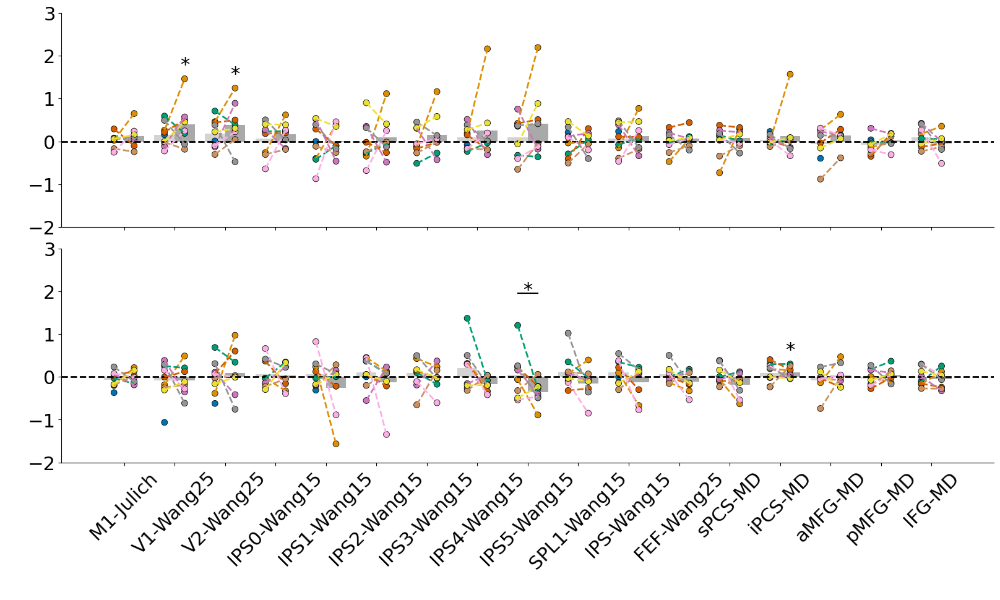

In [32]:
sig_df = ttest_crossnobis(df,'data_LR')
print(sig_df)
sig_df.to_csv('Fig_allROI_LR.csv')

results_df,sig_df1 = ttest_paired_sessions(df, 'data_LR', 'Session 1', 'Session 2')
print(sig_df1)
sig_df1.to_csv('Fig_allROI_LR_compSess.csv')

plot_group_dsm_star(df,'Fig_allROI_LR.png',roi_labels,subj_labels,
               selected_epoch_labels,'data_LR',session_palette,sig_df,sig_df1,4,-2,3)

/tmp/ipykernel_2187/1564962005.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  significant_results_df['epoch'] = pd.Categorical(significant_results_df['epoch'], categories=epoch_order, ordered=True)
/tmp/ipykernel_2187/745491356.py:27: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  t_stat, p_value = ttest_rel(data_session1[:min_length], data_session2[:min_length])


      session     epoch          roi    t_stat   p_value
18  Session 1  stimulus    V1-Wang25  4.715745  0.000755
19  Session 1  stimulus    V2-Wang25  3.441379  0.004403
20  Session 1  stimulus  IPS0-Wang15  2.392237  0.021851
21  Session 1  stimulus  IPS1-Wang15  2.407554  0.021335
27  Session 1  stimulus   IPS-Wang15  2.229523  0.028169
11  Session 1     delay   FEF-Wang25  1.977946  0.041657
12  Session 1     delay      sPCS-MD  2.259087  0.026899
52  Session 2  stimulus    V1-Wang25  3.344338  0.006173
53  Session 2  stimulus    V2-Wang25  4.555114  0.001310
43  Session 2     delay  SPL1-Wang15  2.825468  0.012786
Empty DataFrame
Columns: [epoch, roi, session1, session2, t_stat, p_value]
Index: []


<Figure size 800x1600 with 0 Axes>

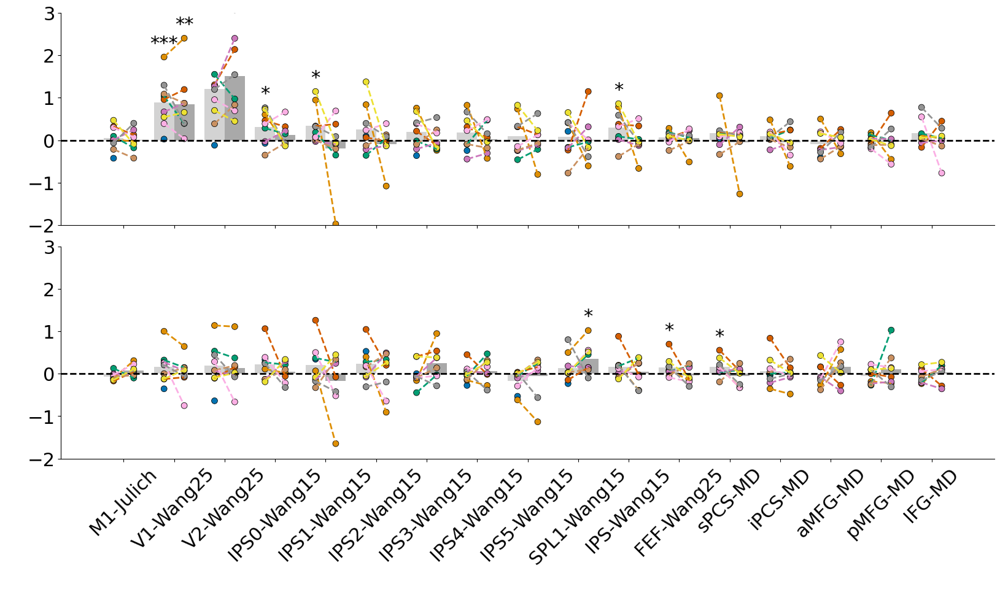

In [33]:
sig_df = ttest_crossnobis(df,'data_WT')
print(sig_df)

results_df,sig_df1 = ttest_paired_sessions(df, 'data_WT', 'Session 1', 'Session 2')
print(sig_df1)
sig_df1.to_csv('Fig_allROI_WT_compSess.csv')

sig_df.to_csv('Fig_allROI_WT.csv')
plot_group_dsm_star(df,'Fig_allROI_WT.png',roi_labels,subj_labels,
               selected_epoch_labels,'data_WT',session_palette,sig_df,sig_df1,4,-2,3)

/tmp/ipykernel_2187/1564962005.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  significant_results_df['epoch'] = pd.Categorical(significant_results_df['epoch'], categories=epoch_order, ordered=True)
/tmp/ipykernel_2187/745491356.py:27: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  t_stat, p_value = ttest_rel(data_session1[:min_length], data_session2[:min_length])


      session     epoch          roi    t_stat   p_value
18  Session 1  stimulus    V1-Wang25  4.847887  0.002341
19  Session 1  stimulus    V2-Wang25  8.879002  0.000151
20  Session 1  stimulus  IPS0-Wang15  2.138191  0.042756
52  Session 2  stimulus    V1-Wang25  5.118472  0.003447
53  Session 2  stimulus    V2-Wang25  6.816860  0.001210
37  Session 2     delay  IPS0-Wang15  7.324571  0.000924
38  Session 2     delay  IPS1-Wang15  2.254356  0.043612
39  Session 2     delay  IPS2-Wang15  2.744807  0.025825
41  Session 2     delay  IPS4-Wang15  2.203699  0.046136
42  Session 2     delay  IPS5-Wang15  2.201234  0.046263
43  Session 2     delay  SPL1-Wang15  2.964532  0.020684
44  Session 2     delay   IPS-Wang15  4.064842  0.007644
47  Session 2     delay      iPCS-MD  5.667136  0.002391
Empty DataFrame
Columns: [epoch, roi, session1, session2, t_stat, p_value]
Index: []


<Figure size 800x1600 with 0 Axes>

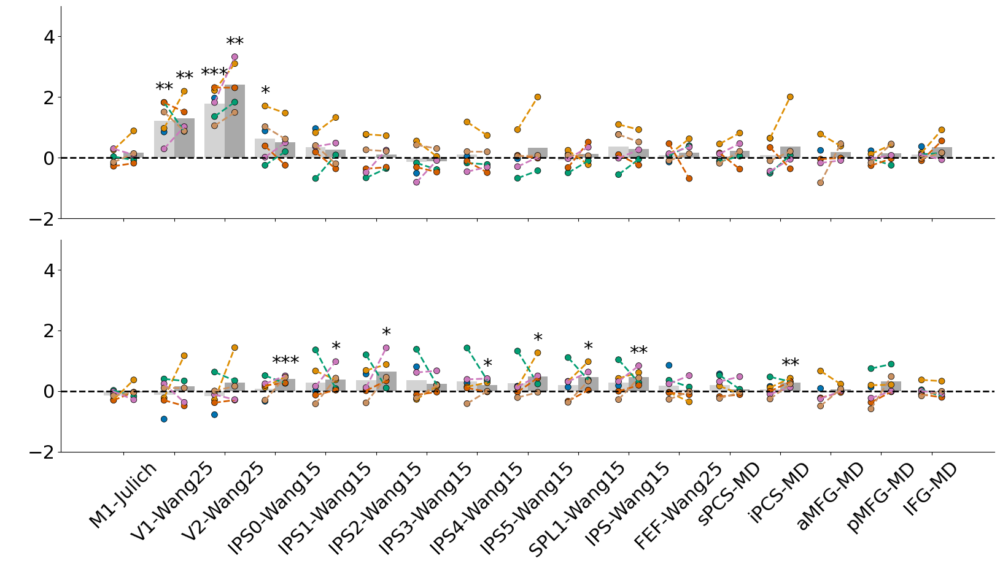

In [34]:
sig_df = ttest_crossnobis(df,'data_ecc')
print(sig_df)
results_df,sig_df1 = ttest_paired_sessions(df, 'data_ecc', 'Session 1', 'Session 2')
print(sig_df1)
sig_df1.to_csv('Fig_allROI_ecc_compSess.csv')

sig_df.to_csv('Fig_allROI_ecc.csv')
plot_group_dsm_star(df,'Fig_allROI_ecc.png',roi_labels,subj_labels,
               selected_epoch_labels,'data_ecc',session_palette,sig_df,sig_df1,4,-2,5)

/tmp/ipykernel_2187/1564962005.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  significant_results_df['epoch'] = pd.Categorical(significant_results_df['epoch'], categories=epoch_order, ordered=True)
/tmp/ipykernel_2187/745491356.py:27: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  t_stat, p_value = ttest_rel(data_session1[:min_length], data_session2[:min_length])
/tmp/ipykernel_2187/745491356.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

      session     epoch          roi    t_stat   p_value
26  Session 1  stimulus  SPL1-Wang15  4.123353  0.027044
11  Session 1     delay   FEF-Wang25  3.204928  0.042556
12  Session 1     delay      sPCS-MD  4.475994  0.023231
51  Session 2  stimulus    M1-Julich  4.351935  0.024478
       epoch          roi   session1   session2    t_stat  p_value
26  stimulus  SPL1-Wang15  Session 1  Session 2  5.936689  0.02722


<Figure size 800x1600 with 0 Axes>

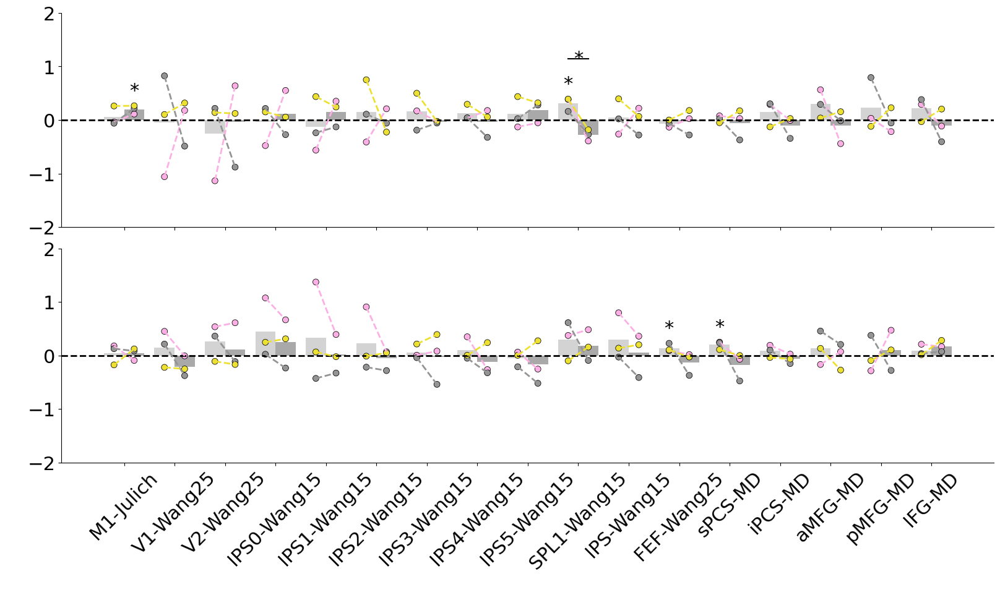

In [35]:
sig_df = ttest_crossnobis(df,'data_CN')
print(sig_df)

results_df,sig_df1 = ttest_paired_sessions(df, 'data_CN', 'Session 1', 'Session 2')
print(sig_df1)
sig_df1.to_csv('Fig_allROI_CN_compSess.csv')

sig_df.to_csv('Fig_allROI_CN.csv')
plot_group_dsm_star(df,'Fig_allROI_CN.png',roi_labels,subj_labels,
               selected_epoch_labels,'data_CN',session_palette,sig_df,sig_df1,4,-2,2)

/tmp/ipykernel_2187/1564962005.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  significant_results_df['epoch'] = pd.Categorical(significant_results_df['epoch'], categories=epoch_order, ordered=True)
/tmp/ipykernel_2187/745491356.py:27: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  t_stat, p_value = ttest_rel(data_session1[:min_length], data_session2[:min_length])
/tmp/ipykernel_2187/745491356.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

      session     epoch          roi    t_stat   p_value
18  Session 1  stimulus    V1-Wang25  2.793605  0.011714
19  Session 1  stimulus    V2-Wang25  3.594358  0.003520
20  Session 1  stimulus  IPS0-Wang15  2.875508  0.010327
27  Session 1  stimulus   IPS-Wang15  2.213211  0.028895
29  Session 1  stimulus      sPCS-MD  2.011408  0.039553
3   Session 1     delay  IPS0-Wang15  2.684573  0.013864
4   Session 1     delay  IPS1-Wang15  2.791208  0.011757
5   Session 1     delay  IPS2-Wang15  2.936887  0.009399
6   Session 1     delay  IPS3-Wang15  2.021573  0.038934
7   Session 1     delay  IPS4-Wang15  1.942619  0.043995
9   Session 1     delay  SPL1-Wang15  1.887669  0.047884
10  Session 1     delay   IPS-Wang15  2.582505  0.016245
11  Session 1     delay   FEF-Wang25  2.485471  0.018894
12  Session 1     delay      sPCS-MD  2.442883  0.020191
52  Session 2  stimulus    V1-Wang25  2.541741  0.019283
53  Session 2  stimulus    V2-Wang25  4.073388  0.002364
54  Session 2  stimulus  IPS0-W

<Figure size 800x1600 with 0 Axes>

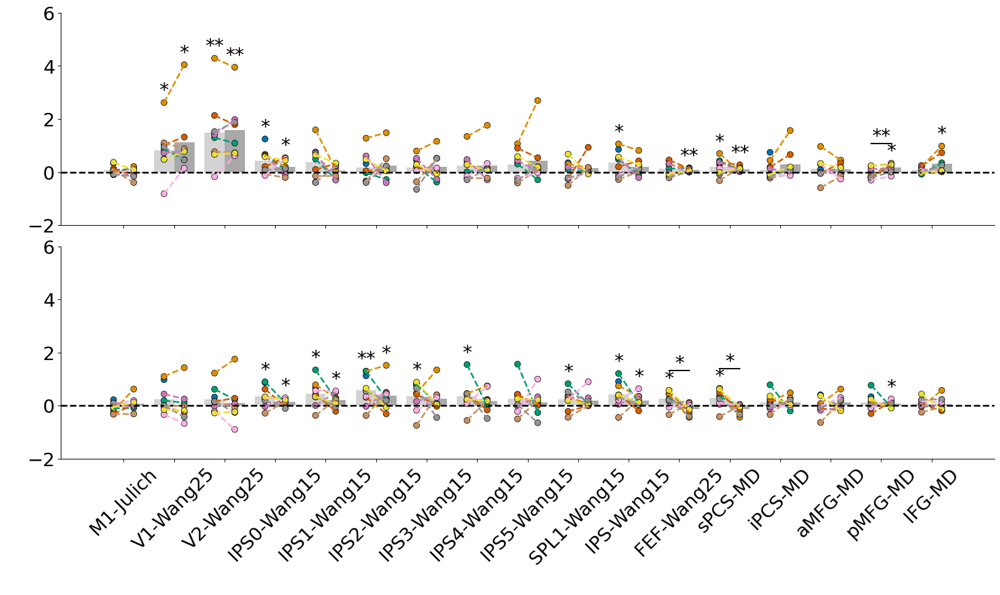

In [36]:
sig_df = ttest_crossnobis(df,'data_LRWT')
print(sig_df)

results_df,sig_df1 = ttest_paired_sessions(df, 'data_LRWT', 'Session 1', 'Session 2')
print(sig_df1)
sig_df1.to_csv('Fig_allROI_LRWT_compSess.csv')

sig_df.to_csv('Fig_allROI_LRWT.csv')
plot_group_dsm_star(df,'Fig_allROI_LRWT.png',roi_labels,subj_labels,
               selected_epoch_labels,'data_LRWT',session_palette,sig_df,sig_df1,4,-2,6)

/tmp/ipykernel_2187/1564962005.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  significant_results_df['epoch'] = pd.Categorical(significant_results_df['epoch'], categories=epoch_order, ordered=True)
/tmp/ipykernel_2187/745491356.py:27: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  t_stat, p_value = ttest_rel(data_session1[:min_length], data_session2[:min_length])


      session     epoch          roi    t_stat   p_value
18  Session 1  stimulus    V1-Wang25  5.439361  0.001425
19  Session 1  stimulus    V2-Wang25  4.457822  0.003327
20  Session 1  stimulus  IPS0-Wang15  2.260362  0.036659
21  Session 1  stimulus  IPS1-Wang15  2.381857  0.031510
1   Session 1     delay    V1-Wang25  2.121292  0.043681
3   Session 1     delay  IPS0-Wang15  2.492000  0.027513
4   Session 1     delay  IPS1-Wang15  2.174810  0.040823
5   Session 1     delay  IPS2-Wang15  2.713165  0.021058
6   Session 1     delay  IPS3-Wang15  3.147942  0.012719
7   Session 1     delay  IPS4-Wang15  2.305661  0.034641
8   Session 1     delay  IPS5-Wang15  2.390018  0.031193
10  Session 1     delay   IPS-Wang15  3.141131  0.012817
11  Session 1     delay   FEF-Wang25  2.475867  0.028062
12  Session 1     delay      sPCS-MD  2.692350  0.021589
52  Session 2  stimulus    V1-Wang25  4.036008  0.007828
53  Session 2  stimulus    V2-Wang25  4.928853  0.003940
62  Session 2  stimulus   FEF-W

<Figure size 800x1600 with 0 Axes>

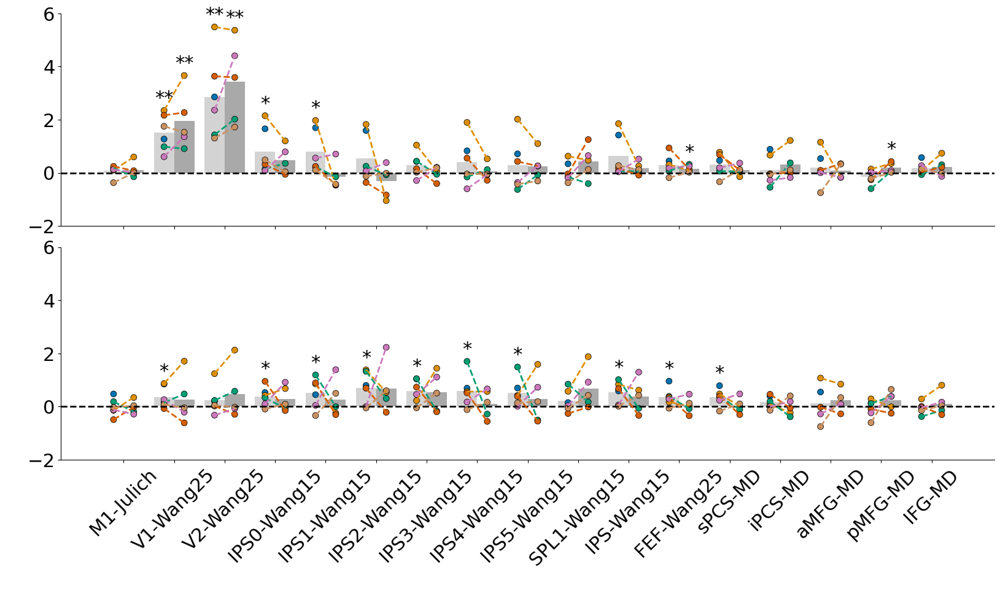

In [37]:
sig_df = ttest_crossnobis(df,'data_eccWT')
print(sig_df)

results_df,sig_df1 = ttest_paired_sessions(df, 'data_eccWT', 'Session 1', 'Session 2')
print(sig_df1)
sig_df1.to_csv('Fig_allROI_eccWT_compSess.csv')

sig_df.to_csv('Fig_allROI_eccWT.csv')
plot_group_dsm_star(df,'Fig_allROI_eccWT.png',roi_labels,subj_labels,
               selected_epoch_labels,'data_eccWT',session_palette,sig_df,sig_df1,4,-2,6)

/tmp/ipykernel_2187/1564962005.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  significant_results_df['epoch'] = pd.Categorical(significant_results_df['epoch'], categories=epoch_order, ordered=True)
/tmp/ipykernel_2187/745491356.py:27: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  t_stat, p_value = ttest_rel(data_session1[:min_length], data_session2[:min_length])
/tmp/ipykernel_2187/745491356.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

      session     epoch          roi    t_stat   p_value
18  Session 1  stimulus    V1-Wang25  4.595127  0.002933
19  Session 1  stimulus    V2-Wang25  5.282992  0.001618
20  Session 1  stimulus  IPS0-Wang15  2.975154  0.015486
24  Session 1  stimulus  IPS4-Wang15  2.027995  0.049181
27  Session 1  stimulus   IPS-Wang15  2.879265  0.017309
3   Session 1     delay  IPS0-Wang15  2.697628  0.021453
52  Session 2  stimulus    V1-Wang25  3.513235  0.012300
53  Session 2  stimulus    V2-Wang25  5.617968  0.002467
54  Session 2  stimulus  IPS0-Wang15  2.230940  0.044759
60  Session 2  stimulus  SPL1-Wang15  2.581532  0.030614
61  Session 2  stimulus   IPS-Wang15  2.256711  0.043498
       epoch         roi   session1   session2    t_stat   p_value
28  stimulus  FEF-Wang25  Session 1  Session 2  3.681056  0.021184


<Figure size 800x1600 with 0 Axes>

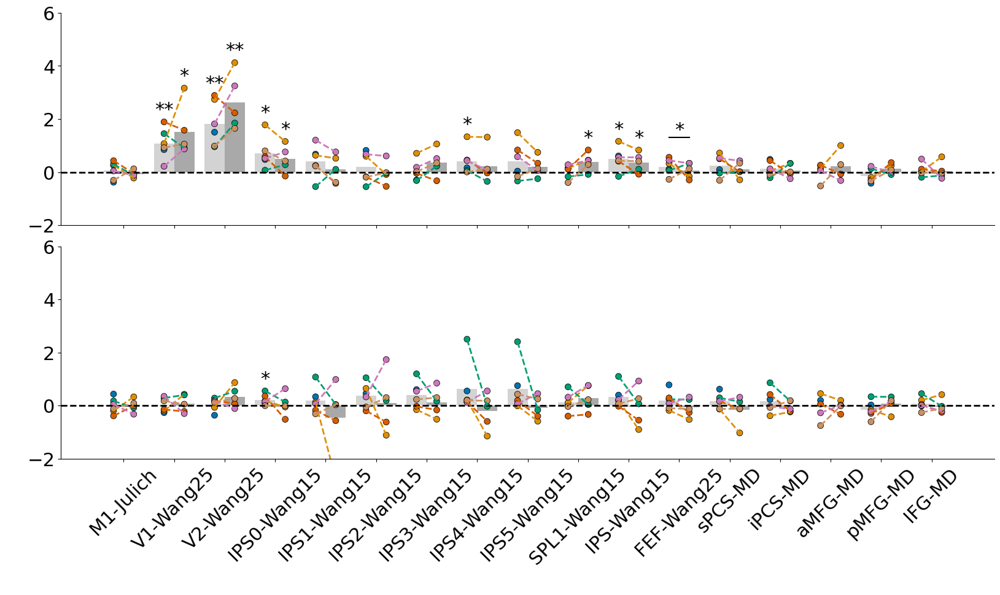

In [38]:
sig_df = ttest_crossnobis(df,'data_eccLR')
print(sig_df)

results_df,sig_df1 = ttest_paired_sessions(df, 'data_eccLR', 'Session 1', 'Session 2')
print(sig_df1)
sig_df1.to_csv('Fig_allROI_eccLR_compSess.csv')

sig_df.to_csv('Fig_allROI_eccLR.csv')
plot_group_dsm_star(df,'Fig_allROI_eccLR.png',roi_labels,subj_labels,
               selected_epoch_labels,'data_eccLR',session_palette,sig_df,sig_df1,4,-2,6)

/tmp/ipykernel_2187/1564962005.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  significant_results_df['epoch'] = pd.Categorical(significant_results_df['epoch'], categories=epoch_order, ordered=True)
/tmp/ipykernel_2187/745491356.py:27: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  t_stat, p_value = ttest_rel(data_session1[:min_length], data_session2[:min_length])
/tmp/ipykernel_2187/745491356.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

      session     epoch          roi    t_stat   p_value
18  Session 1  stimulus    V1-Wang25  4.935365  0.002170
19  Session 1  stimulus    V2-Wang25  4.886741  0.002263
20  Session 1  stimulus  IPS0-Wang15  2.986654  0.015282
21  Session 1  stimulus  IPS1-Wang15  3.360848  0.010045
22  Session 1  stimulus  IPS2-Wang15  2.155536  0.041829
23  Session 1  stimulus  IPS3-Wang15  2.915213  0.016599
24  Session 1  stimulus  IPS4-Wang15  2.736994  0.020469
26  Session 1  stimulus  SPL1-Wang15  3.366430  0.009984
27  Session 1  stimulus   IPS-Wang15  4.262249  0.003999
3   Session 1     delay  IPS0-Wang15  2.977412  0.015446
4   Session 1     delay  IPS1-Wang15  2.166383  0.041260
5   Session 1     delay  IPS2-Wang15  2.274742  0.036005
6   Session 1     delay  IPS3-Wang15  2.263867  0.036499
10  Session 1     delay   IPS-Wang15  2.512142  0.026844
11  Session 1     delay   FEF-Wang25  2.308877  0.034502
12  Session 1     delay      sPCS-MD  2.439602  0.029341
52  Session 2  stimulus    V1-W

<Figure size 800x1600 with 0 Axes>

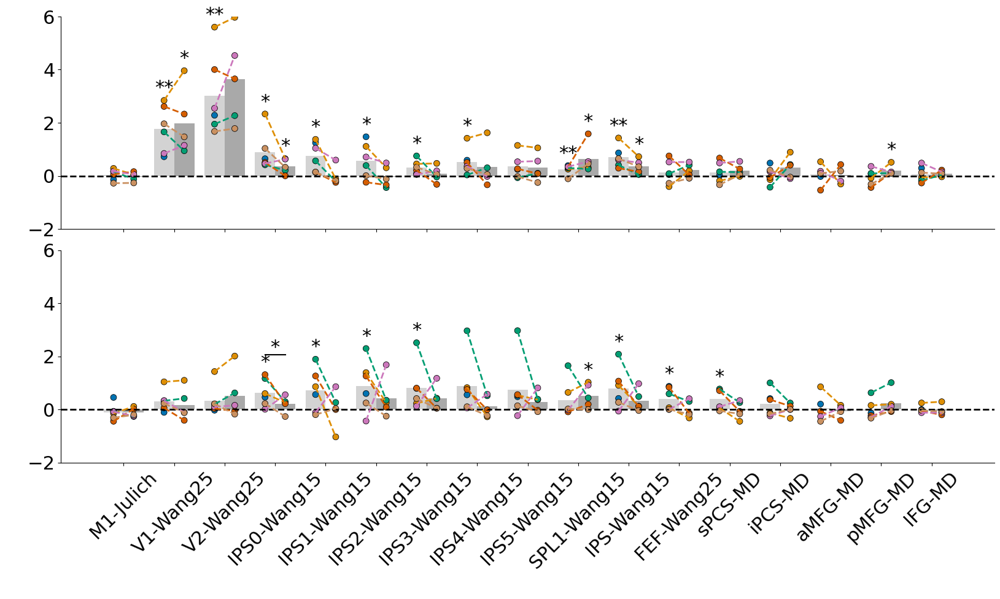

In [39]:
sig_df = ttest_crossnobis(df,'data_eccLRWT')
print(sig_df)
sig_df.to_csv('Fig_allROI_eccLRWT.csv')

results_df,sig_df1 = ttest_paired_sessions(df, 'data_eccLRWT', 'Session 1', 'Session 2')
print(sig_df1)
sig_df1.to_csv('Fig_allROI_eccLRWT_compSess.csv')

plot_group_dsm_star(df,'Fig_allROI_eccLRWT.png',roi_labels,subj_labels,
               selected_epoch_labels,'data_eccLRWT',session_palette,sig_df,sig_df1,4,-2,6)

/tmp/ipykernel_2187/1564962005.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  significant_results_df['epoch'] = pd.Categorical(significant_results_df['epoch'], categories=epoch_order, ordered=True)
/tmp/ipykernel_2187/745491356.py:27: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  t_stat, p_value = ttest_rel(data_session1[:min_length], data_session2[:min_length])


      session     epoch          roi    t_stat   p_value
19  Session 1  stimulus    V2-Wang25  8.567613  0.006676
26  Session 1  stimulus  SPL1-Wang15  3.505046  0.036320
Empty DataFrame
Columns: [epoch, roi, session1, session2, t_stat, p_value]
Index: []


<Figure size 800x1600 with 0 Axes>

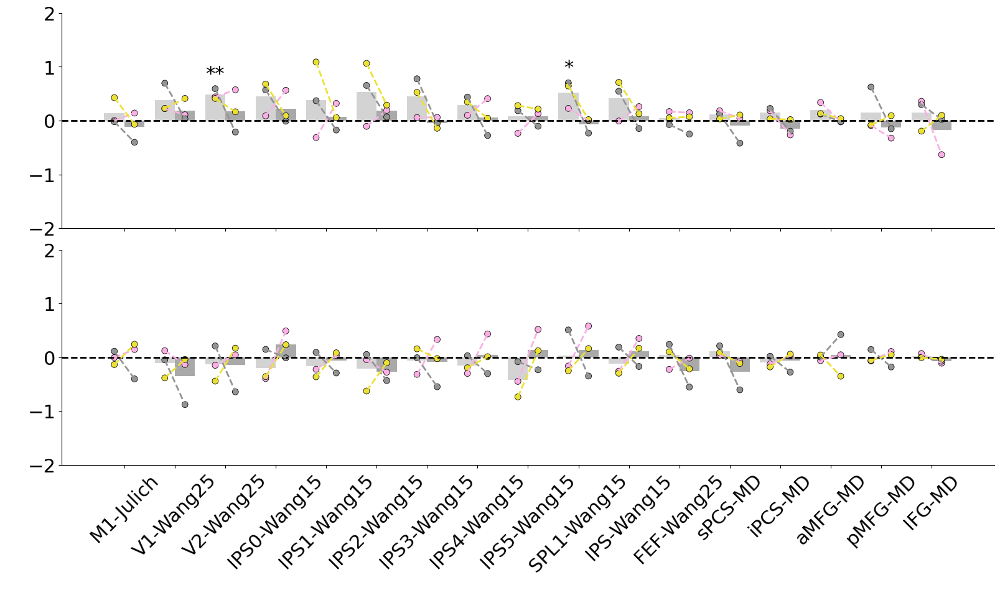

In [40]:
sig_df = ttest_crossnobis(df,'data_CNLR')
print(sig_df)
sig_df.to_csv('Fig_allROI_CNLR.csv')

results_df,sig_df1 = ttest_paired_sessions(df, 'data_CNLR', 'Session 1', 'Session 2')
print(sig_df1)
sig_df1.to_csv('Fig_allROI_CNLR_compSess.csv')

plot_group_dsm_star(df,'Fig_allROI_CNLR.png',roi_labels,subj_labels,
               selected_epoch_labels,'data_CNLR',session_palette,sig_df,sig_df1,4,-2,2)

/tmp/ipykernel_2187/1564962005.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  significant_results_df['epoch'] = pd.Categorical(significant_results_df['epoch'], categories=epoch_order, ordered=True)
/tmp/ipykernel_2187/745491356.py:27: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  t_stat, p_value = ttest_rel(data_session1[:min_length], data_session2[:min_length])
/tmp/ipykernel_2187/745491356.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

      session     epoch          roi    t_stat   p_value
12  Session 1     delay      sPCS-MD  3.126321  0.044442
13  Session 1     delay      iPCS-MD  4.111339  0.027190
53  Session 2  stimulus    V2-Wang25  3.359820  0.039160
55  Session 2  stimulus  IPS1-Wang15  4.149376  0.026733
56  Session 2  stimulus  IPS2-Wang15  3.163813  0.043528
57  Session 2  stimulus  IPS3-Wang15  3.256186  0.041387
    epoch      roi   session1   session2    t_stat   p_value
13  delay  iPCS-MD  Session 1  Session 2  7.649754  0.016663


<Figure size 800x1600 with 0 Axes>

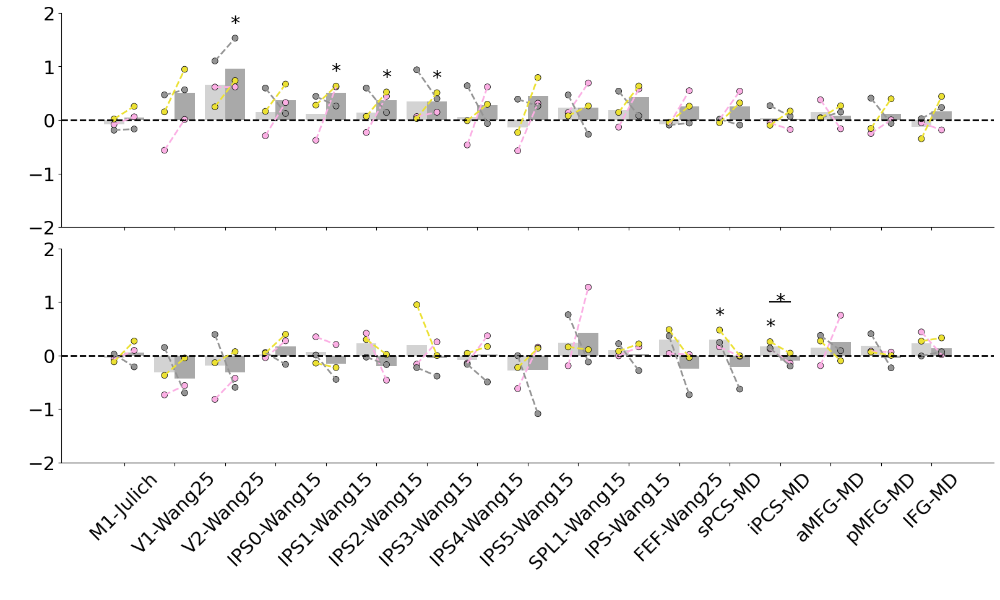

In [41]:
sig_df = ttest_crossnobis(df,'data_CNWT')
print(sig_df)

results_df,sig_df1 = ttest_paired_sessions(df, 'data_CNWT', 'Session 1', 'Session 2')
print(sig_df1)
sig_df1.to_csv('Fig_allROI_CNWT_compSess.csv')

sig_df.to_csv('Fig_allROI_CNWT.csv')
plot_group_dsm_star(df,'Fig_allROI_CNWT.png',roi_labels,subj_labels,
               selected_epoch_labels,'data_CNWT',session_palette,sig_df,sig_df1,4,-2,2)

/tmp/ipykernel_2187/1564962005.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  significant_results_df['epoch'] = pd.Categorical(significant_results_df['epoch'], categories=epoch_order, ordered=True)
/tmp/ipykernel_2187/745491356.py:27: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  t_stat, p_value = ttest_rel(data_session1[:min_length], data_session2[:min_length])
/tmp/ipykernel_2187/745491356.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

      session     epoch          roi     t_stat   p_value
23  Session 1  stimulus  IPS3-Wang15   3.056318  0.046224
5   Session 1     delay  IPS2-Wang15   3.601692  0.034592
6   Session 1     delay  IPS3-Wang15   3.268762  0.041107
12  Session 1     delay      sPCS-MD   5.226172  0.017359
14  Session 1     delay      pMFG-MD  38.018004  0.000346
52  Session 2  stimulus    V1-Wang25  32.579783  0.000470
37  Session 2     delay  IPS0-Wang15   3.898152  0.029976
38  Session 2     delay  IPS1-Wang15   4.816758  0.020250
       epoch          roi   session1   session2     t_stat   p_value
20  stimulus  IPS0-Wang15  Session 1  Session 2   4.646237  0.043334
5      delay  IPS2-Wang15  Session 1  Session 2   4.850613  0.039971
11     delay   FEF-Wang25  Session 1  Session 2   5.335658  0.033377
12     delay      sPCS-MD  Session 1  Session 2  12.548890  0.006290


<Figure size 800x1600 with 0 Axes>

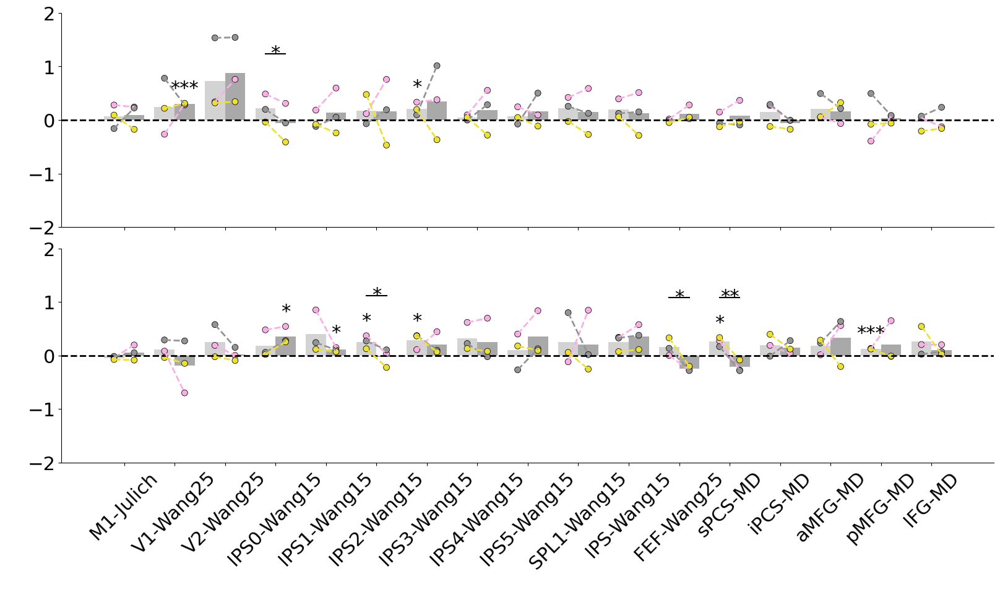

In [42]:
sig_df = ttest_crossnobis(df,'data_CNLRWT')
print(sig_df)

results_df,sig_df1 = ttest_paired_sessions(df, 'data_CNLRWT', 'Session 1', 'Session 2')
print(sig_df1)
sig_df1.to_csv('Fig_allROI_CNLRWT_compSess.csv')

sig_df.to_csv('Fig_allROI_CNLRWT.csv')
plot_group_dsm_star(df,'Fig_allROI_CNLRWT.png',roi_labels,subj_labels,
               selected_epoch_labels,'data_CNLRWT',session_palette,sig_df,sig_df1,4,-2,2)

<Figure size 800x1200 with 0 Axes>

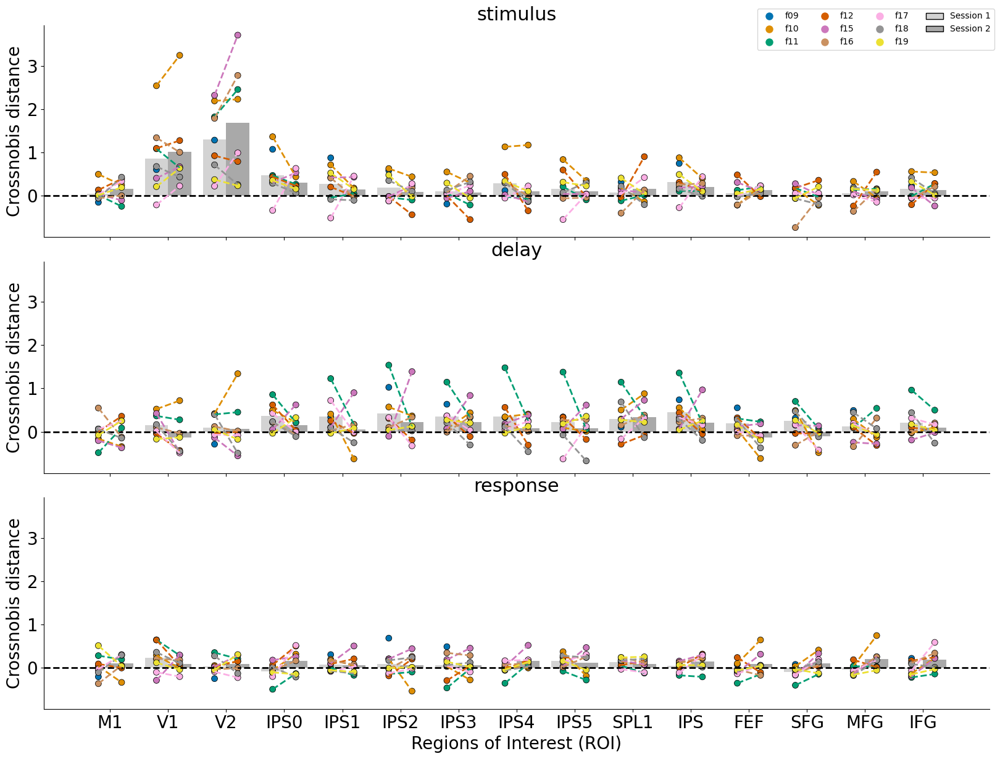

In [120]:
plot_group_dsm(dis_val_all,'crossnobis_residual_split_by_sess_all.png',roi_labels,subj_labels,
               epoch_labels,'data',session_palette)

<Figure size 800x1200 with 0 Axes>

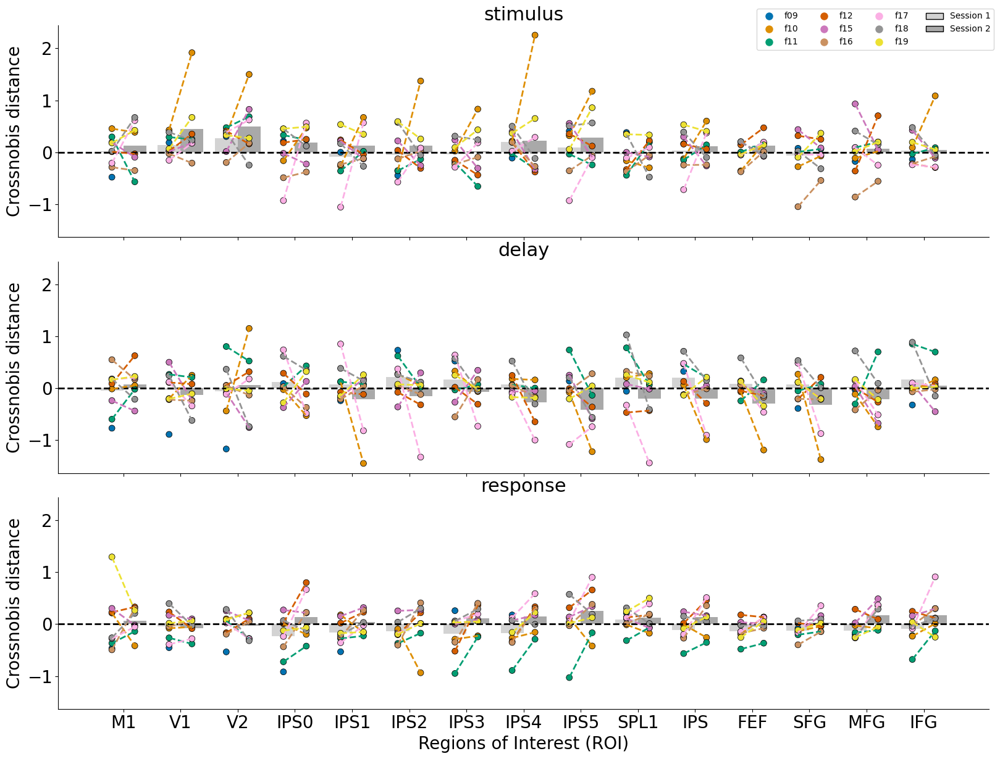

In [121]:
plot_group_dsm(dis_val_all,'crossnobis_residual_split_by_sess_LR.png',roi_labels,subj_labels,
               epoch_labels,'data_LR',session_palette)

<Figure size 800x1200 with 0 Axes>

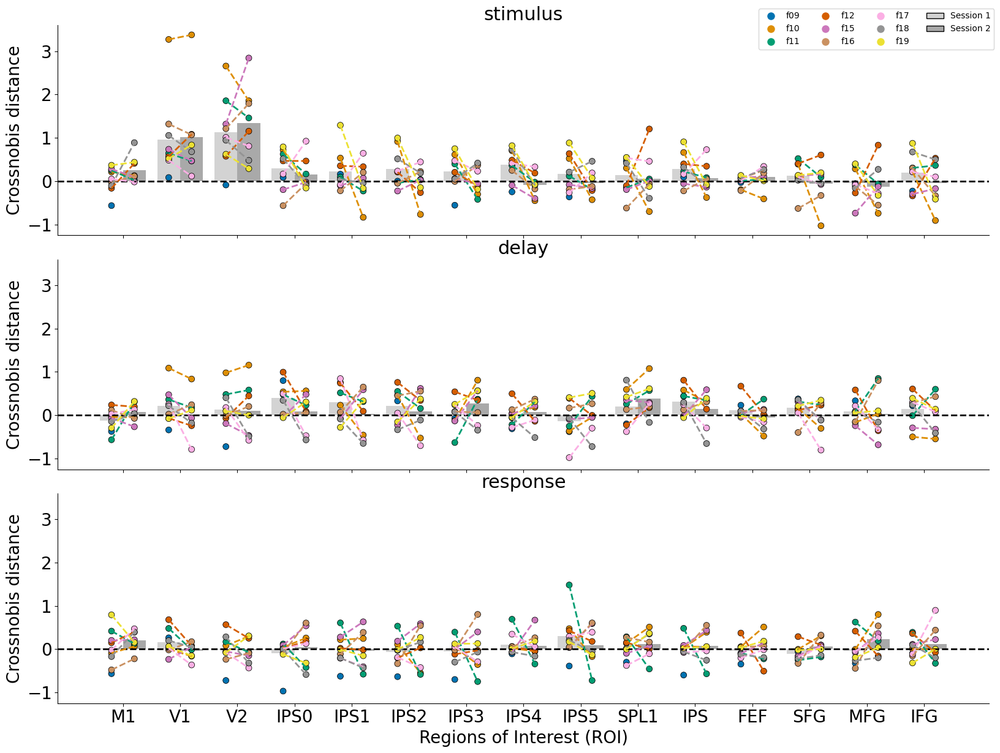

In [122]:
plot_group_dsm(dis_val_all,'crossnobis_residual_split_by_sess_WT.png',roi_labels,subj_labels,
               epoch_labels,'data_WT',session_palette)

<Figure size 800x1200 with 0 Axes>

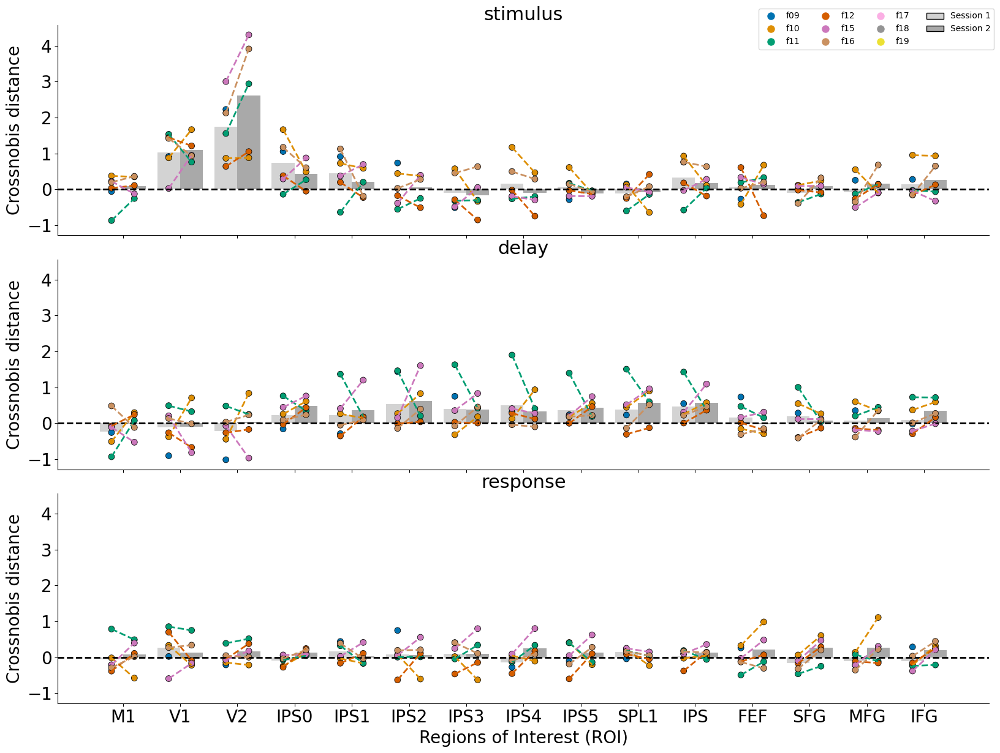

In [123]:
plot_group_dsm(dis_val_all,'crossnobis_residual_split_by_sess_ecc.png',roi_labels,subj_labels,
               epoch_labels,'data_ecc',session_palette)

<Figure size 800x1200 with 0 Axes>

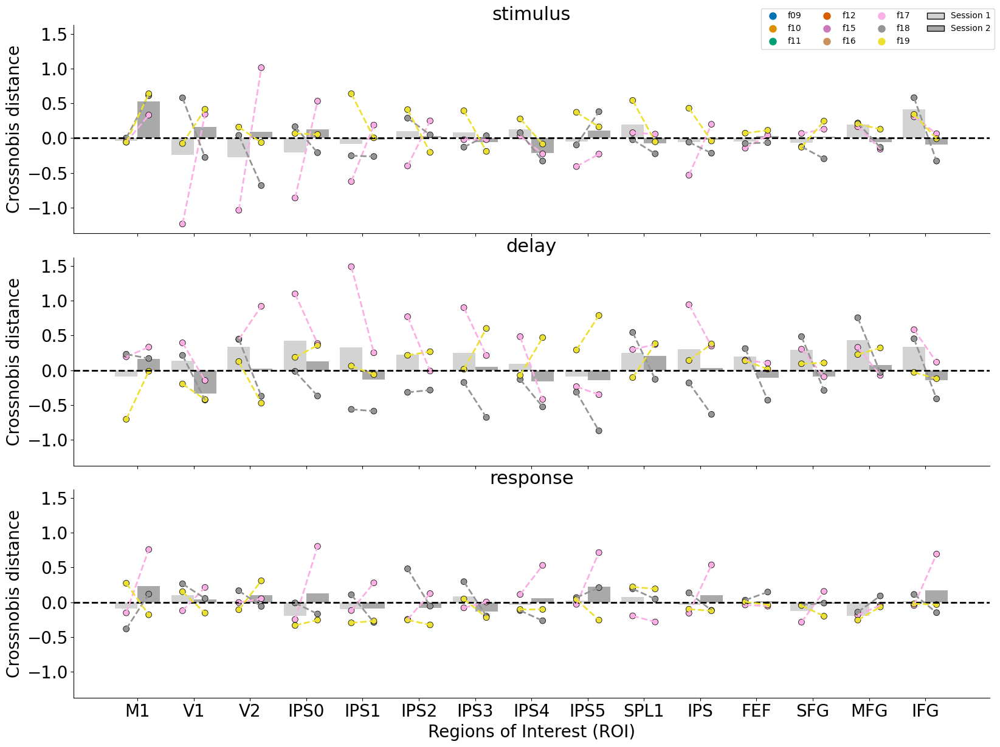

In [124]:
plot_group_dsm(dis_val_all,'crossnobis_residual_split_by_sess_CN.png',roi_labels,subj_labels,
               epoch_labels,'data_CN',session_palette)

<Figure size 800x1200 with 0 Axes>

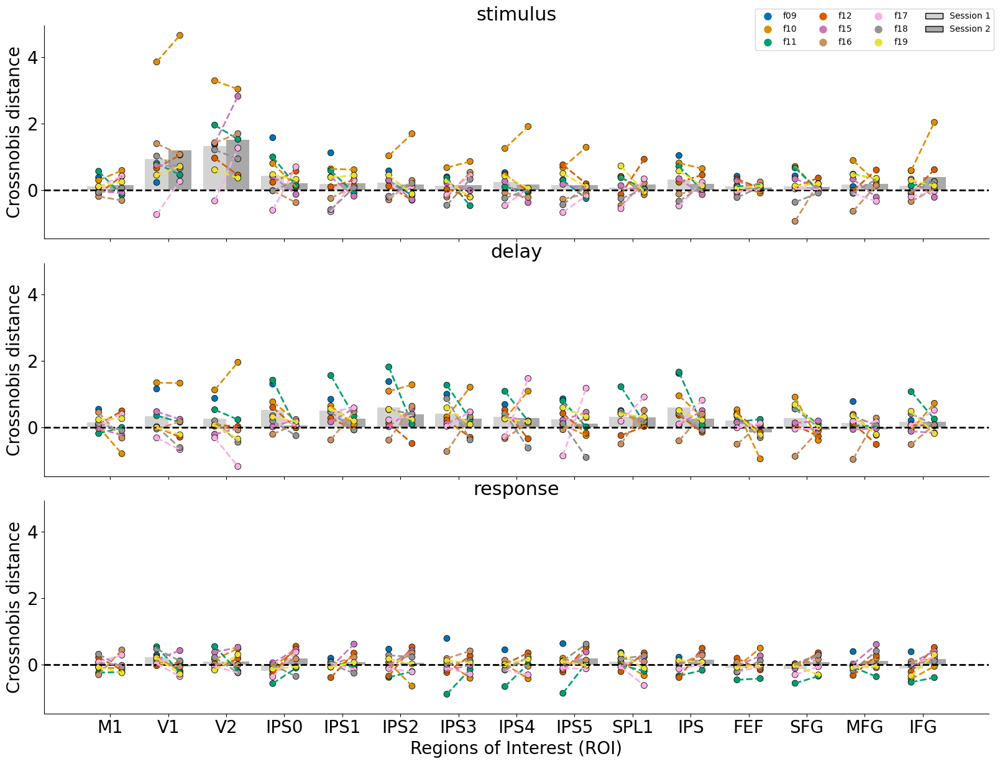

In [125]:
plot_group_dsm(dis_val_all,'crossnobis_residual_split_by_sess_LRWT.png',roi_labels,subj_labels,
               epoch_labels,'data_LRWT',session_palette)

<Figure size 800x1200 with 0 Axes>

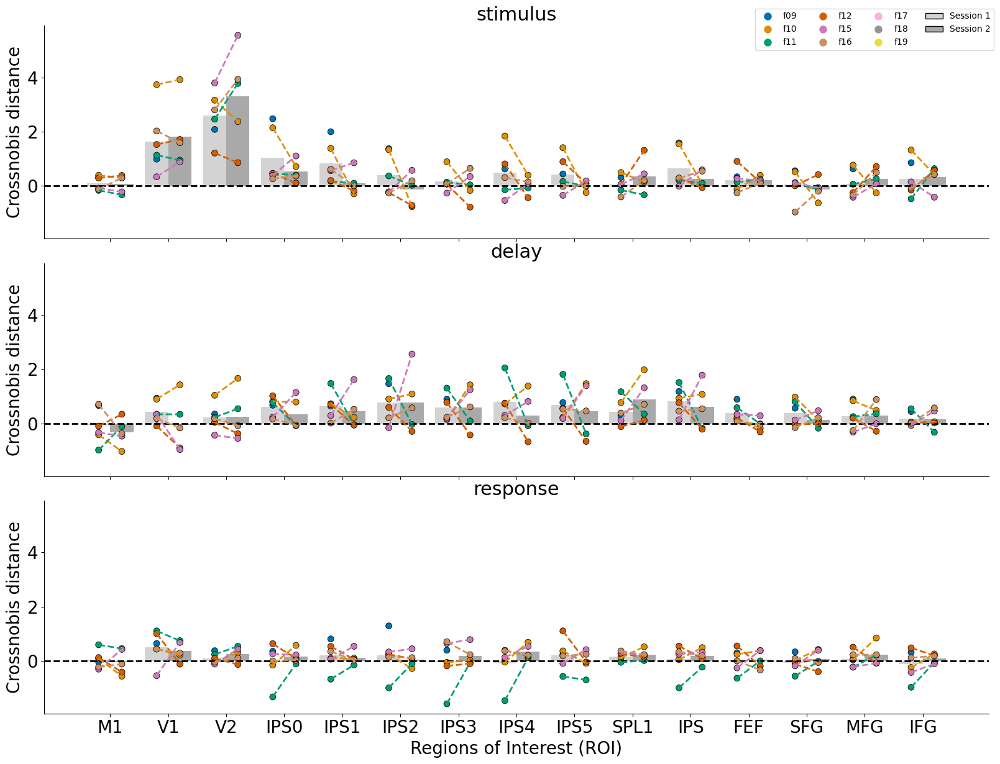

In [126]:
plot_group_dsm(dis_val_all,'crossnobis_residual_split_by_sess_eccWT.png',roi_labels,subj_labels,
               epoch_labels,'data_eccWT',session_palette)

<Figure size 800x1200 with 0 Axes>

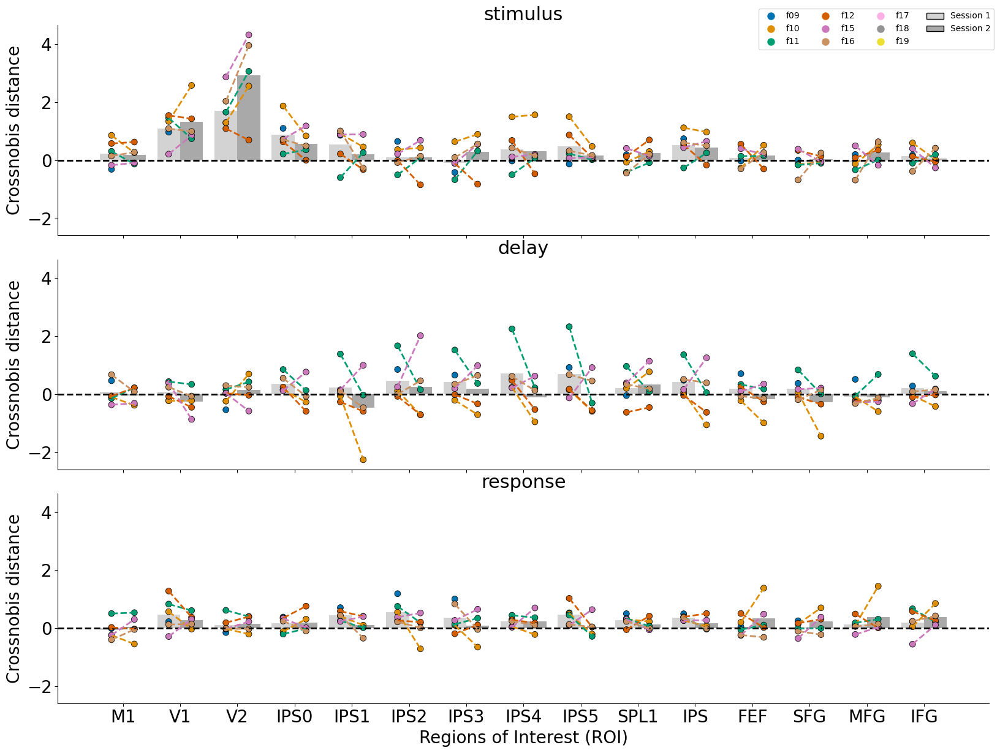

In [127]:
plot_group_dsm(dis_val_all,'crossnobis_residual_split_by_sess_eccLR.png',roi_labels,subj_labels,
               epoch_labels,'data_eccLR',session_palette)

<Figure size 800x1200 with 0 Axes>

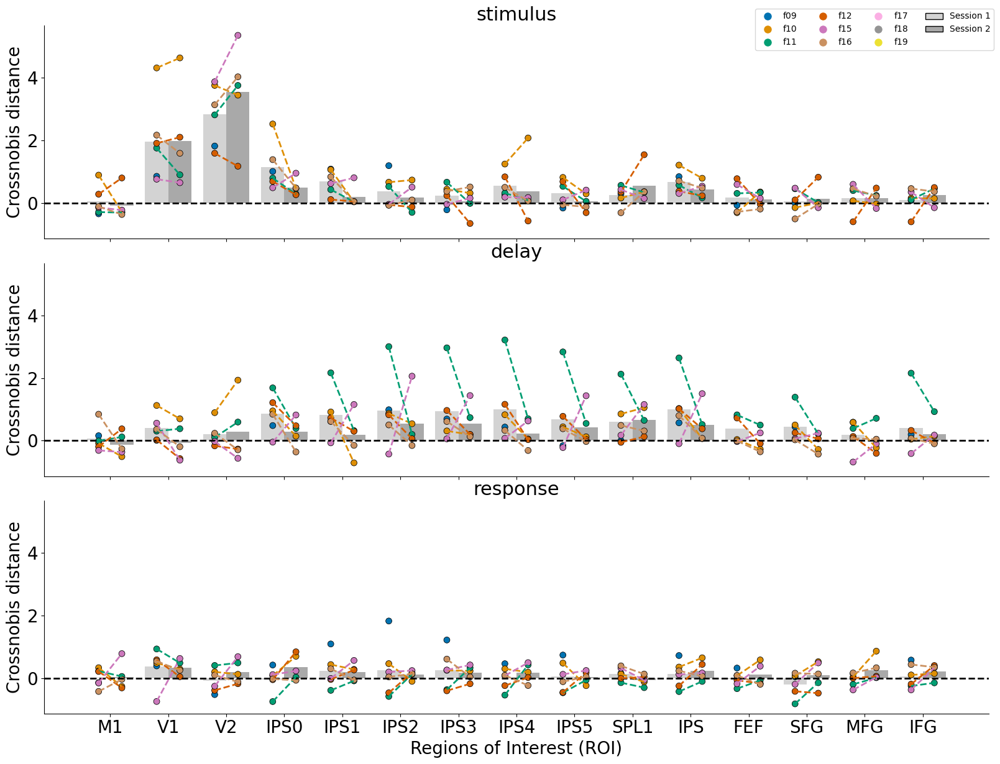

In [146]:
plot_group_dsm(dis_val_all,'crossnobis_residual_split_by_sess_eccLRWT.png',roi_labels,subj_labels,
               epoch_labels,'data_eccLRWT',session_palette)

<Figure size 800x1200 with 0 Axes>

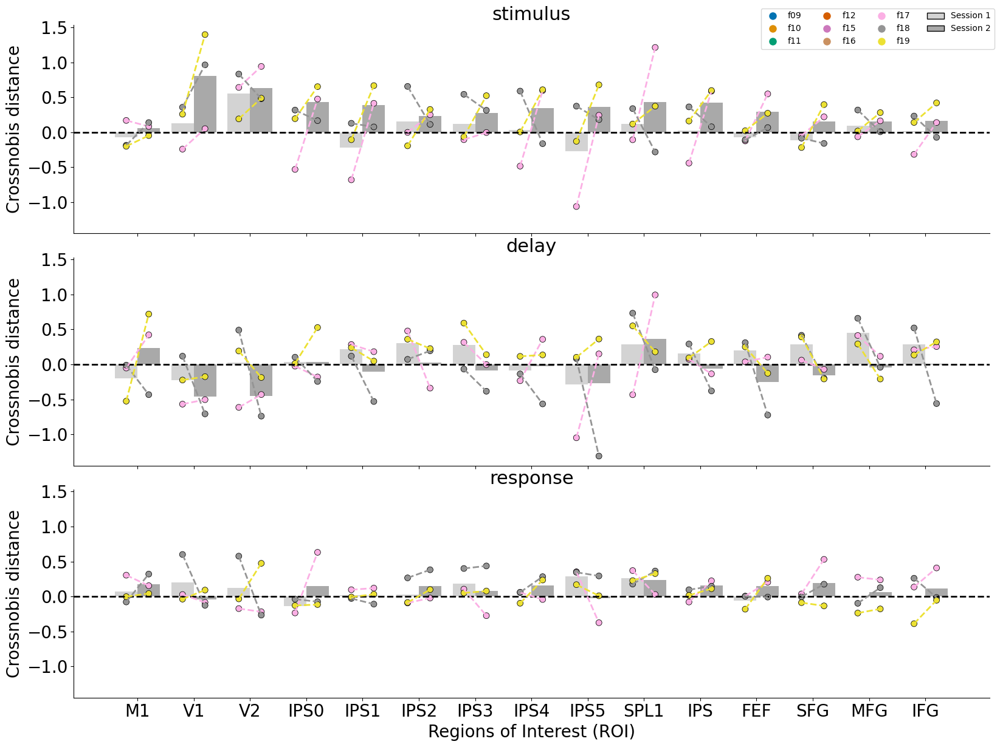

In [129]:
plot_group_dsm(dis_val_all,'crossnobis_residual_split_by_sess_CNWT.png',roi_labels,subj_labels,
               epoch_labels,'data_CNWT',session_palette)

<Figure size 800x1200 with 0 Axes>

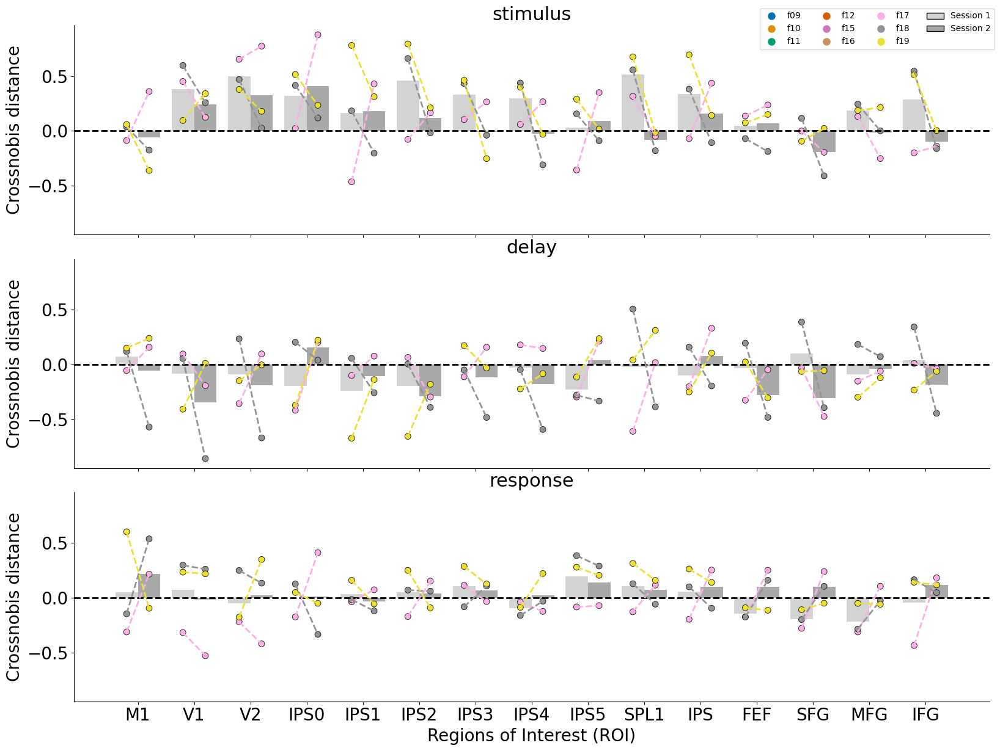

In [130]:
plot_group_dsm(dis_val_all,'crossnobis_residual_split_by_sess_CNLR.png',roi_labels,subj_labels,
               epoch_labels,'data_CNLR',session_palette)

<Figure size 800x1200 with 0 Axes>

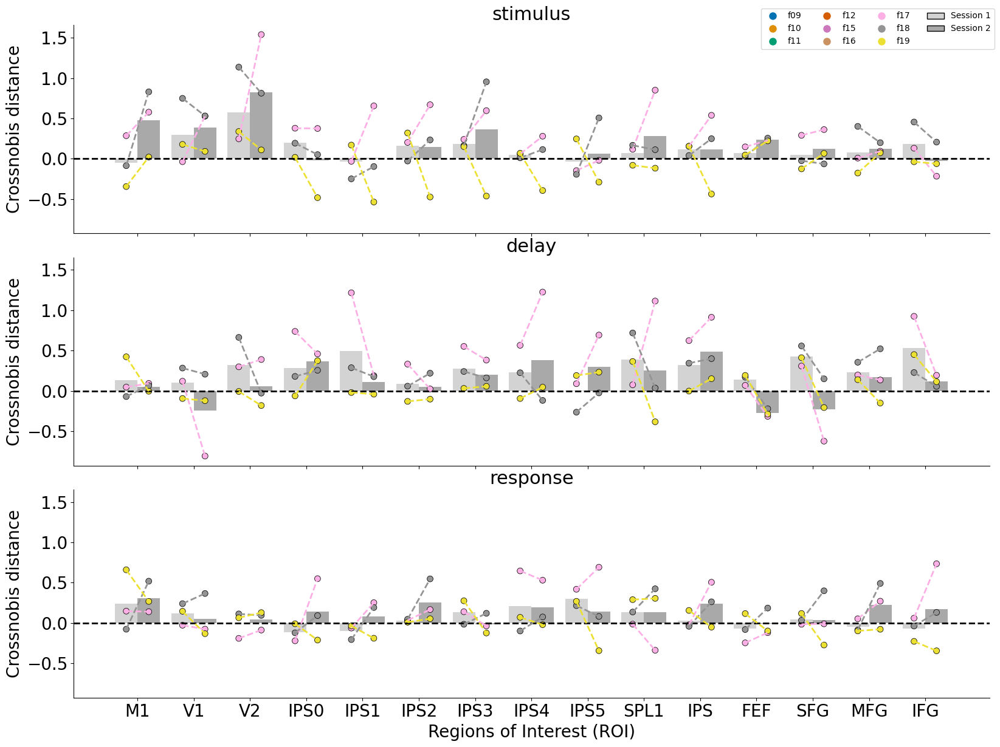

In [147]:
plot_group_dsm(dis_val_all,'crossnobis_residual_split_by_sess_CNLRWT.png',roi_labels,subj_labels,
               epoch_labels,'data_CNLRWT',session_palette)

# Make plots for the paper


In [32]:
print(roi_labels)
print(epoch_labels)

{'area4': 'M1', 'v1': 'V1', 'v2': 'V2', 'ips0': 'IPS0', 'ips1': 'IPS1', 'ips2': 'IPS2', 'ips3': 'IPS3', 'ips4': 'IPS4', 'ips5': 'IPS5', 'spl1': 'SPL1', 'ips': 'IPS', 'fef': 'FEF', 'sfg': 'SFG', 'mfg': 'MFG', 'ifg': 'IFG'}
{0: 'stimulus', 1: 'delay', 2: 'response'}


In [33]:
# # let's plot!
from matplotlib.patches import Patch
def plot_group_dsm1(dis_val_all,title,roi_labels,subj_labels,epoch_labels,data_column_name,session_palette):
    roi_order = list(roi_labels.values())

    # Define color-blind friendly palettes
    #session_palette = ['#D3D3D3', '#A9A9A9']  #sns.color_palette("colorblind", 2) 
    # A distinct color palette for participants
    participant_palette = sns.color_palette("colorblind", dis_val_all['subj'].unique().shape[0])

    # Offset for the scatter points to align with the bar centers
    session_offsets = {'Session 1': -0.2, 'Session 2': 0.2}

    # Function to plot scatter points and connecting lines
    def scatter_and_lines(data, **kwargs):
        ax = plt.gca()
        
        # Plot scatter points
        for session, offset in session_offsets.items():
            subset = data[data['session'] == session]
            x_coords = [roi_order.index(roi) + offset for roi in subset['roi']]
            if session == 'Session 1':
                sns.scatterplot(x=x_coords, y=subset[data_column_name], hue=subset['subj'], palette=participant_palette, 
                                style=subset['session'], edgecolor='black', s=25, ax=ax, alpha=1, **kwargs)
            else:
                sns.scatterplot(x=x_coords, y=subset[data_column_name], hue=subset['subj'], palette=participant_palette[1:], 
                                style=subset['session'], edgecolor='black', s=25, ax=ax, alpha=1, **kwargs)                
        # Plot connecting lines
        for _, group in data.groupby(['subj', 'roi']):
            participant_index = list(subj_labels.values()).index(group['subj'].iloc[0])  # Use integer index to access the palette
            x_coords = [roi_order.index(roi) + session_offsets[session] for roi, session in zip(group['roi'], group['session'])]
            ax.plot(x_coords, group[data_column_name], color=participant_palette[participant_index], linewidth=2, linestyle='--', alpha=1)

    # Plotting
    task_epoch_order = ["stimulus", "delay"] # "response"
    plt.figure(figsize=(8, 16))
    #g = sns.FacetGrid(dis_val_all, col="epoch", col_order=task_epoch_order, col_wrap=1, height=1.5, aspect=1.5)
    g = sns.FacetGrid(dis_val_all, col="epoch", col_order=task_epoch_order, col_wrap=1, height=2, aspect=1.2)
#     g.map_dataframe(sns.boxplot, x='roi', y=data_column_name, hue='session', 
#            order=roi_order,dodge=True, palette=session_palette) #ci='sd',errcolor='#A9A9A9', errwidth=1, capsize=0, 
    g.map_dataframe(sns.barplot, x='roi', y=data_column_name, hue='session',
                    order=roi_order,errorbar=None,dodge=True, palette=session_palette,zorder=1) #hue='session',
    
    # Adjusting the labels and titles
    g.set_axis_labels(" ", " ")
    g.set_titles(col_template="", row_template="")

    # # Setting an overall title
    # g.fig.suptitle("Comparison of ROI Values Across Sessions and Task Epochs", fontsize=16)

    # Adjusting the legend
    for ax in g.axes.flat:
        if ax.legend_:
            ax.legend_.remove()
        ax.axhline(0, color='black', linestyle='--', linewidth=2)

    # Manually create a legend
    handles, labels = [], []
    for participant, color in zip(subj_labels.values(), participant_palette):
        handles.append(plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=color, alpha = 1, markersize=10, label=participant))

    handles += [
        Patch(facecolor=session_palette[0], edgecolor='black', label='Session 1'),
        Patch(facecolor=session_palette[1], edgecolor='black', label='Session 2')
    ]

    g.map_dataframe(scatter_and_lines)
    
    # Adjusting font sizes for axes
    for ax in g.axes.flat:
        ax.set_xlabel(ax.get_xlabel(), fontsize=12)
        ax.set_ylabel(ax.get_ylabel(), fontsize=12)
        ax.set_title(ax.get_title(), fontsize=12)
        ax.tick_params(axis='x', labelsize=12)
        ax.tick_params(axis='y', labelsize=12)
        ax.set_ylim(-1, 5)

    # # Adjust layout to make room for the overall title
    # plt.subplots_adjust(top=0.9)

    g.fig.legend(handles=handles, ncol=1,bbox_to_anchor=(1.6,1))

    plt.show()
    #g.savefig(title,bbox_inches = 'tight')
    

In [34]:
print(roi_labels)

{'area4': 'M1', 'v1': 'V1', 'v2': 'V2', 'ips0': 'IPS0', 'ips1': 'IPS1', 'ips2': 'IPS2', 'ips3': 'IPS3', 'ips4': 'IPS4', 'ips5': 'IPS5', 'spl1': 'SPL1', 'ips': 'IPS', 'fef': 'FEF', 'sfg': 'SFG', 'mfg': 'MFG', 'ifg': 'IFG'}


In [35]:
selected_rois = ['M1','V1','V2']
selected_rois_key = ['area4','v1','v2']
selected_epochs = ['stimulus','delay']
selected_epochs_key = [0,1]
df = dis_val_all[(dis_val_all['roi'].isin(selected_rois)) 
                  & (dis_val_all['epoch'].isin(selected_epochs))]

selected_roi_labels = {key: roi_labels[key] for key in selected_rois_key if key in roi_labels}
selected_epoch_labels = {key: epoch_labels[key] for key in selected_epochs_key if key in epoch_labels}

In [36]:
print(df)

                                                   rdm      data   data_LR  \
0    [[0.0, -0.7324635345776173, -0.108919307797111...  0.061848 -0.768956   
1    [[0.0, 0.771706414322639, 0.7670452400013582, ... -0.035710 -0.888137   
2    [[0.0, -1.8191437292772619, -0.116886986624678... -0.290702 -1.168892   
15   [[0.0, -0.5158519476103947, -0.448623483766829... -0.165045 -0.014008   
16   [[0.0, 0.9599435702115163, 1.4917585487606264,... -0.344991  0.051599   
..                                                 ...       ...       ...   
736  [[0.0, 0.9970195524362372, -0.7764558226317372...  0.193604  0.423428   
737  [[0.0, 0.39405454812205715, 0.2669512537191484...  0.212972  0.067571   
738  [[0.0, 0.9754944678139358, -0.7205178378117023...  0.636860  0.671209   
739  [[0.0, -0.001901589267267051, 0.04931252294315...  0.374531  0.329879   
740  [[0.0, -0.21446786577196156, -0.24539162123239...  0.233915  0.273564   

      data_WT  data_ecc subj roi    session     epoch   data_CN

In [37]:
print(selected_roi_labels)

{'area4': 'M1', 'v1': 'V1', 'v2': 'V2'}


<Figure size 800x1600 with 0 Axes>

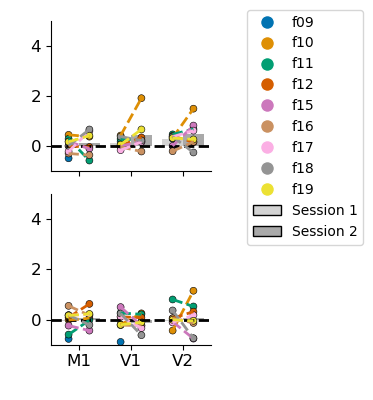

In [38]:
plot_group_dsm1(df,'Fig1_visual_LR.png',selected_roi_labels,subj_labels,
               selected_epoch_labels,'data_LR',session_palette)

<Figure size 800x1600 with 0 Axes>

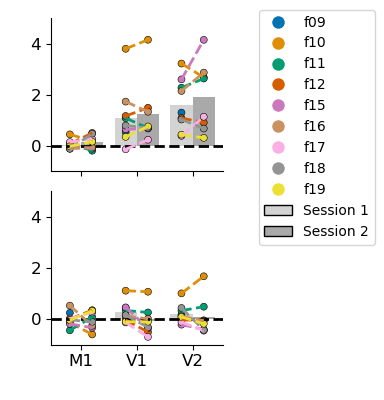

In [117]:
plot_group_dsm1(df,'Fig1_visual_WT.png',selected_roi_labels,subj_labels,
               selected_epoch_labels,'data_WT',session_palette)

<Figure size 800x1600 with 0 Axes>

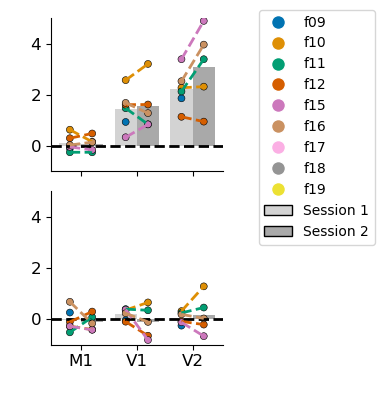

In [118]:
plot_group_dsm1(df,'Fig1_visual_ecc.png',selected_roi_labels,subj_labels,
               selected_epoch_labels,'data_ecc',session_palette)

<Figure size 800x1600 with 0 Axes>

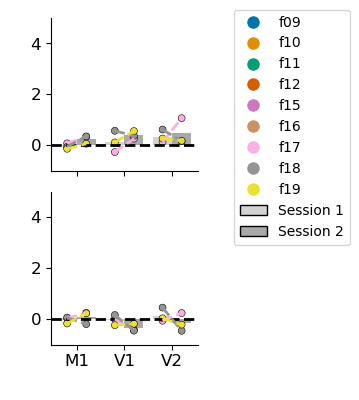

In [120]:
plot_group_dsm1(df,'Fig1_visual_CN.png',selected_roi_labels,subj_labels,
               selected_epoch_labels,'data_CN',session_palette)

In [201]:
# # let's plot!
from matplotlib.patches import Patch
def plot_group_dsm2(dis_val_all,title,roi_labels,subj_labels,epoch_labels,data_column_name,session_palette):
    roi_order = list(roi_labels.values())

    # Define color-blind friendly palettes
    #session_palette = ['#D3D3D3', '#A9A9A9']  #sns.color_palette("colorblind", 2) 
    # A distinct color palette for participants
    participant_palette = sns.color_palette("colorblind", dis_val_all['subj'].unique().shape[0])

    # Offset for the scatter points to align with the bar centers
    session_offsets = {'Session 1': -0.2, 'Session 2': 0.2}

    # Function to plot scatter points and connecting lines
    def scatter_and_lines(data, **kwargs):
        ax = plt.gca()
        
        # Plot scatter points
        for session, offset in session_offsets.items():
            subset = data[data['session'] == session]
            x_coords = [roi_order.index(roi) + offset for roi in subset['roi']]
            if session == 'Session 1':
                sns.scatterplot(x=x_coords, y=subset[data_column_name], hue=subset['subj'], palette=participant_palette, 
                                style=subset['session'], edgecolor='black', s=15, ax=ax, alpha=1, **kwargs)
            else:
                sns.scatterplot(x=x_coords, y=subset[data_column_name], hue=subset['subj'], palette=participant_palette[1:], 
                                style=subset['session'], edgecolor='black', s=15, ax=ax, alpha=1, **kwargs)                
        # Plot connecting lines
        for _, group in data.groupby(['subj', 'roi']):
            participant_index = list(subj_labels.values()).index(group['subj'].iloc[0])  # Use integer index to access the palette
            x_coords = [roi_order.index(roi) + session_offsets[session] for roi, session in zip(group['roi'], group['session'])]
            ax.plot(x_coords, group[data_column_name], color=participant_palette[participant_index], linewidth=2, linestyle='--', alpha=1)

    # Plotting
    task_epoch_order = ["stimulus", "delay"] # "response"
    plt.figure(figsize=(8, 16))
    #g = sns.FacetGrid(dis_val_all, col="epoch", col_order=task_epoch_order, col_wrap=1, height=1.5, aspect=1.5)
    g = sns.FacetGrid(dis_val_all, col="epoch", col_order=task_epoch_order, col_wrap=1, height=1.5, aspect=2)
#     g.map_dataframe(sns.boxplot, x='roi', y=data_column_name, hue='session', 
#            order=roi_order,dodge=True, palette=session_palette) #ci='sd',errcolor='#A9A9A9', errwidth=1, capsize=0, 
    g.map_dataframe(sns.barplot, x='roi', y=data_column_name, hue='session',
                    order=roi_order,errorbar=None,dodge=True, palette=session_palette,zorder=1) #hue='session',
    
    # Adjusting the labels and titles
    g.set_axis_labels(" ", " ")
    g.set_titles(col_template="", row_template="")

    # # Setting an overall title
    # g.fig.suptitle("Comparison of ROI Values Across Sessions and Task Epochs", fontsize=16)

    # Adjusting the legend
    for ax in g.axes.flat:
        if ax.legend_:
            ax.legend_.remove()
        ax.axhline(0, color='black', linestyle='--', linewidth=2)

    # Manually create a legend
    handles, labels = [], []
    for participant, color in zip(subj_labels.values(), participant_palette):
        handles.append(plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=color, alpha = 1, markersize=10, label=participant))

    handles += [
        Patch(facecolor=session_palette[0], edgecolor='black', label='Session 1'),
        Patch(facecolor=session_palette[1], edgecolor='black', label='Session 2')
    ]

    g.map_dataframe(scatter_and_lines)
    
    # Adjusting font sizes for axes
    for ax in g.axes.flat:
        ax.set_xlabel(ax.get_xlabel(), fontsize=12)
        ax.set_ylabel(ax.get_ylabel(), fontsize=12)
        ax.set_title(ax.get_title(), fontsize=12)
        ax.tick_params(axis='x', labelsize=12)
        ax.tick_params(axis='y', labelsize=12)
        ax.set_ylim(-1, 1.5) #2.5 - parietal

    # # Adjust layout to make room for the overall title
    # plt.subplots_adjust(top=0.9)

    g.fig.legend(handles=handles, ncol=1,bbox_to_anchor=(1.6,1))

    plt.show()
    g.savefig(title,bbox_inches = 'tight',dpi=300)
    

In [135]:
print(roi_labels)

{'area4': 'M1', 'v1': 'V1', 'v2': 'V2', 'ips0': 'IPS0', 'ips1': 'IPS1', 'ips2': 'IPS2', 'ips3': 'IPS3', 'ips4': 'IPS4', 'ips5': 'IPS5', 'spl1': 'SPL1', 'ips': 'IPS', 'fef': 'FEF', 'sfg': 'SFG', 'mfg': 'MFG', 'ifg': 'IFG'}


In [151]:
selected_rois = ['M1','IPS0','IPS1','IPS2','SPL1'] #'IPS3','IPS4','IPS5',
selected_rois_key = ['area4','ips0','ips1','ips2','spl1'] #'ips3','ips4','ips5',dpi=1200
selected_epochs = ['stimulus','delay']
selected_epochs_key = [0,1]
df = dis_val_all[(dis_val_all['roi'].isin(selected_rois)) 
                  & (dis_val_all['epoch'].isin(selected_epochs))]

selected_roi_labels = {key: roi_labels[key] for key in selected_rois_key if key in roi_labels}
selected_epoch_labels = {key: epoch_labels[key] for key in selected_epochs_key if key in epoch_labels}

In [152]:
print(df)

                                                   rdm      data   data_LR  \
0    [[0.0, -0.7324635345776173, -0.108919307797111...  0.061848  0.101922   
8    [[0.0, 1.601711088052073, 0.9172537018139598, ...  0.478663  0.510593   
9    [[0.0, 2.038445927005223, -0.2785817668660585,...  0.335375  0.310974   
10   [[0.0, 0.7981389949118558, 0.41221273113029494...  1.026092  0.988244   
14   [[0.0, -0.5630950217678772, -0.203957370011361...  0.103903  0.102727   
..                                                 ...       ...       ...   
754  [[0.0, 0.08045094642044266, -0.795747067879306...  0.152584  0.141067   
755  [[0.0, 0.07173335697757947, -0.395171177494033...  0.480327  0.537564   
756  [[0.0, 0.1636504415565654, -0.7872924886581157... -0.021920 -0.031884   
763  [[0.0, -0.3998607618613299, 0.7611737399950406...  0.410398  0.416727   
764  [[0.0, -0.0532914686720995, -0.701384800966883...  0.048504  0.035617   

      data_WT  data_ecc subj   roi    session     epoch   data_

In [153]:
print(selected_roi_labels)

{'area4': 'M1', 'ips0': 'IPS0', 'ips1': 'IPS1', 'ips2': 'IPS2', 'spl1': 'SPL1'}


<Figure size 800x1600 with 0 Axes>

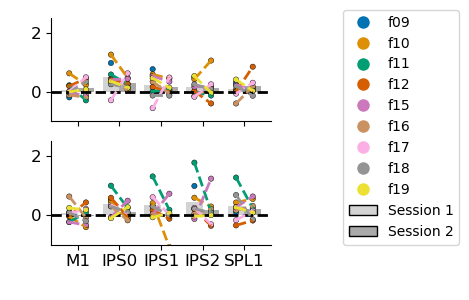

In [164]:
plot_group_dsm2(df,'Fig2_parietal_LR.png',selected_roi_labels,subj_labels,
               selected_epoch_labels,'data_LR',session_palette)

<Figure size 800x1600 with 0 Axes>

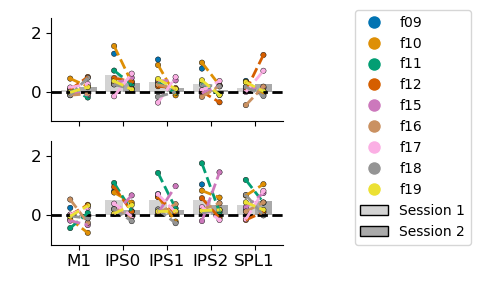

In [165]:
plot_group_dsm2(df,'Fig2_parietal_WT.png',selected_roi_labels,subj_labels,
               selected_epoch_labels,'data_WT',session_palette)

<Figure size 800x1600 with 0 Axes>

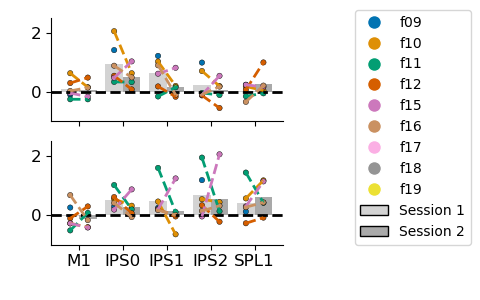

In [166]:
plot_group_dsm2(df,'Fig2_parietal_ecc.png',selected_roi_labels,subj_labels,
               selected_epoch_labels,'data_ecc',session_palette)

<Figure size 800x1600 with 0 Axes>

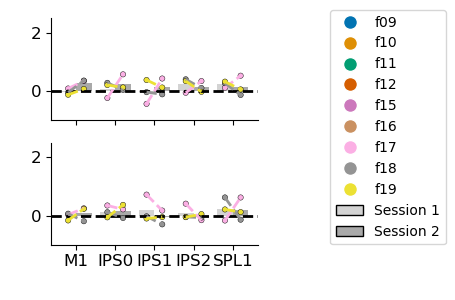

In [167]:
plot_group_dsm2(df,'Fig2_parietal_CN.png',selected_roi_labels,subj_labels,
               selected_epoch_labels,'data_CN',session_palette)

In [173]:
print(roi_labels)

{'area4': 'M1', 'v1': 'V1', 'v2': 'V2', 'ips0': 'IPS0', 'ips1': 'IPS1', 'ips2': 'IPS2', 'ips3': 'IPS3', 'ips4': 'IPS4', 'ips5': 'IPS5', 'spl1': 'SPL1', 'ips': 'IPS', 'fef': 'FEF', 'sfg': 'SFG', 'mfg': 'MFG', 'ifg': 'IFG'}


In [202]:
selected_rois = ['M1','FEF','SFG','MFG','IFG']
selected_rois_key = ['area4','fef','sfg','mfg','ifg']
selected_epochs = ['stimulus','delay']
selected_epochs_key = [0,1]
df = dis_val_all[(dis_val_all['roi'].isin(selected_rois)) 
                  & (dis_val_all['epoch'].isin(selected_epochs))]

selected_roi_labels = {key: roi_labels[key] for key in selected_rois_key if key in roi_labels}
selected_epoch_labels = {key: epoch_labels[key] for key in selected_epochs_key if key in epoch_labels}

In [203]:
print(df)

                                                   rdm      data   data_LR  \
0    [[0.0, -0.7324635345776173, -0.108919307797111...  0.061848  0.101922   
4    [[0.0, 0.38394711268386733, 0.2855625949756306...  0.551517  0.502683   
5    [[0.0, 0.7604433115923835, 0.545768695811138, ...  0.316560  0.249080   
6    [[0.0, 0.646787226935447, 0.4806338979748952, ...  0.490211  0.462949   
7    [[0.0, -0.28249281437680007, 0.363372156666726...  0.143083  0.092847   
..                                                 ...       ...       ...   
746  [[0.0, 0.6130658657649954, -0.0610436957848510...  0.210746  0.160466   
747  [[0.0, 0.4404194810833976, -0.0245976916362566...  0.158642  0.122230   
748  [[0.0, 0.30114312462022774, -0.696581954427410...  0.131046  0.209228   
749  [[0.0, 0.5418489297679722, -0.1127662764307493...  0.330785  0.240303   
750  [[0.0, 0.05574983618189939, -1.061494727561466...  0.017150  0.031212   

      data_WT  data_ecc subj  roi    session     epoch   data_C

In [204]:
print(selected_roi_labels)

{'area4': 'M1', 'fef': 'FEF', 'sfg': 'SFG', 'mfg': 'MFG', 'ifg': 'IFG'}


<Figure size 800x1600 with 0 Axes>

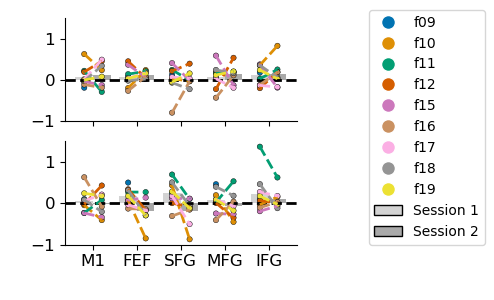

In [205]:
plot_group_dsm2(df,'Fig3_frontal_LR.png',selected_roi_labels,subj_labels,
               selected_epoch_labels,'data_LR',session_palette)

<Figure size 800x1600 with 0 Axes>

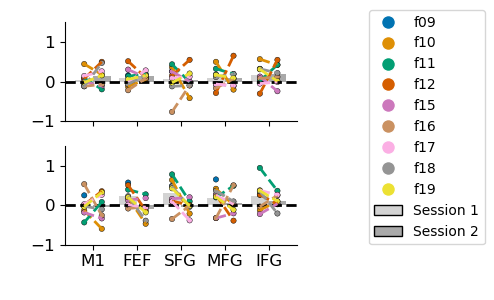

In [206]:
plot_group_dsm2(df,'Fig3_frontal_WT.png',selected_roi_labels,subj_labels,
               selected_epoch_labels,'data_WT',session_palette)

<Figure size 800x1600 with 0 Axes>

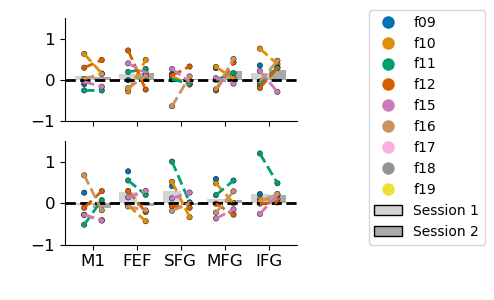

In [207]:
plot_group_dsm2(df,'Fig1_visual_ecc.png',selected_roi_labels,subj_labels,
               selected_epoch_labels,'data_ecc',session_palette)

<Figure size 800x1600 with 0 Axes>

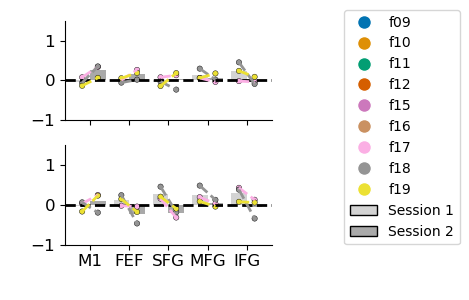

In [208]:
plot_group_dsm2(df,'Fig1_visual_CN.png',selected_roi_labels,subj_labels,
               selected_epoch_labels,'data_CN',session_palette)

In [212]:
dis_val_all

,rdm,data,data_LR,data_WT,data_ecc,subj,roi,session,epoch,data_CN
0,"[[0.0, -0.7324635345776173, -0.108919307797111...",0.061848,0.101922,0.246875,0.257968,f09,M1,Session 1,delay,NaN
1,"[[0.0, 0.771706414322639, 0.7670452400013582, ...",-0.035710,0.017256,0.438374,-0.044304,f09,V1,Session 1,delay,NaN
2,"[[0.0, -1.8191437292772619, -0.116886986624678...",-0.290702,-0.159276,0.168966,-0.253085,f09,V2,Session 1,delay,NaN
3,"[[0.0, 0.8977971154720681, 0.7041173648949517,...",0.737414,0.750474,0.951092,0.695110,f09,IPS,Session 1,delay,NaN
4,"[[0.0, 0.38394711268386733, 0.2855625949756306...",0.551517,0.502683,0.569336,0.773917,f09,FEF,Session 1,delay,NaN
...,...,...,...,...,...,...,...,...,...,...
760,"[[0.0, 0.31867457829051576, 0.0430409979588792...",0.103514,0.070017,0.047273,NaN,f19,IPS4,Session 2,stimulus,0.024730
761,"[[0.0, 0.8794006721336588, -0.2144891180172879...",0.316338,0.272341,0.373731,NaN,f19,IPS5,Session 1,stimulus,0.194514
762,"[[0.0, 0.371694676209163, 0.16139653371206236,...",0.228329,0.171931,0.140533,NaN,f19,IPS5,Session 2,stimulus,0.141267
763,"[[0.0, -0.3998607618613299, 0.7611737399950406...",0.410398,0.416727,0.327096,NaN,f19,SPL1,Session 1,stimulus,0.313488


In [149]:
participant_palette = sns.color_palette("colorblind", dis_val_all['subj'].unique().shape[0])
print(participant_palette)

[(0.00392156862745098, 0.45098039215686275, 0.6980392156862745), (0.8705882352941177, 0.5607843137254902, 0.0196078431372549), (0.00784313725490196, 0.6196078431372549, 0.45098039215686275), (0.8352941176470589, 0.3686274509803922, 0.0), (0.8, 0.47058823529411764, 0.7372549019607844), (0.792156862745098, 0.5686274509803921, 0.3803921568627451), (0.984313725490196, 0.6862745098039216, 0.8941176470588236), (0.5803921568627451, 0.5803921568627451, 0.5803921568627451), (0.9254901960784314, 0.8823529411764706, 0.2)]


In [150]:
subset = dis_val_all[(dis_val_all['session'] == 'Session 1') & (dis_val_all['epoch'] == 'stimulus')]
print(subset['subj'])

510    f09
511    f09
512    f09
513    f09
514    f09
      ... 
755    f19
757    f19
759    f19
761    f19
763    f19
Name: subj, Length: 135, dtype: object


In [151]:
list(subj_labels.values())

['f09', 'f10', 'f11', 'f12', 'f15', 'f16', 'f17', 'f18', 'f19']

In [190]:
def plot_group_dsm_star(dis_val_all, title, roi_labels, subj_labels, epoch_labels, data_column_name, 
                   session_palette, significance_df,aspect,ylim0,ylim1):
    roi_order = list(roi_labels.values())
    subj_order = list(subj_labels.values())
    
    # Define color-blind friendly palettes
    participant_palette = sns.color_palette("colorblind", dis_val_all['subj'].unique().shape[0])

    # Offset for the scatter points to align with the bar centers
    session_offsets = {'Session 1': -0.2, 'Session 2': 0.2}   
    
    def scatter_and_lines(data, **kwargs):
        ax = plt.gca()

        # Plot scatter points
        for session, offset in session_offsets.items():
            subset = data[data['session'] == session]
            x_coords = [roi_order.index(roi) + offset for roi in subset['roi']]
            sns.scatterplot(x=x_coords, y=subset[data_column_name], hue=subset['subj'], palette=participant_palette, 
                            style=subset['session'], hue_order=subj_order, edgecolor='black', s=50, ax=ax, alpha=1, **kwargs)
            # s = 15
            
        # Plot connecting lines
        for subj in subj_order:
            participant_data = data[data['subj'] == subj]
            if participant_data['session'].nunique() > 1:  # Check if data spans multiple sessions
                for roi in roi_order:
                    roi_data = participant_data[participant_data['roi'] == roi]
                    if roi_data.shape[0] > 1:  # Only plot lines if there are points in multiple sessions
                        x_coords = [roi_order.index(roi) + session_offsets[session] for session in roi_data['session']]
                        y_coords = [y for y in roi_data[data_column_name]]
                        participant_index = list(subj_labels.values()).index(subj)  # Use integer index to access the palette
                        ax.plot(x_coords, y_coords, color=participant_palette[participant_index], linewidth=2, linestyle='--', alpha=1)



    # Function to add significance stars
    def add_significance_stars(ax, current_epoch):
        
        # Filter the significance_df for the current epoch
        epoch_significance_df = significance_df[significance_df['epoch'] == current_epoch]

        for i, row in epoch_significance_df.iterrows():
            if row['p_value'] < 0.05:
                roi = row['roi']
                session = row['session']
                
                roi_idx = roi_order.index(roi)
                session_offset = session_offsets[session]
                x_coord = roi_idx + session_offset
                y_coord = dis_val_all[(dis_val_all['roi'] == roi) & 
                                      (dis_val_all['session'] == session) & 
                                      (dis_val_all['epoch'] == current_epoch)][data_column_name].max() + 0.1
                
                if row['p_value'] < 0.001:
                    stars = '***'
                elif row['p_value'] < 0.01:
                    stars = '**'
                else:
                    stars = '*'
                
                ax.annotate(stars, (x_coord, y_coord), textcoords="offset points", xytext=(0,5), ha='center', fontsize=12, color='red')
                #12
    # Plotting
    task_epoch_order = ["stimulus", "delay"]
    plt.figure(figsize=(8, 16)) # 8, 16
    g = sns.FacetGrid(dis_val_all, col="epoch", col_order=task_epoch_order, col_wrap=1, height=1.5, aspect=aspect) # height 1.5
    g.map_dataframe(sns.barplot, x='roi', y=data_column_name, hue='session', order=roi_order, errorbar=None, dodge=True, palette=session_palette, zorder=1)
    
    # Adjusting the labels and titles
    g.set_axis_labels(" ", " ")
    g.set_titles(col_template="", row_template="")

    # Adjusting the legend
    for ax in g.axes.flat:
        if ax.legend_:
            ax.legend_.remove()
        ax.axhline(0, color='black', linestyle='--', linewidth=2)

    # Manually create a legend
    handles, labels = [], []
    for participant, color in zip(subj_labels.values(), participant_palette):
        handles.append(plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=color, alpha=1, markersize=10, label=participant))

    handles += [
        Patch(facecolor=session_palette[0], edgecolor='black', label='Session 1'),
        Patch(facecolor=session_palette[1], edgecolor='black', label='Session 2')
    ]

    g.map_dataframe(scatter_and_lines)

    # Add significance stars
    for ax, current_epoch in zip(g.axes.flat, task_epoch_order):
        plt.sca(ax)
        #scatter_and_lines(dis_val_all, current_epoch)
        add_significance_stars(ax, current_epoch)
    
    # Adjusting font sizes for axes
    for ax in g.axes.flat:
        ax.set_xlabel(ax.get_xlabel(), fontsize=12) #12
        ax.set_ylabel(ax.get_ylabel(), fontsize=12)
        ax.set_title(ax.get_title(), fontsize=12)
        ax.tick_params(axis='x', labelsize=12)
        ax.tick_params(axis='y', labelsize=12)
        ax.set_ylim(ylim0, ylim1) # Adjust according to your data

    # Adjust layout to make room for the overall title
    plt.subplots_adjust(top=0.9) #0.9
    plt.xticks(rotation=45)
    
    g.fig.legend(handles=handles, ncol=1, bbox_to_anchor=(1.6, 1)) #ncol=11, bbox_to_anchor=(0.5, 2) # 1.6,1

    plt.show()
    g.savefig(title, bbox_inches='tight', dpi=300)

In [213]:
def plot_group_dsm_star(dis_val_all, title, roi_labels, subj_labels, epoch_labels, data_column_name, 
                        session_palette, significance_df, sig_df1, aspect, ylim0, ylim1):
    roi_order = list(roi_labels.values())
    subj_order = list(subj_labels.values())

    # Define color-blind friendly palettes
    participant_palette = sns.color_palette("colorblind", dis_val_all['subj'].unique().shape[0])

    # Offset for the scatter points to align with the bar centers
    session_offsets = {'Session 1': -0.2, 'Session 2': 0.2}

    def scatter_and_lines(data, **kwargs):
        ax = plt.gca()

        # Plot scatter points
        for session, offset in session_offsets.items():
            subset = data[data['session'] == session]
            x_coords = [roi_order.index(roi) + offset for roi in subset['roi']]
            sns.scatterplot(x=x_coords, y=subset[data_column_name], hue=subset['subj'], palette=participant_palette, 
                            style=subset['session'], hue_order=subj_order, edgecolor='black', s=15, ax=ax, alpha=1, **kwargs)
            
        # Plot connecting lines
        for subj in subj_order:
            participant_data = data[data['subj'] == subj]
            if participant_data['session'].nunique() > 1:  # Check if data spans multiple sessions
                for roi in roi_order:
                    roi_data = participant_data[participant_data['roi'] == roi]
                    if roi_data.shape[0] > 1:  # Only plot lines if there are points in multiple sessions
                        x_coords = [roi_order.index(roi) + session_offsets[session] for session in roi_data['session']]
                        y_coords = [y for y in roi_data[data_column_name]]
                        participant_index = list(subj_labels.values()).index(subj)  # Use integer index to access the palette
                        ax.plot(x_coords, y_coords, color=participant_palette[participant_index], linewidth=2, linestyle='--', alpha=1)

    # Function to add significance stars
    def add_significance_stars(ax, current_epoch):
        # Filter the significance_df for the current epoch
        epoch_significance_df = significance_df[significance_df['epoch'] == current_epoch]

        for i, row in epoch_significance_df.iterrows():
            if row['p_value'] < 0.05:
                roi = row['roi']
                session = row['session']
                
                roi_idx = roi_order.index(roi)
                session_offset = session_offsets[session]
                x_coord = roi_idx + session_offset
                y_coord = dis_val_all[(dis_val_all['roi'] == roi) & 
                                      (dis_val_all['session'] == session) & 
                                      (dis_val_all['epoch'] == current_epoch)][data_column_name].max() + 0.1

                if row['p_value'] < 0.001:
                    stars = '***'
                elif row['p_value'] < 0.01:
                    stars = '**'
                else:
                    stars = '*'

                ax.annotate(stars, (x_coord, y_coord), textcoords="offset points", xytext=(0, 5), ha='center', fontsize=12, color='black')

    # Function to add between-session significance stars and horizontal lines
    def add_between_session_stars(ax, current_epoch):
        epoch_significance_df = sig_df1[sig_df1['epoch'] == current_epoch]

        for i, row in epoch_significance_df.iterrows():
            if row['p_value'] < 0.05:
                roi = row['roi']
                roi_idx = roi_order.index(roi)
                session1_offset = session_offsets['Session 1']
                session2_offset = session_offsets['Session 2']
                x_coord1 = roi_idx + session1_offset
                x_coord2 = roi_idx + session2_offset
                x_coord_mean = (x_coord1 + x_coord2) / 2
                y_coord = dis_val_all[(dis_val_all['roi'] == roi) & 
                                      (dis_val_all['epoch'] == current_epoch)][data_column_name].max() + 0.3

                if row['p_value'] < 0.001:
                    stars = '***'
                elif row['p_value'] < 0.01:
                    stars = '**'
                else:
                    stars = '*'

                ax.annotate(stars, (x_coord_mean, y_coord), textcoords="offset points", xytext=(0, 10), ha='center', fontsize=12, color='black')
                ax.plot([x_coord1, x_coord2], [y_coord+0.6, y_coord+0.6], color='black', linewidth=1.5, linestyle='-')

    # Plotting
    task_epoch_order = ["stimulus", "delay"]
    plt.figure(figsize=(8, 16))  # Adjust size as needed
    g = sns.FacetGrid(dis_val_all, col="epoch", col_order=task_epoch_order, col_wrap=1, height=1.5, aspect=aspect)
    g.map_dataframe(sns.barplot, x='roi', y=data_column_name, hue='session', order=roi_order, errorbar=None, dodge=True, palette=session_palette, zorder=1)

    # Adjusting the labels and titles
    g.set_axis_labels(" ", " ")
    g.set_titles(col_template="", row_template="")

    # Adjusting the legend
    for ax in g.axes.flat:
        if ax.legend_:
            ax.legend_.remove()
        ax.axhline(0, color='black', linestyle='--', linewidth=2)

    # Manually create a legend
    handles, labels = [], []
    for participant, color in zip(subj_labels.values(), participant_palette):
        handles.append(plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=color, alpha=1, markersize=10, label=participant))

    handles += [
        Patch(facecolor=session_palette[0], edgecolor='black', label='Session 1'),
        Patch(facecolor=session_palette[1], edgecolor='black', label='Session 2')
    ]

    g.map_dataframe(scatter_and_lines)

    # Add significance stars
    for ax, current_epoch in zip(g.axes.flat, task_epoch_order):
        plt.sca(ax)
        add_significance_stars(ax, current_epoch)
        add_between_session_stars(ax, current_epoch)

    # Adjusting font sizes for axes
    for ax in g.axes.flat:
        ax.set_xlabel(ax.get_xlabel(), fontsize=12)
        ax.set_ylabel(ax.get_ylabel(), fontsize=12)
        ax.set_title(ax.get_title(), fontsize=12)
        ax.tick_params(axis='x', labelsize=12)
        ax.tick_params(axis='y', labelsize=12)
        ax.set_ylim(ylim0, ylim1)

    #plt.xticks(rotation=45)
    #plt.subplots_adjust(hspace=0.1)
    
    plt.show()
    g.savefig(title, bbox_inches='tight', dpi=300)


In [186]:
selected_rois = ['M1','FEF','SFG','MFG','IFG']
selected_rois_key = ['area4','fef','sfg','mfg','ifg']
selected_epochs = ['stimulus','delay']
selected_epochs_key = [0,1]
df = dis_val_all[(dis_val_all['roi'].isin(selected_rois)) 
                  & (dis_val_all['epoch'].isin(selected_epochs))]

selected_roi_labels = {key: roi_labels[key] for key in selected_rois_key if key in roi_labels}
selected_epoch_labels = {key: epoch_labels[key] for key in selected_epochs_key if key in epoch_labels}

In [187]:
print(subj_labels)

{0: 'f09', 1: 'f10', 2: 'f11', 3: 'f12', 4: 'f15', 5: 'f16', 6: 'f17', 7: 'f18', 8: 'f19'}


In [188]:
dis_val_all[dis_val_all['subj']=='f09']

,rdm,data,data_LR,data_WT,data_ecc,data_LRWT,data_eccWT,data_eccLR,data_eccLRWT,subj,roi,session,epoch,data_CN,data_CNWT,data_CNLR,data_CNLRWT
0,"[[0.0, -0.7324635345776173, -0.108919307797111...",0.061848,-0.768956,-0.376292,-0.257028,0.546311,0.658567,0.471418,0.158915,f09,M1,Session 1,delay,NaN,NaN,NaN,NaN
1,"[[0.0, 0.771706414322639, 0.7670452400013582, ...",-0.035710,-0.888137,-0.341728,-0.904173,1.157109,0.926904,-0.211159,0.011212,f09,V1,Session 1,delay,NaN,NaN,NaN,NaN
2,"[[0.0, -1.8191437292772619, -0.116886986624678...",-0.290702,-1.168892,-0.726855,-1.015108,0.873171,0.344151,-0.526779,0.185396,f09,V2,Session 1,delay,NaN,NaN,NaN,NaN
3,"[[0.0, 0.8977971154720681, 0.7041173648949517,...",0.737414,0.323501,0.435958,0.547564,1.621999,1.176481,0.486467,0.569929,f09,IPS,Session 1,delay,NaN,NaN,NaN,NaN
4,"[[0.0, 0.38394711268386733, 0.2855625949756306...",0.551517,0.137816,0.228684,0.732233,0.398455,0.888974,0.713230,0.761229,f09,FEF,Session 1,delay,NaN,NaN,NaN,NaN
5,"[[0.0, 0.7604433115923835, 0.545768695811138, ...",0.316560,-0.389044,0.374552,0.285209,0.561016,0.559839,0.379996,0.444351,f09,SFG,Session 1,delay,NaN,NaN,NaN,NaN
6,"[[0.0, 0.646787226935447, 0.4806338979748952, ...",0.490211,-0.035687,0.331706,0.353262,0.778931,0.894718,0.520213,0.588338,f09,MFG,Session 1,delay,NaN,NaN,NaN,NaN
7,"[[0.0, -0.28249281437680007, 0.363372156666726...",0.143083,-0.322461,0.216406,-0.021044,0.209328,0.434826,0.289319,0.195204,f09,IFG,Session 1,delay,NaN,NaN,NaN,NaN
8,"[[0.0, 1.601711088052073, 0.9172537018139598, ...",0.478663,0.088490,0.797524,-0.158279,1.303401,0.669022,0.168762,0.481717,f09,IPS0,Session 1,delay,NaN,NaN,NaN,NaN
9,"[[0.0, 2.038445927005223, -0.2785817668660585,...",0.335375,-0.240631,0.753417,-0.288445,0.845760,0.638757,0.022747,0.616022,f09,IPS1,Session 1,delay,NaN,NaN,NaN,NaN


/tmp/ipykernel_30456/1564962005.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  significant_results_df['epoch'] = pd.Categorical(significant_results_df['epoch'], categories=epoch_order, ordered=True)
/tmp/ipykernel_30456/745491356.py:27: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  t_stat, p_value = ttest_rel(data_session1[:min_length], data_session2[:min_length])
/tmp/ipykernel_30456/745491356.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFr

      session     epoch  roi    t_stat   p_value
16  Session 2  stimulus  FEF  2.064539  0.038921
   epoch  roi   session1   session2   t_stat   p_value
2  delay  SFG  Session 1  Session 2  2.66028  0.032454


<Figure size 800x1600 with 0 Axes>

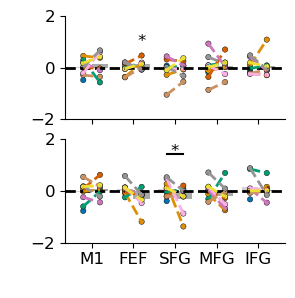

In [214]:
sig_df = ttest_crossnobis(df,'data_LR')
results_df,sig_df1 = ttest_paired_sessions(df, 'data_LR', 'Session 1', 'Session 2')
print(sig_df)
print(sig_df1)

plot_group_dsm_star(df,'Fig3_frontal_LR.png',selected_roi_labels,subj_labels,
               selected_epoch_labels,'data_LR',session_palette,sig_df,sig_df1,2,-2,2)

In [201]:
# # plot legends
# # change this: ncol=11, bbox_to_anchor=(0.5, 2)
# sig_df = ttest_crossnobis(df,'data_LR')
# plot_group_dsm_star(df,'legend.png',selected_roi_labels,subj_labels,
#                selected_epoch_labels,'data_LR',session_palette,sig_df,2,-2,2)
# print(sig_df)

In [204]:
# sig_df = ttest_crossnobis(df,'data_LR')
# plot_group_dsm_star(df,'Fig3_frontal_LR.png',selected_roi_labels,subj_labels,
#                selected_epoch_labels,'data_LR',session_palette,sig_df,2,-2,2)
# print(sig_df)

/tmp/ipykernel_30456/1564962005.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  significant_results_df['epoch'] = pd.Categorical(significant_results_df['epoch'], categories=epoch_order, ordered=True)
/tmp/ipykernel_30456/745491356.py:27: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  t_stat, p_value = ttest_rel(data_session1[:min_length], data_session2[:min_length])


      session     epoch  roi    t_stat   p_value
2   Session 1     delay  SFG  2.060389  0.036658
15  Session 2  stimulus   M1  2.410193  0.023380
Empty DataFrame
Columns: [epoch, roi, session1, session2, t_stat, p_value]
Index: []


<Figure size 800x1600 with 0 Axes>

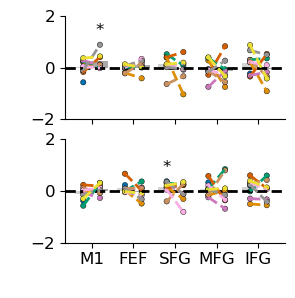

In [215]:
sig_df = ttest_crossnobis(df,'data_WT')
results_df,sig_df1 = ttest_paired_sessions(df, 'data_WT', 'Session 1', 'Session 2')
print(sig_df)
print(sig_df1)

plot_group_dsm_star(df,'Fig3_frontal_WT.png',selected_roi_labels,subj_labels,
               selected_epoch_labels,'data_WT',session_palette,sig_df,sig_df1,2,-2,2)

In [206]:
# sig_df = ttest_crossnobis(df,'data_WT')
# plot_group_dsm_star(df,'Fig3_frontal_WT.png',selected_roi_labels,subj_labels,
#                selected_epoch_labels,'data_WT',session_palette,sig_df,2,-2,2)
# print(sig_df)

/tmp/ipykernel_30456/1564962005.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  significant_results_df['epoch'] = pd.Categorical(significant_results_df['epoch'], categories=epoch_order, ordered=True)
/tmp/ipykernel_30456/745491356.py:27: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  t_stat, p_value = ttest_rel(data_session1[:min_length], data_session2[:min_length])
/tmp/ipykernel_30456/745491356.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFr

      session  epoch  roi    t_stat   p_value
14  Session 2  delay  IFG  2.581222  0.030624
   epoch  roi   session1   session2   t_stat   p_value
2  delay  SFG  Session 1  Session 2  2.66028  0.032454


<Figure size 800x1600 with 0 Axes>

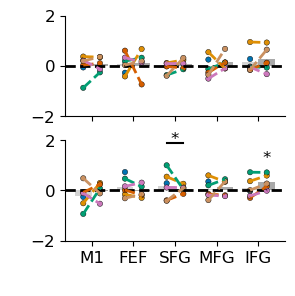

In [216]:
sig_df = ttest_crossnobis(df,'data_ecc')
results_df,sig_df1 = ttest_paired_sessions(df, 'data_LR', 'Session 1', 'Session 2')
print(sig_df)
print(sig_df1)

plot_group_dsm_star(df,'Fig3_frontal_ecc.png',selected_roi_labels,subj_labels,
               selected_epoch_labels,'data_ecc',session_palette,sig_df,sig_df1,2,-2,2)

In [211]:
# sig_df = ttest_crossnobis(df,'data_ecc')
# plot_group_dsm_star(df,'Fig3_frontal_ecc.png',selected_roi_labels,subj_labels,
#                selected_epoch_labels,'data_ecc',session_palette,sig_df,2,-2,2)
# print(sig_df)

/tmp/ipykernel_30456/1564962005.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  significant_results_df['epoch'] = pd.Categorical(significant_results_df['epoch'], categories=epoch_order, ordered=True)
/tmp/ipykernel_30456/745491356.py:27: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  t_stat, p_value = ttest_rel(data_session1[:min_length], data_session2[:min_length])
/tmp/ipykernel_30456/745491356.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFr

      session     epoch  roi     t_stat   p_value
8   Session 1  stimulus  MFG  12.218014  0.003316
9   Session 1  stimulus  IFG   4.741787  0.020856
1   Session 1     delay  FEF   3.499990  0.036414
15  Session 2  stimulus   M1   5.380034  0.016428
      epoch roi   session1   session2    t_stat   p_value
5  stimulus  M1  Session 1  Session 2 -6.178218  0.025212


<Figure size 800x1600 with 0 Axes>

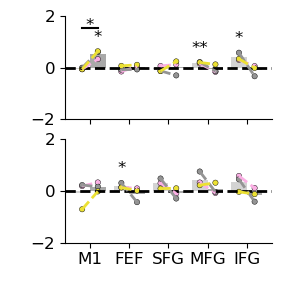

In [217]:
sig_df = ttest_crossnobis(df,'data_CN')
results_df,sig_df1 = ttest_paired_sessions(df, 'data_CN', 'Session 1', 'Session 2')
print(sig_df)
print(sig_df1)

plot_group_dsm_star(df,'Fig3_frontal_CN.png',selected_roi_labels,subj_labels,
               selected_epoch_labels,'data_CN',session_palette,sig_df,sig_df1,2,-2,2)

In [218]:
# sig_df = ttest_crossnobis(df,'data_CN')
# plot_group_dsm_star(df,'Fig3_frontal_CN.png',selected_roi_labels,subj_labels,
#                selected_epoch_labels,'data_CN',session_palette,sig_df,2,-2,2)
# print(sig_df)

/tmp/ipykernel_30456/1564962005.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  significant_results_df['epoch'] = pd.Categorical(significant_results_df['epoch'], categories=epoch_order, ordered=True)
/tmp/ipykernel_30456/745491356.py:27: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  t_stat, p_value = ttest_rel(data_session1[:min_length], data_session2[:min_length])


      session     epoch  roi    t_stat   p_value
0   Session 1     delay   M1  1.891881  0.047575
1   Session 1     delay  FEF  1.965937  0.042438
16  Session 2  stimulus  FEF  2.053352  0.039569
Empty DataFrame
Columns: [epoch, roi, session1, session2, t_stat, p_value]
Index: []


<Figure size 800x1600 with 0 Axes>

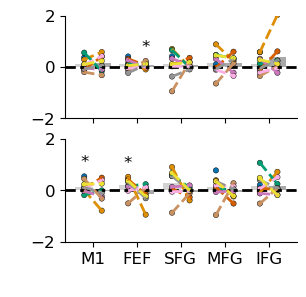

In [219]:
sig_df = ttest_crossnobis(df,'data_LRWT')
results_df,sig_df1 = ttest_paired_sessions(df, 'data_LRWT', 'Session 1', 'Session 2')
print(sig_df)
print(sig_df1)

plot_group_dsm_star(df,'Fig3_frontal_LRWT.png',selected_roi_labels,subj_labels,
               selected_epoch_labels,'data_LRWT',session_palette,sig_df,sig_df1,2,-2,2)

In [220]:
# sig_df = ttest_crossnobis(df,'data_LRWT')
# plot_group_dsm_star(df,'Fig3_frontal_LRWT.png',selected_roi_labels,subj_labels,
#                selected_epoch_labels,'data_LRWT',session_palette,sig_df,2,-2,2)
# print(sig_df)

/tmp/ipykernel_30456/1564962005.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  significant_results_df['epoch'] = pd.Categorical(significant_results_df['epoch'], categories=epoch_order, ordered=True)
/tmp/ipykernel_30456/745491356.py:27: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  t_stat, p_value = ttest_rel(data_session1[:min_length], data_session2[:min_length])
/tmp/ipykernel_30456/745491356.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFr

      session     epoch  roi    t_stat   p_value
1   Session 1     delay  FEF  2.959796  0.015763
16  Session 2  stimulus  FEF  4.403884  0.005828
   epoch  roi   session1   session2   t_stat   p_value
2  delay  SFG  Session 1  Session 2  2.66028  0.032454


<Figure size 800x1600 with 0 Axes>

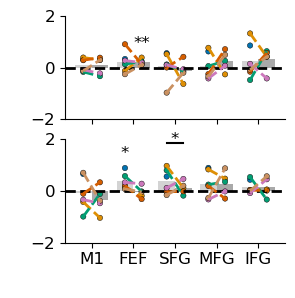

In [221]:
sig_df = ttest_crossnobis(df,'data_eccWT')
results_df,sig_df1 = ttest_paired_sessions(df, 'data_LR', 'Session 1', 'Session 2')
print(sig_df)
print(sig_df1)

plot_group_dsm_star(df,'Fig3_frontal_eccWT.png',selected_roi_labels,subj_labels,
               selected_epoch_labels,'data_eccWT',session_palette,sig_df,sig_df1,2,-2,2)

In [222]:
# sig_df = ttest_crossnobis(df,'data_eccWT')
# plot_group_dsm_star(df,'Fig3_frontal_eccWT.png',selected_roi_labels,subj_labels,
#                selected_epoch_labels,'data_eccWT',session_palette,sig_df,2,-2,2)
# print(sig_df)

/tmp/ipykernel_30456/745491356.py:27: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  t_stat, p_value = ttest_rel(data_session1[:min_length], data_session2[:min_length])


Empty DataFrame
Columns: [session, epoch, roi, t_stat, p_value]
Index: []
Empty DataFrame
Columns: [epoch, roi, session1, session2, t_stat, p_value]
Index: []


<Figure size 800x1600 with 0 Axes>

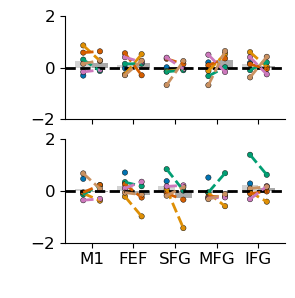

In [227]:
sig_df = ttest_crossnobis(df,'data_eccLR')
results_df,sig_df1 = ttest_paired_sessions(df, 'data_eccLR', 'Session 1', 'Session 2')
print(sig_df)
print(sig_df1)

plot_group_dsm_star(df,'Fig3_frontal_eccLR.png',selected_roi_labels,subj_labels,
               selected_epoch_labels,'data_eccLR',session_palette,sig_df,sig_df1,2,-2,2)

In [224]:
# sig_df = ttest_crossnobis(df,'data_eccLR')
# plot_group_dsm_star(df,'Fig3_frontal_eccLR.png',selected_roi_labels,subj_labels,
#                selected_epoch_labels,'data_eccLR',session_palette,sig_df,2,-2,2)
# print(sig_df)

/tmp/ipykernel_30456/1564962005.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  significant_results_df['epoch'] = pd.Categorical(significant_results_df['epoch'], categories=epoch_order, ordered=True)
/tmp/ipykernel_30456/745491356.py:27: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  t_stat, p_value = ttest_rel(data_session1[:min_length], data_session2[:min_length])
/tmp/ipykernel_30456/745491356.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFr

      session     epoch  roi    t_stat   p_value
1   Session 1     delay  FEF  2.229455  0.038109
2   Session 1     delay  SFG  2.191464  0.039975
19  Session 2  stimulus  IFG  2.265652  0.043070
      epoch  roi   session1   session2  t_stat   p_value
9  stimulus  IFG  Session 1  Session 2 -2.7973  0.048946


<Figure size 800x1600 with 0 Axes>

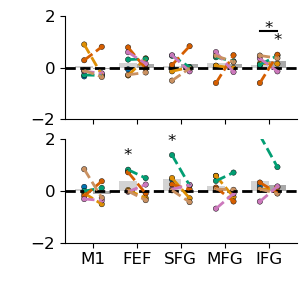

In [228]:
sig_df = ttest_crossnobis(df,'data_eccLRWT')
results_df,sig_df1 = ttest_paired_sessions(df, 'data_eccLRWT', 'Session 1', 'Session 2')
print(sig_df)
print(sig_df1)

plot_group_dsm_star(df,'Fig3_frontal_eccLRWT.png',selected_roi_labels,subj_labels,
               selected_epoch_labels,'data_eccLRWT',session_palette,sig_df,sig_df1,2,-2,2)

In [229]:
# sig_df = ttest_crossnobis(df,'data_eccLRWT')
# plot_group_dsm_star(df,'Fig3_frontal_eccLRWT.png',selected_roi_labels,subj_labels,
#                selected_epoch_labels,'data_eccLRWT',session_palette,sig_df,2,-2,2)
# print(sig_df)

/tmp/ipykernel_30456/1564962005.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  significant_results_df['epoch'] = pd.Categorical(significant_results_df['epoch'], categories=epoch_order, ordered=True)
/tmp/ipykernel_30456/745491356.py:27: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  t_stat, p_value = ttest_rel(data_session1[:min_length], data_session2[:min_length])


     session  epoch  roi    t_stat   p_value
3  Session 1  delay  MFG  4.209425  0.026034
Empty DataFrame
Columns: [epoch, roi, session1, session2, t_stat, p_value]
Index: []


<Figure size 800x1600 with 0 Axes>

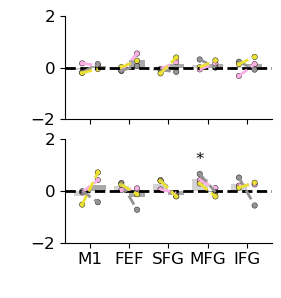

In [230]:
sig_df = ttest_crossnobis(df,'data_CNWT')
results_df,sig_df1 = ttest_paired_sessions(df, 'data_CNWT', 'Session 1', 'Session 2')
print(sig_df)
print(sig_df1)

plot_group_dsm_star(df,'Fig3_frontal_CNWT.png',selected_roi_labels,subj_labels,
               selected_epoch_labels,'data_CNWT',session_palette,sig_df,sig_df1,2,-2,2)

In [231]:
# sig_df = ttest_crossnobis(df,'data_CNWT')
# plot_group_dsm_star(df,'Fig3_frontal_CNWT.png',selected_roi_labels,subj_labels,
#                selected_epoch_labels,'data_CNWT',session_palette,sig_df,2,-2,2)
# print(sig_df)

/tmp/ipykernel_30456/1564962005.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  significant_results_df['epoch'] = pd.Categorical(significant_results_df['epoch'], categories=epoch_order, ordered=True)
/tmp/ipykernel_30456/745491356.py:27: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  t_stat, p_value = ttest_rel(data_session1[:min_length], data_session2[:min_length])


     session     epoch  roi    t_stat   p_value
8  Session 1  stimulus  MFG  5.739725  0.014519
Empty DataFrame
Columns: [epoch, roi, session1, session2, t_stat, p_value]
Index: []


<Figure size 800x1600 with 0 Axes>

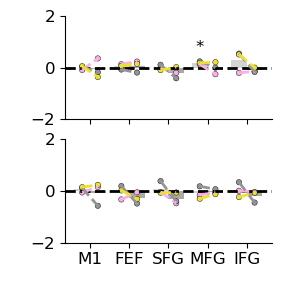

In [232]:
sig_df = ttest_crossnobis(df,'data_CNLR')
results_df,sig_df1 = ttest_paired_sessions(df, 'data_CNWT', 'Session 1', 'Session 2')
print(sig_df)
print(sig_df1)

plot_group_dsm_star(df,'Fig3_frontal_CNLR.png',selected_roi_labels,subj_labels,
               selected_epoch_labels,'data_CNLR',session_palette,sig_df,sig_df1,2,-2,2)

In [233]:
# sig_df = ttest_crossnobis(df,'data_CNLR')
# plot_group_dsm_star(df,'Fig3_frontal_CNLR.png',selected_roi_labels,subj_labels,
#                selected_epoch_labels,'data_CNLR',session_palette,sig_df,2,-2,2)
# print(sig_df)

/tmp/ipykernel_30456/1564962005.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  significant_results_df['epoch'] = pd.Categorical(significant_results_df['epoch'], categories=epoch_order, ordered=True)
/tmp/ipykernel_30456/745491356.py:27: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  t_stat, p_value = ttest_rel(data_session1[:min_length], data_session2[:min_length])
/tmp/ipykernel_30456/745491356.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFr

      session     epoch  roi     t_stat   p_value
1   Session 1     delay  FEF   3.778277  0.031728
2   Session 1     delay  SFG   5.878736  0.013869
3   Session 1     delay  MFG   3.570035  0.035145
16  Session 2  stimulus  FEF  22.645592  0.000972
18  Session 2  stimulus  MFG   3.154487  0.043753
14  Session 2     delay  IFG   3.029538  0.046933
   epoch  roi   session1   session2    t_stat   p_value
1  delay  FEF  Session 1  Session 2  13.69793  0.005287


<Figure size 800x1600 with 0 Axes>

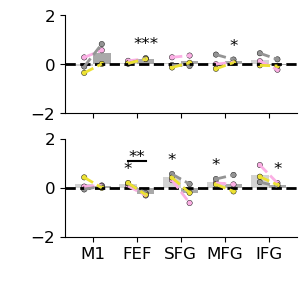

In [234]:
sig_df = ttest_crossnobis(df,'data_CNLRWT')
results_df,sig_df1 = ttest_paired_sessions(df, 'data_CNLRWT', 'Session 1', 'Session 2')
print(sig_df)
print(sig_df1)

plot_group_dsm_star(df,'Fig3_frontal_CNLRWT.png',selected_roi_labels,subj_labels,
               selected_epoch_labels,'data_CNLRWT',session_palette,sig_df,sig_df1,2,-2,2)

In [235]:
# sig_df = ttest_crossnobis(df,'data_CNLRWT')
# plot_group_dsm_star(df,'Fig3_frontal_CNLRWT.png',selected_roi_labels,subj_labels,
#                selected_epoch_labels,'data_CNLRWT',session_palette,sig_df,2,-2,2)
# print(sig_df)

In [194]:
selected_rois = ['M1','IPS0','IPS1','IPS2','SPL1'] #'IPS3','IPS4','IPS5',
selected_rois_key = ['area4','ips0','ips1','ips2','spl1'] #'ips3','ips4','ips5',dpi=1200
selected_epochs = ['stimulus','delay']
selected_epochs_key = [0,1]
df = dis_val_all[(dis_val_all['roi'].isin(selected_rois)) 
                  & (dis_val_all['epoch'].isin(selected_epochs))]

selected_roi_labels = {key: roi_labels[key] for key in selected_rois_key if key in roi_labels}
selected_epoch_labels = {key: epoch_labels[key] for key in selected_epochs_key if key in epoch_labels}

/tmp/ipykernel_9090/1564962005.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  significant_results_df['epoch'] = pd.Categorical(significant_results_df['epoch'], categories=epoch_order, ordered=True)


<Figure size 800x1600 with 0 Axes>

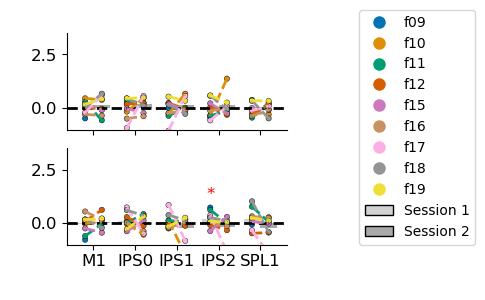

     session  epoch   roi    t_stat   p_value
3  Session 1  delay  IPS2  1.913436  0.046021


In [205]:
sig_df = ttest_crossnobis(df,'data_LR')
plot_group_dsm_star(df,'Fig2_parietal_LR.png',selected_roi_labels,subj_labels,
               selected_epoch_labels,'data_LR',session_palette,sig_df,2,-1,3.5)
print(sig_df)

/tmp/ipykernel_9090/1564962005.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  significant_results_df['epoch'] = pd.Categorical(significant_results_df['epoch'], categories=epoch_order, ordered=True)


<Figure size 800x1600 with 0 Axes>

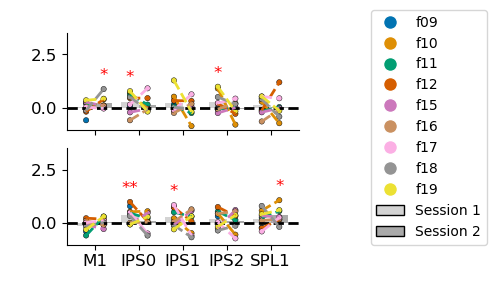

      session     epoch   roi    t_stat   p_value
6   Session 1  stimulus  IPS0  1.909269  0.046318
8   Session 1  stimulus  IPS2  1.943829  0.043913
1   Session 1     delay  IPS0  3.191460  0.006388
2   Session 1     delay  IPS1  2.126295  0.033087
15  Session 2  stimulus    M1  2.410193  0.023380
14  Session 2     delay  SPL1  2.862178  0.012131


In [206]:
sig_df = ttest_crossnobis(df,'data_WT')
plot_group_dsm_star(df,'Fig2_parietal_WT.png',selected_roi_labels,subj_labels,
               selected_epoch_labels,'data_WT',session_palette,sig_df,2,-1,3.5)
print(sig_df)

/tmp/ipykernel_9090/1564962005.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  significant_results_df['epoch'] = pd.Categorical(significant_results_df['epoch'], categories=epoch_order, ordered=True)


<Figure size 800x1600 with 0 Axes>

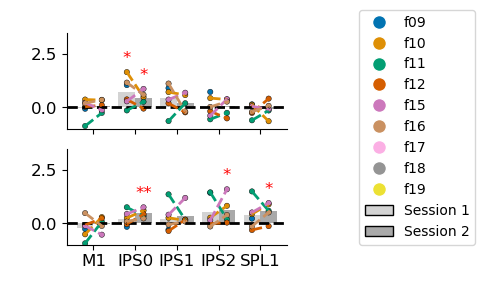

      session     epoch   roi    t_stat   p_value
6   Session 1  stimulus  IPS0  2.693957  0.021547
16  Session 2  stimulus  IPS0  2.786694  0.024739
11  Session 2     delay  IPS0  5.123905  0.003434
13  Session 2     delay  IPS2  2.193292  0.046674
14  Session 2     delay  SPL1  2.946875  0.021050


In [207]:
sig_df = ttest_crossnobis(df,'data_ecc')
plot_group_dsm_star(df,'Fig2_parietal_ecc.png',selected_roi_labels,subj_labels,
               selected_epoch_labels,'data_ecc',session_palette,sig_df,2,-1,3.5)
print(sig_df)

/tmp/ipykernel_9090/1564962005.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  significant_results_df['epoch'] = pd.Categorical(significant_results_df['epoch'], categories=epoch_order, ordered=True)


<Figure size 800x1600 with 0 Axes>

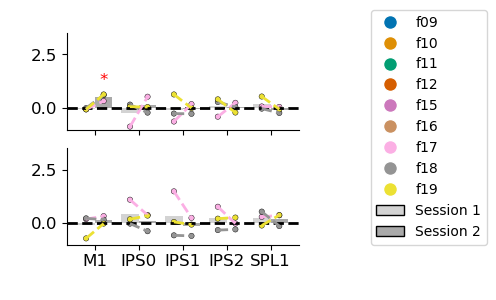

      session     epoch roi    t_stat   p_value
15  Session 2  stimulus  M1  5.380034  0.016428


In [208]:
sig_df = ttest_crossnobis(df,'data_CN')
plot_group_dsm_star(df,'Fig2_parietal_CN.png',selected_roi_labels,subj_labels,
               selected_epoch_labels,'data_CN',session_palette,sig_df,2,-1,3.5)
print(sig_df)

/tmp/ipykernel_9090/1564962005.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  significant_results_df['epoch'] = pd.Categorical(significant_results_df['epoch'], categories=epoch_order, ordered=True)


<Figure size 800x1600 with 0 Axes>

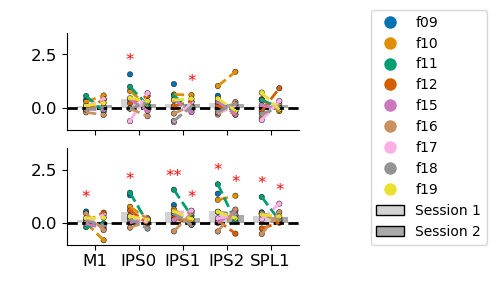

      session     epoch   roi    t_stat   p_value
6   Session 1  stimulus  IPS0  1.986822  0.041088
0   Session 1     delay    M1  1.891881  0.047575
1   Session 1     delay  IPS0  2.870484  0.010407
2   Session 1     delay  IPS1  2.932389  0.009464
3   Session 1     delay  IPS2  2.520785  0.017883
4   Session 1     delay  SPL1  1.999513  0.040288
17  Session 2  stimulus  IPS1  2.045961  0.040003
12  Session 2     delay  IPS1  2.741017  0.014438
13  Session 2     delay  IPS2  2.183329  0.032659
14  Session 2     delay  SPL1  2.963370  0.010502


In [209]:
sig_df = ttest_crossnobis(df,'data_LRWT')
plot_group_dsm_star(df,'Fig2_parietal_LRWT.png',selected_roi_labels,subj_labels,
               selected_epoch_labels,'data_LRWT',session_palette,sig_df,2,-1,3.5)
print(sig_df)

/tmp/ipykernel_9090/1564962005.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  significant_results_df['epoch'] = pd.Categorical(significant_results_df['epoch'], categories=epoch_order, ordered=True)


<Figure size 800x1600 with 0 Axes>

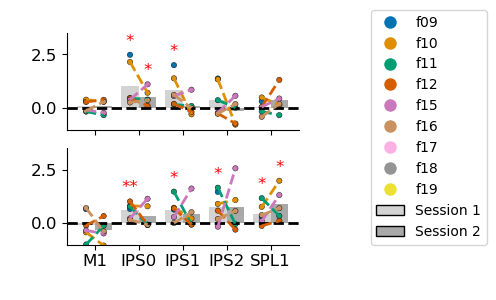

      session     epoch   roi    t_stat   p_value
6   Session 1  stimulus  IPS0  2.534843  0.026110
7   Session 1  stimulus  IPS1  2.779493  0.019463
1   Session 1     delay  IPS0  4.380127  0.003577
2   Session 1     delay  IPS1  3.160532  0.012540
3   Session 1     delay  IPS2  2.686577  0.021738
4   Session 1     delay  SPL1  2.258268  0.036756
16  Session 2  stimulus  IPS0  3.141966  0.017391
14  Session 2     delay  SPL1  2.622245  0.029331


In [210]:
sig_df = ttest_crossnobis(df,'data_eccWT')
plot_group_dsm_star(df,'Fig2_parietal_eccWT.png',selected_roi_labels,subj_labels,
               selected_epoch_labels,'data_eccWT',session_palette,sig_df,2,-1,3.5)
print(sig_df)

/tmp/ipykernel_9090/1564962005.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  significant_results_df['epoch'] = pd.Categorical(significant_results_df['epoch'], categories=epoch_order, ordered=True)


<Figure size 800x1600 with 0 Axes>

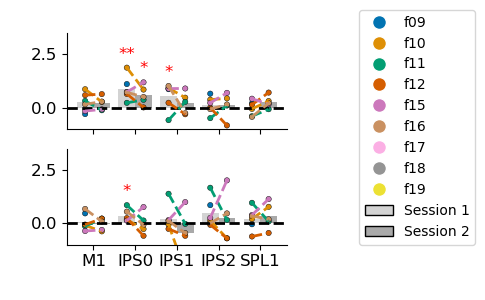

      session     epoch   roi    t_stat   p_value
6   Session 1  stimulus  IPS0  3.851094  0.005994
7   Session 1  stimulus  IPS1  2.163526  0.041409
1   Session 1     delay  IPS0  2.996547  0.015109
16  Session 2  stimulus  IPS0  2.872876  0.022669


In [211]:
sig_df = ttest_crossnobis(df,'data_eccLR')
plot_group_dsm_star(df,'Fig2_parietal_eccLR.png',selected_roi_labels,subj_labels,
               selected_epoch_labels,'data_eccLR',session_palette,sig_df,2,-1,3.5)
print(sig_df)

/tmp/ipykernel_9090/1564962005.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  significant_results_df['epoch'] = pd.Categorical(significant_results_df['epoch'], categories=epoch_order, ordered=True)


<Figure size 800x1600 with 0 Axes>

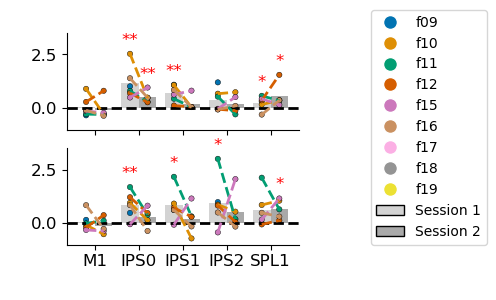

      session     epoch   roi    t_stat   p_value
6   Session 1  stimulus  IPS0  3.828815  0.006131
7   Session 1  stimulus  IPS1  4.500411  0.003199
9   Session 1  stimulus  SPL1  2.056162  0.047448
1   Session 1     delay  IPS0  3.512457  0.008528
2   Session 1     delay  IPS1  2.762756  0.019852
3   Session 1     delay  IPS2  2.090938  0.045396
16  Session 2  stimulus  IPS0  4.035539  0.007831
19  Session 2  stimulus  SPL1  2.213140  0.045653
14  Session 2     delay  SPL1  3.285234  0.015176


In [212]:
sig_df = ttest_crossnobis(df,'data_eccLRWT')
plot_group_dsm_star(df,'Fig2_parietal_eccLRWT.png',selected_roi_labels,subj_labels,
               selected_epoch_labels,'data_eccLRWT',session_palette,sig_df,2,-1,3.5)
print(sig_df)

/tmp/ipykernel_9090/1564962005.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  significant_results_df['epoch'] = pd.Categorical(significant_results_df['epoch'], categories=epoch_order, ordered=True)


<Figure size 800x1600 with 0 Axes>

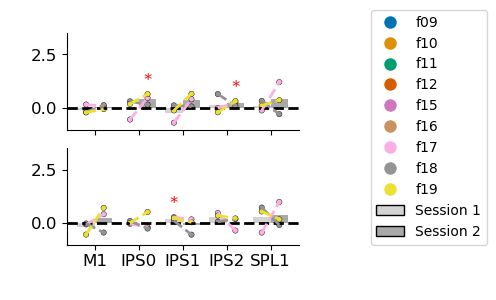

      session     epoch   roi    t_stat   p_value
2   Session 1     delay  IPS1  4.309966  0.024921
16  Session 2  stimulus  IPS0  3.031852  0.046871
18  Session 2  stimulus  IPS2  3.660229  0.033602


In [213]:
sig_df = ttest_crossnobis(df,'data_CNWT')
plot_group_dsm_star(df,'Fig2_parietal_CNWT.png',selected_roi_labels,subj_labels,
               selected_epoch_labels,'data_CNWT',session_palette,sig_df,2,-1,3.5)
print(sig_df)

/tmp/ipykernel_9090/1564962005.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  significant_results_df['epoch'] = pd.Categorical(significant_results_df['epoch'], categories=epoch_order, ordered=True)


<Figure size 800x1600 with 0 Axes>

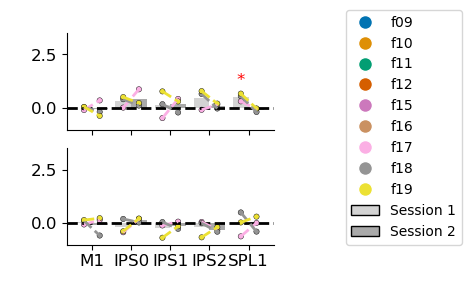

     session     epoch   roi    t_stat   p_value
9  Session 1  stimulus  SPL1  4.876701  0.019785


In [214]:
sig_df = ttest_crossnobis(df,'data_CNLR')
plot_group_dsm_star(df,'Fig2_parietal_CNLR.png',selected_roi_labels,subj_labels,
               selected_epoch_labels,'data_CNLR',session_palette,sig_df,2,-1,3.5)
print(sig_df)

/tmp/ipykernel_9090/1564962005.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  significant_results_df['epoch'] = pd.Categorical(significant_results_df['epoch'], categories=epoch_order, ordered=True)


<Figure size 800x1600 with 0 Axes>

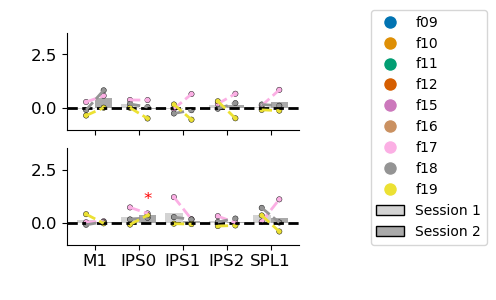

      session  epoch   roi    t_stat   p_value
11  Session 2  delay  IPS0  6.150333  0.012716


In [215]:
sig_df = ttest_crossnobis(df,'data_CNLRWT')
plot_group_dsm_star(df,'Fig2_parietal_CNLRWT.png',selected_roi_labels,subj_labels,
               selected_epoch_labels,'data_CNLRWT',session_palette,sig_df,2,-1,3.5)
print(sig_df)

In [216]:
selected_rois = ['M1','V1','V2']
selected_rois_key = ['area4','v1','v2']
selected_epochs = ['stimulus','delay']
selected_epochs_key = [0,1]
df = dis_val_all[(dis_val_all['roi'].isin(selected_rois)) 
                  & (dis_val_all['epoch'].isin(selected_epochs))]

selected_roi_labels = {key: roi_labels[key] for key in selected_rois_key if key in roi_labels}
selected_epoch_labels = {key: epoch_labels[key] for key in selected_epochs_key if key in epoch_labels}

In [217]:
print(selected_roi_labels)

{'area4': 'M1', 'v1': 'V1', 'v2': 'V2'}


/tmp/ipykernel_9090/1564962005.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  significant_results_df['epoch'] = pd.Categorical(significant_results_df['epoch'], categories=epoch_order, ordered=True)


<Figure size 800x1600 with 0 Axes>

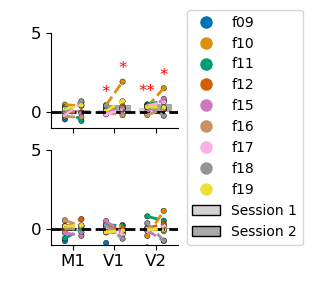

      session     epoch roi    t_stat   p_value
4   Session 1  stimulus  V1  2.062445  0.036541
5   Session 1  stimulus  V2  3.748217  0.002819
10  Session 2  stimulus  V1  1.970324  0.044724
11  Session 2  stimulus  V2  2.662161  0.016183


In [222]:
sig_df = ttest_crossnobis(df,'data_LR')
plot_group_dsm_star(df,'Fig1_visual_LR.png',selected_roi_labels,subj_labels,
               selected_epoch_labels,'data_LR',session_palette,sig_df,1.3,-1,5)
print(sig_df)

/tmp/ipykernel_9090/1564962005.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  significant_results_df['epoch'] = pd.Categorical(significant_results_df['epoch'], categories=epoch_order, ordered=True)


<Figure size 800x1600 with 0 Axes>

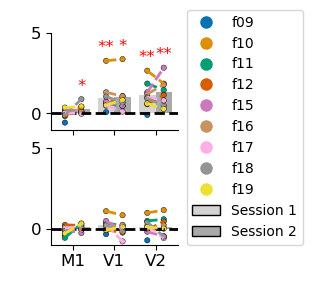

      session     epoch roi    t_stat   p_value
4   Session 1  stimulus  V1  3.098874  0.007345
5   Session 1  stimulus  V2  4.260052  0.001381
9   Session 2  stimulus  M1  2.410193  0.023380
10  Session 2  stimulus  V1  2.831959  0.012667
11  Session 2  stimulus  V2  4.511880  0.001379


In [223]:
sig_df = ttest_crossnobis(df,'data_WT')
plot_group_dsm_star(df,'Fig1_visual_WT.png',selected_roi_labels,subj_labels,
               selected_epoch_labels,'data_WT',session_palette,sig_df,1.3,-1,5)
print(sig_df)

/tmp/ipykernel_9090/1564962005.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  significant_results_df['epoch'] = pd.Categorical(significant_results_df['epoch'], categories=epoch_order, ordered=True)


<Figure size 800x1600 with 0 Axes>

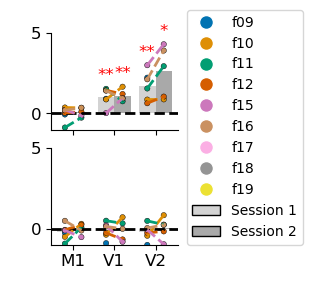

      session     epoch roi    t_stat   p_value
4   Session 1  stimulus  V1  4.451025  0.003348
5   Session 1  stimulus  V2  4.757102  0.002536
10  Session 2  stimulus  V1  6.994123  0.001100
11  Session 2  stimulus  V2  3.681002  0.010593


In [224]:
sig_df = ttest_crossnobis(df,'data_ecc')
plot_group_dsm_star(df,'Fig1_visual_ecc.png',selected_roi_labels,subj_labels,
               selected_epoch_labels,'data_ecc',session_palette,sig_df,1.3,-1,5)
print(sig_df)

/tmp/ipykernel_9090/1564962005.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  significant_results_df['epoch'] = pd.Categorical(significant_results_df['epoch'], categories=epoch_order, ordered=True)


<Figure size 800x1600 with 0 Axes>

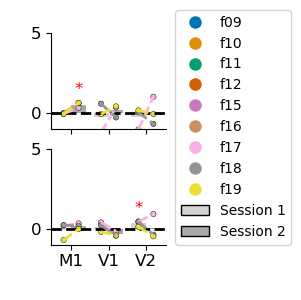

     session     epoch roi    t_stat   p_value
2  Session 1     delay  V2  3.162789  0.043552
9  Session 2  stimulus  M1  5.380034  0.016428


In [225]:
sig_df = ttest_crossnobis(df,'data_CN')
plot_group_dsm_star(df,'Fig1_visual_CN.png',selected_roi_labels,subj_labels,
               selected_epoch_labels,'data_CN',session_palette,sig_df,1.3,-1,5)
print(sig_df)

/tmp/ipykernel_9090/1564962005.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  significant_results_df['epoch'] = pd.Categorical(significant_results_df['epoch'], categories=epoch_order, ordered=True)


<Figure size 800x1600 with 0 Axes>

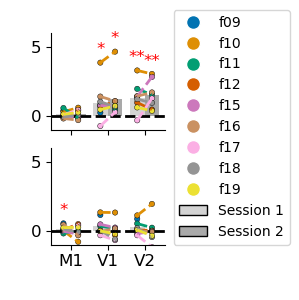

      session     epoch roi    t_stat   p_value
4   Session 1  stimulus  V1  2.251957  0.027200
5   Session 1  stimulus  V2  4.046516  0.001851
0   Session 1     delay  M1  1.891881  0.047575
10  Session 2  stimulus  V1  2.372753  0.024703
11  Session 2  stimulus  V2  4.299774  0.001784


In [229]:
sig_df = ttest_crossnobis(df,'data_LRWT')
plot_group_dsm_star(df,'Fig1_visual_LRWT.png',selected_roi_labels,subj_labels,
               selected_epoch_labels,'data_LRWT',session_palette,sig_df,1.3,-1,6)
print(sig_df)

/tmp/ipykernel_9090/1564962005.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  significant_results_df['epoch'] = pd.Categorical(significant_results_df['epoch'], categories=epoch_order, ordered=True)


<Figure size 800x1600 with 0 Axes>

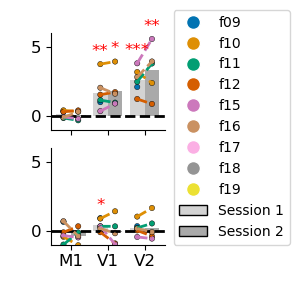

      session     epoch roi    t_stat   p_value
4   Session 1  stimulus  V1  3.380560  0.009831
5   Session 1  stimulus  V2  7.089215  0.000432
1   Session 1     delay  V1  2.595293  0.024262
10  Session 2  stimulus  V1  3.284305  0.015189
11  Session 2  stimulus  V2  4.166370  0.007036


In [228]:
sig_df = ttest_crossnobis(df,'data_eccWT')
plot_group_dsm_star(df,'Fig1_visual_eccWT.png',selected_roi_labels,subj_labels,
               selected_epoch_labels,'data_eccWT',session_palette,sig_df,1.3,-1,6)
print(sig_df)

/tmp/ipykernel_9090/1564962005.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  significant_results_df['epoch'] = pd.Categorical(significant_results_df['epoch'], categories=epoch_order, ordered=True)


<Figure size 800x1600 with 0 Axes>

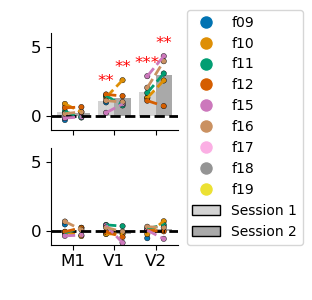

      session     epoch roi    t_stat   p_value
4   Session 1  stimulus  V1  5.567508  0.001287
5   Session 1  stimulus  V2  6.352251  0.000714
10  Session 2  stimulus  V1  3.953603  0.008384
11  Session 2  stimulus  V2  4.586416  0.005067


In [230]:
sig_df = ttest_crossnobis(df,'data_eccLR')
plot_group_dsm_star(df,'Fig1_visual_eccLR.png',selected_roi_labels,subj_labels,
               selected_epoch_labels,'data_eccLR',session_palette,sig_df,1.3,-1,6)
print(sig_df)

/tmp/ipykernel_9090/1564962005.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  significant_results_df['epoch'] = pd.Categorical(significant_results_df['epoch'], categories=epoch_order, ordered=True)


<Figure size 800x1600 with 0 Axes>

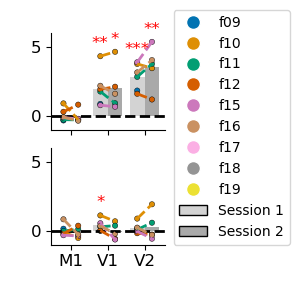

      session     epoch roi    t_stat   p_value
4   Session 1  stimulus  V1  3.742655  0.006697
5   Session 1  stimulus  V2  7.251668  0.000389
1   Session 1     delay  V1  2.359997  0.032376
10  Session 2  stimulus  V1  2.784523  0.024794
11  Session 2  stimulus  V2  5.254265  0.003139


In [231]:
sig_df = ttest_crossnobis(df,'data_eccLRWT')
plot_group_dsm_star(df,'Fig1_visual_eccLRWT.png',selected_roi_labels,subj_labels,
               selected_epoch_labels,'data_eccLRWT',session_palette,sig_df,1.3,-1,6)
print(sig_df)

<Figure size 800x1600 with 0 Axes>

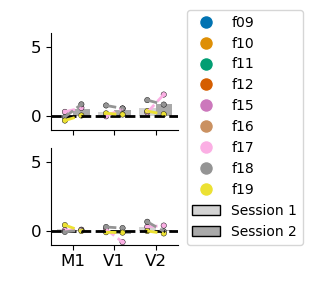

Empty DataFrame
Columns: [session, epoch, roi, t_stat, p_value]
Index: []


In [232]:
sig_df = ttest_crossnobis(df,'data_CNLRWT')
plot_group_dsm_star(df,'Fig1_visual_CNLRWT.png',selected_roi_labels,subj_labels,
               selected_epoch_labels,'data_CNLRWT',session_palette,sig_df,1.3,-1,6)
print(sig_df)

/tmp/ipykernel_9090/1564962005.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  significant_results_df['epoch'] = pd.Categorical(significant_results_df['epoch'], categories=epoch_order, ordered=True)


<Figure size 800x1600 with 0 Axes>

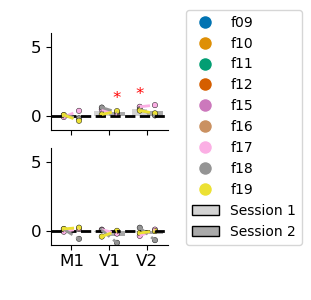

      session     epoch roi    t_stat   p_value
5   Session 1  stimulus  V2  6.195695  0.012538
10  Session 2  stimulus  V1  3.830696  0.030944


In [237]:
sig_df = ttest_crossnobis(df,'data_CNLR')
plot_group_dsm_star(df,'Fig1_visual_CNLR.png',selected_roi_labels,subj_labels,
               selected_epoch_labels,'data_CNLR',session_palette,sig_df,1.4,-1,6)
print(sig_df)

/tmp/ipykernel_9090/1564962005.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  significant_results_df['epoch'] = pd.Categorical(significant_results_df['epoch'], categories=epoch_order, ordered=True)


<Figure size 800x1600 with 0 Axes>

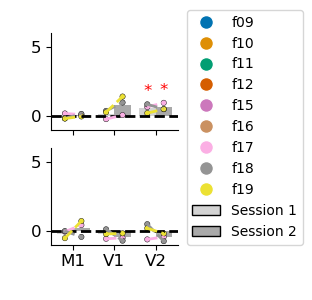

      session     epoch roi    t_stat   p_value
5   Session 1  stimulus  V2  2.920745  0.049978
11  Session 2  stimulus  V2  4.167389  0.026520


In [234]:
sig_df = ttest_crossnobis(df,'data_CNWT')
plot_group_dsm_star(df,'Fig1_visual_CNWT.png',selected_roi_labels,subj_labels,
               selected_epoch_labels,'data_CNWT',session_palette,sig_df,1.3,-1,6)
print(sig_df)

In [62]:
selected_rois = ['M1','IPS0','IPS1','IPS2','IPS3','IPS4','IPS5','SPL1','IPS'] #
selected_rois_key = ['area4','ips0','ips1','ips2','ips3','ips4','ips5','spl1','ips'] #,dpi=1200
selected_epochs = ['stimulus','delay']
selected_epochs_key = [0,1]
df = dis_val_all[(dis_val_all['roi'].isin(selected_rois)) 
                  & (dis_val_all['epoch'].isin(selected_epochs))]

selected_roi_labels = {key: roi_labels[key] for key in selected_rois_key if key in roi_labels}
selected_epoch_labels = {key: epoch_labels[key] for key in selected_epochs_key if key in epoch_labels}

/tmp/ipykernel_9090/1564962005.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  significant_results_df['epoch'] = pd.Categorical(significant_results_df['epoch'], categories=epoch_order, ordered=True)


<Figure size 800x1600 with 0 Axes>

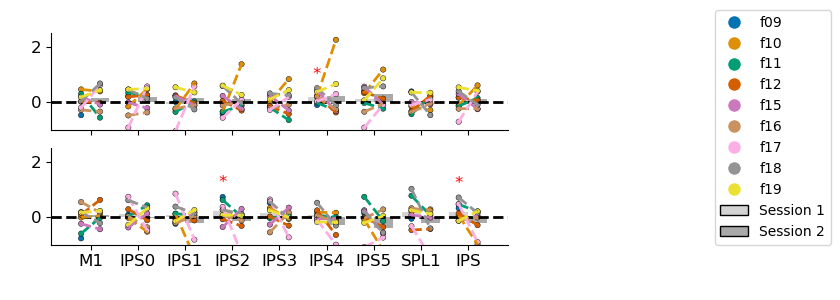

      session     epoch   roi    t_stat   p_value
15  Session 1  stimulus  IPS4  2.855365  0.010651
1   Session 1     delay   IPS  1.912433  0.046092
4   Session 1     delay  IPS2  1.913436  0.046021


In [63]:
sig_df = ttest_crossnobis(df,'data_LR')
plot_group_dsm_star(df,'Fig4_parietal_all_LR.png',selected_roi_labels,subj_labels,
               selected_epoch_labels,'data_LR',session_palette,sig_df,3.5,2.5)
print(sig_df)

/tmp/ipykernel_9090/1564962005.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  significant_results_df['epoch'] = pd.Categorical(significant_results_df['epoch'], categories=epoch_order, ordered=True)


<Figure size 800x1600 with 0 Axes>

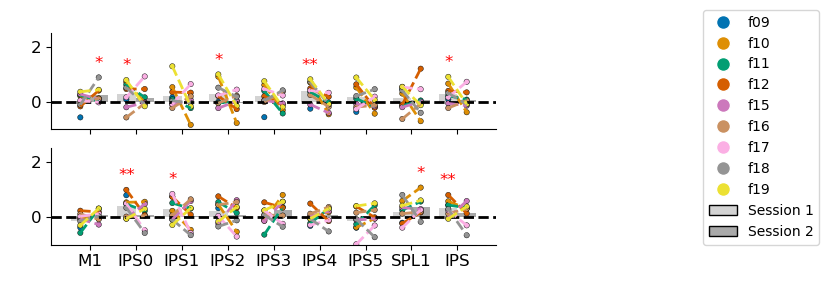

      session     epoch   roi    t_stat   p_value
10  Session 1  stimulus   IPS  2.370737  0.022597
11  Session 1  stimulus  IPS0  1.909269  0.046318
13  Session 1  stimulus  IPS2  1.943829  0.043913
15  Session 1  stimulus  IPS4  3.114012  0.007179
1   Session 1     delay   IPS  3.369861  0.004894
2   Session 1     delay  IPS0  3.191460  0.006388
3   Session 1     delay  IPS1  2.126295  0.033087
27  Session 2  stimulus    M1  2.410193  0.023380
26  Session 2     delay  SPL1  2.862178  0.012131


In [64]:
sig_df = ttest_crossnobis(df,'data_WT')
plot_group_dsm_star(df,'Fig4_parietal_all_WT.png',selected_roi_labels,subj_labels,
               selected_epoch_labels,'data_WT',session_palette,sig_df,3.5,2.5)
print(sig_df)

/tmp/ipykernel_9090/1564962005.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  significant_results_df['epoch'] = pd.Categorical(significant_results_df['epoch'], categories=epoch_order, ordered=True)


<Figure size 800x1600 with 0 Axes>

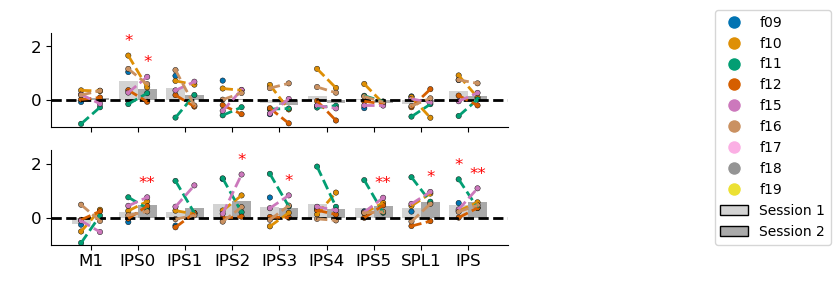

      session     epoch   roi    t_stat   p_value
11  Session 1  stimulus  IPS0  2.693957  0.021547
1   Session 1     delay   IPS  2.244782  0.037382
29  Session 2  stimulus  IPS0  2.786694  0.024739
19  Session 2     delay   IPS  4.224056  0.006717
20  Session 2     delay  IPS0  5.123905  0.003434
22  Session 2     delay  IPS2  2.193292  0.046674
23  Session 2     delay  IPS3  2.712133  0.026710
25  Session 2     delay  IPS5  4.173340  0.006997
26  Session 2     delay  SPL1  2.946875  0.021050


In [65]:
sig_df = ttest_crossnobis(df,'data_ecc')
plot_group_dsm_star(df,'Fig4_parietal_all_ecc.png',selected_roi_labels,subj_labels,
               selected_epoch_labels,'data_ecc',session_palette,sig_df,3.5,2.5)
print(sig_df)

/tmp/ipykernel_9090/1564962005.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  significant_results_df['epoch'] = pd.Categorical(significant_results_df['epoch'], categories=epoch_order, ordered=True)


<Figure size 800x1600 with 0 Axes>

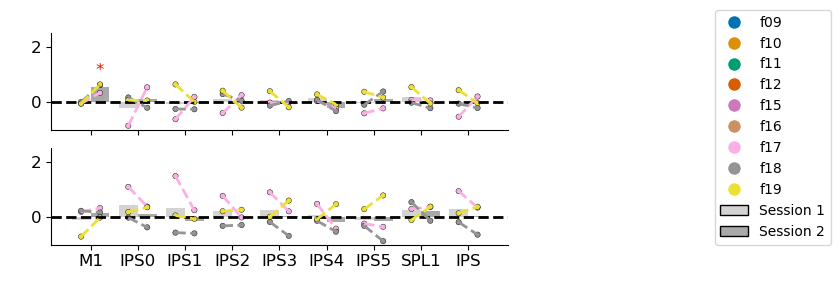

      session     epoch roi    t_stat   p_value
27  Session 2  stimulus  M1  5.380034  0.016428


In [66]:
sig_df = ttest_crossnobis(df,'data_CN')
plot_group_dsm_star(df,'Fig4_parietal_all_CN.png',selected_roi_labels,subj_labels,
               selected_epoch_labels,'data_CN',session_palette,sig_df,3.5,2.5)
print(sig_df)

In [67]:
# Test differences between two sessions

In [68]:
from scipy.stats import ttest_rel
import pandas as pd

def ttest_paired_sessions(dis_val_all, colname, session1, session2):
    # Define the epochs and ROIs you want to analyze
    epochs = dis_val_all['epoch'].unique()
    rois = dis_val_all['roi'].unique()

    results = []

    # Loop through each combination of epoch and ROI
    for epoch in epochs:
        for roi in rois:
            # Filter the dataframe for each session
            data_session1 = dis_val_all[(dis_val_all['session'] == session1) &
                                        (dis_val_all['epoch'] == epoch) &
                                        (dis_val_all['roi'] == roi)][colname].dropna()

            data_session2 = dis_val_all[(dis_val_all['session'] == session2) &
                                        (dis_val_all['epoch'] == epoch) &
                                        (dis_val_all['roi'] == roi)][colname].dropna()

            # Ensure that data lengths match for paired test
            min_length = min(len(data_session1), len(data_session2))
            if min_length > 0:
                # Perform a paired t-test
                t_stat, p_value = ttest_rel(data_session1[:min_length], data_session2[:min_length])

                # Store the result
                results.append({'epoch': epoch, 'roi': roi, 'session1': session1, 'session2': session2, 't_stat': t_stat, 'p_value': p_value})

    # Convert results to a dataframe
    results_df = pd.DataFrame(results)

    # Filter the results to only include rows with p_value less than 0.05
    significant_results_df = results_df[results_df['p_value'] < 0.05]

    # Define custom order for epochs
    epoch_order = ['stimulus', 'delay', 'response']

    # Convert 'epoch' column to a categorical type with the custom order
    significant_results_df['epoch'] = pd.Categorical(significant_results_df['epoch'], categories=epoch_order, ordered=True)

    # Sort by the custom epoch order
    significant_results_df = significant_results_df.sort_values(by='epoch')

    # Print the significant results
    return results_df,significant_results_df


results_df,sig_df = ttest_paired_sessions(dis_val_all, 'data_LR', 'Session 1', 'Session 2')
print(sig_df)

In [70]:
results_df,sig_df = ttest_paired_sessions(dis_val_all, 'data_WT', 'Session 1', 'Session 2')
print(sig_df)

       epoch   roi   session1   session2    t_stat   p_value
42  stimulus  IPS4  Session 1  Session 2  3.193336  0.015206
8      delay  IPS0  Session 1  Session 2  2.945100  0.021556


/tmp/ipykernel_9090/41442368.py:27: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  t_stat, p_value = ttest_rel(data_session1[:min_length], data_session2[:min_length])
/tmp/ipykernel_9090/41442368.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  significant_results_df['epoch'] = pd.Categorical(significant_results_df['epoch'], categories=epoch_order, ordered=True)


In [71]:
results_df,sig_df = ttest_paired_sessions(dis_val_all, 'data_ecc', 'Session 1', 'Session 2')
print(sig_df)

       epoch   roi   session1   session2    t_stat   p_value
23  response  IPS0  Session 1  Session 2 -4.145460  0.014313
29  response  SPL1  Session 1  Session 2  2.798153  0.048904


/tmp/ipykernel_9090/41442368.py:27: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  t_stat, p_value = ttest_rel(data_session1[:min_length], data_session2[:min_length])
/tmp/ipykernel_9090/41442368.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  significant_results_df['epoch'] = pd.Categorical(significant_results_df['epoch'], categories=epoch_order, ordered=True)


In [72]:
results_df,sig_df = ttest_paired_sessions(dis_val_all, 'data_CN', 'Session 1', 'Session 2')
print(sig_df)

       epoch   roi   session1   session2    t_stat   p_value
30  stimulus    M1  Session 1  Session 2 -6.178218  0.025212
42  stimulus  IPS4  Session 1  Session 2  7.718077  0.016376
21  response   MFG  Session 1  Session 2 -7.037533  0.019599


/tmp/ipykernel_9090/41442368.py:27: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  t_stat, p_value = ttest_rel(data_session1[:min_length], data_session2[:min_length])
/tmp/ipykernel_9090/41442368.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  significant_results_df['epoch'] = pd.Categorical(significant_results_df['epoch'], categories=epoch_order, ordered=True)


# Plot each individual RDM

In [238]:
print([np.mod(pp,1) for pp in range(15)])
print([int(pp/1) for pp in range(15)])
print(int(len(order)/len(rdm)))

[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]
15


In [240]:
def plot_rdms(RDM, n_roi, n_sess):
    fig, ax = plt.subplots(n_roi, n_sess, figsize=(5*n_sess, 5*n_roi))  # for six ROIs and 2 sessions per subject

    # Define sizes of the plot
    SMALL_SIZE = 20
    MEDIUM_SIZE = 24
    BIGGER_SIZE = 100

    plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
    plt.rc('axes', titlesize=MEDIUM_SIZE)    # fontsize of the axes title
    plt.rc('axes', labelsize=SMALL_SIZE)     # fontsize of the x and y labels
    plt.rc('xtick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
    plt.rc('ytick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
    plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
    plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title

    for pp in range(len(RDM)):  # for each dataset
        xl = []
        yl = []
        if np.mod(pp, n_sess) == 0:  # if it is the 0th (first), 2nd (actually the third), ... plot, we will plot conditions on y
            yl = RDM[pp].pattern_descriptors['conds']
        if int(pp / n_sess) == n_roi - 1:  # if it is the last two figures
            xl = RDM[pp].pattern_descriptors['conds']  # plot conditions on x

        if n_sess == 1:
            sns.heatmap(RDM[pp].get_matrices()[0], ax=ax[pp], cmap='gray', annot=None, cbar=True, square=True,
                        xticklabels=xl, yticklabels=yl, vmin=-1)
            ax[pp].set_title(RDM[pp].rdm_descriptors['name'])
        else:
            sns.heatmap(RDM[pp].get_matrices().squeeze(), ax=ax[int(pp / n_sess), np.mod(pp, n_sess)], cmap='gray', annot=None, cbar=True, square=True,
                        xticklabels=xl, yticklabels=yl, vmin=-1)
            ax[int(pp / n_sess), np.mod(pp, n_sess)].set_title(RDM[pp].rdm_descriptors['name'])
    return fig

In [241]:
print(RDM[0].get_matrices()[0])

[[ 0.         -0.73246353 -0.10891931 -0.03151799 -0.13666205  0.3097244
  -0.58775727  0.52855591]
 [-0.73246353  0.          0.76202754 -0.47567247  0.21300852 -1.14845819
  -0.98923548  0.98959533]
 [-0.10891931  0.76202754  0.          0.01714445 -0.06025025  1.46239158
  -0.53374515  2.06432883]
 [-0.03151799 -0.47567247  0.01714445  0.         -0.36605119  1.54408426
   0.04720617  0.79075425]
 [-0.13666205  0.21300852 -0.06025025 -0.36605119  0.         -0.77363911
  -1.04527787  0.99035248]
 [ 0.3097244  -1.14845819  1.46239158  1.54408426 -0.77363911  0.
   0.46438043 -1.44595562]
 [-0.58775727 -0.98923548 -0.53374515  0.04720617 -1.04527787  0.46438043
   0.         -0.01621179]
 [ 0.52855591  0.98959533  2.06432883  0.79075425  0.99035248 -1.44595562
  -0.01621179  0.        ]]


In [242]:
#store the subject id and roi name in dictionary, then use the dictionary to retrieve rdms to plot
subj_dict = dict()
roi_dict = dict()
epoch_dict = dict()
for idx, rdm in enumerate(RDM):
    subj = rdm.rdm_descriptors['subj'][0]
    roi = rdm.rdm_descriptors['roi'][0]
    epoch = rdm.rdm_descriptors['epoch']
    
    if subj not in subj_dict:
        subj_dict[subj] = []
    subj_dict[subj].append(idx)
    
    if roi not in roi_dict:
        roi_dict[roi] = []
    roi_dict[roi].append(idx)

    if epoch not in epoch_dict:
        epoch_dict[epoch] = []
    epoch_dict[epoch].append(idx)

In [243]:
print(subj_dict.keys())
print(epoch_dict.keys())
#print(epoch_dict)

dict_keys(['f09', 'f10', 'f11', 'f12', 'f15', 'f16', 'f17', 'f18', 'f19'])
dict_keys(['delay', 'response', 'stimulus'])


f09 delay


<Figure size 640x480 with 0 Axes>

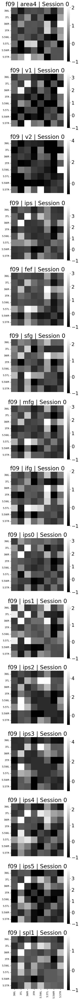

f09 response


<Figure size 640x480 with 0 Axes>

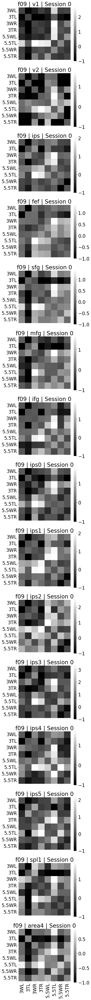

f09 stimulus


<Figure size 640x480 with 0 Axes>

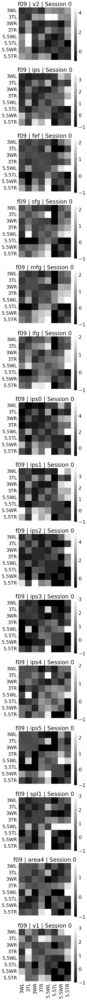

f10 delay


<Figure size 640x480 with 0 Axes>

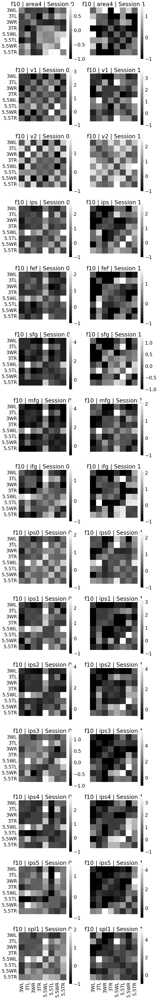

f10 response


<Figure size 640x480 with 0 Axes>

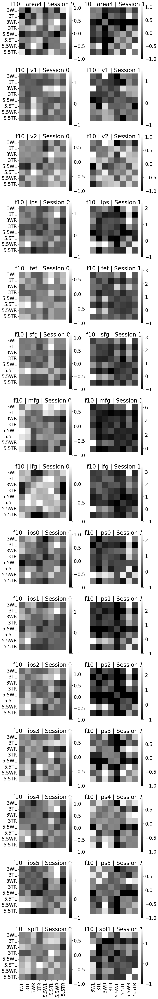

f10 stimulus


<Figure size 640x480 with 0 Axes>

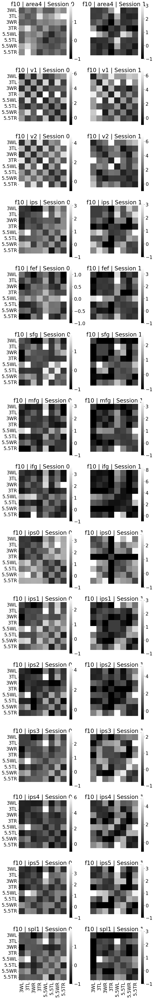

f11 delay


<Figure size 640x480 with 0 Axes>

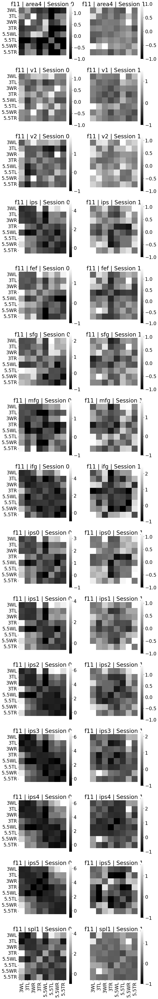

f11 response


<Figure size 640x480 with 0 Axes>

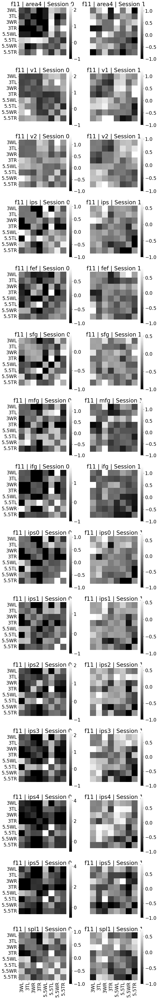

f11 stimulus


<Figure size 640x480 with 0 Axes>

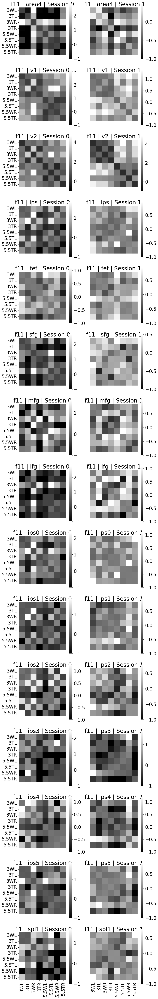

f12 delay


<Figure size 640x480 with 0 Axes>

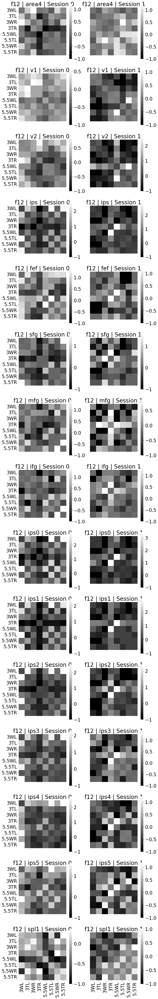

f12 response


<Figure size 640x480 with 0 Axes>

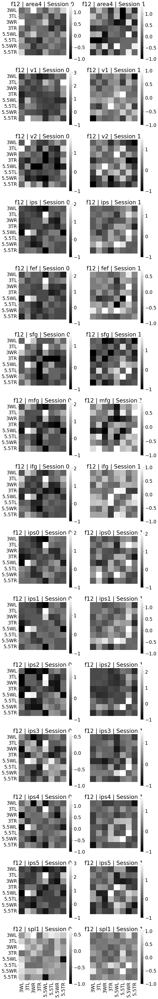

f12 stimulus


<Figure size 640x480 with 0 Axes>

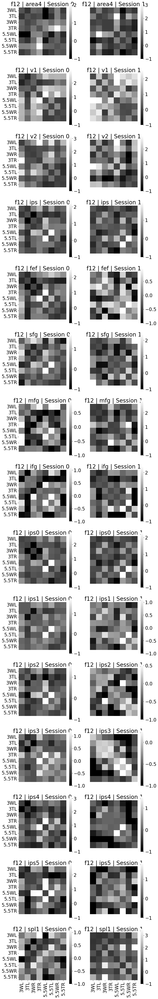

f15 delay


<Figure size 640x480 with 0 Axes>

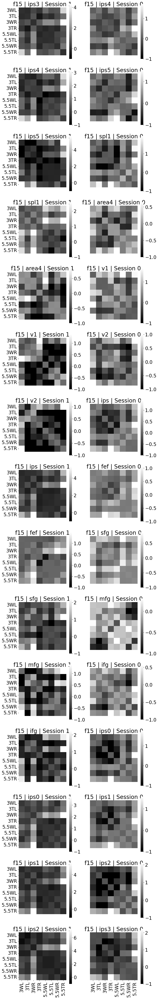

f15 response


<Figure size 640x480 with 0 Axes>

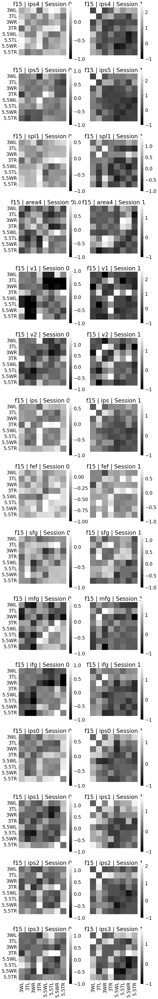

f15 stimulus


<Figure size 640x480 with 0 Axes>

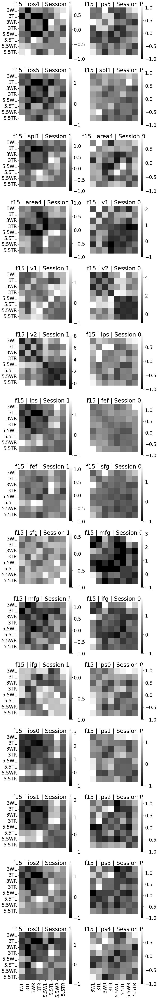

f16 delay


<Figure size 640x480 with 0 Axes>

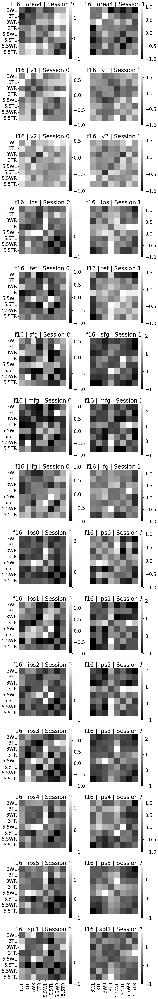

f16 response


<Figure size 640x480 with 0 Axes>

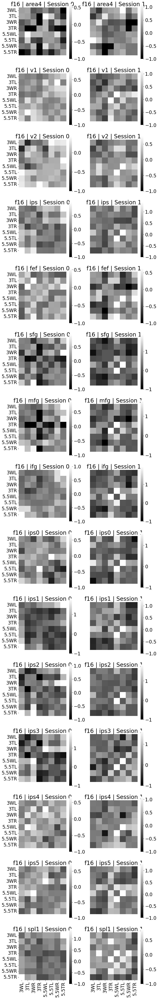

f16 stimulus


<Figure size 640x480 with 0 Axes>

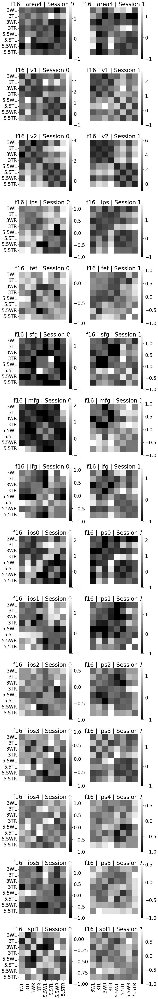

f17 delay


<Figure size 640x480 with 0 Axes>

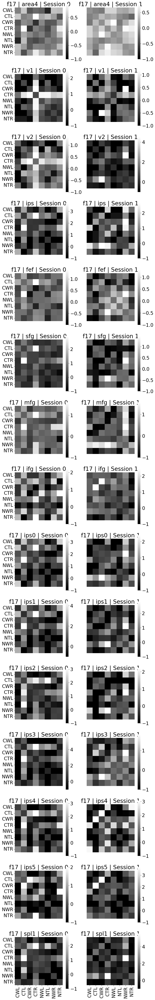

f17 response


<Figure size 640x480 with 0 Axes>

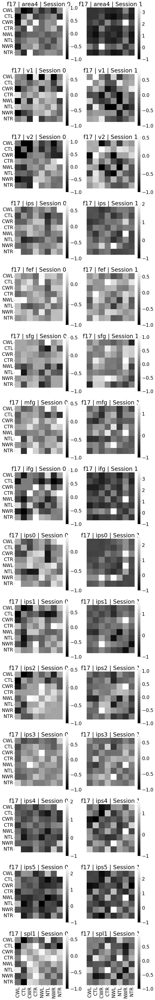

f17 stimulus


<Figure size 640x480 with 0 Axes>

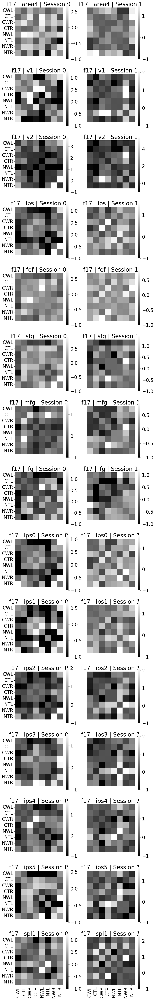

f18 delay


<Figure size 640x480 with 0 Axes>

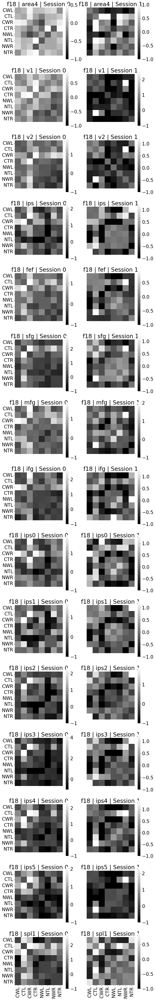

f18 response


<Figure size 640x480 with 0 Axes>

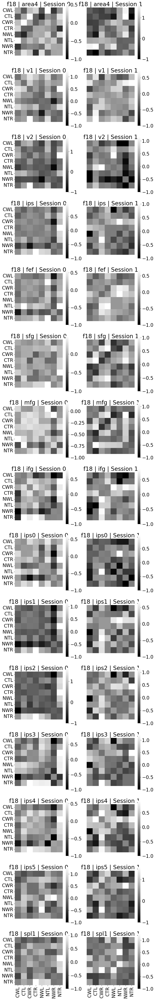

f18 stimulus


<Figure size 640x480 with 0 Axes>

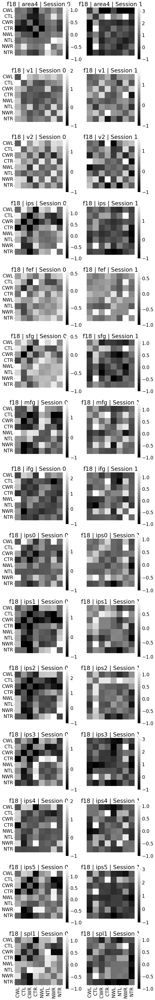

f19 delay


<Figure size 640x480 with 0 Axes>

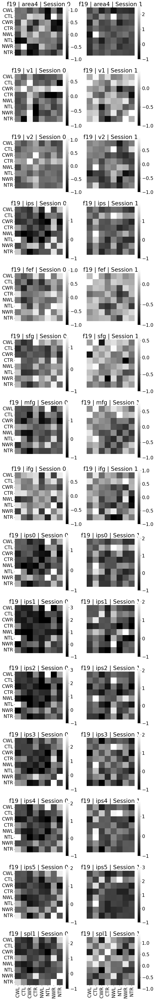

f19 response


<Figure size 640x480 with 0 Axes>

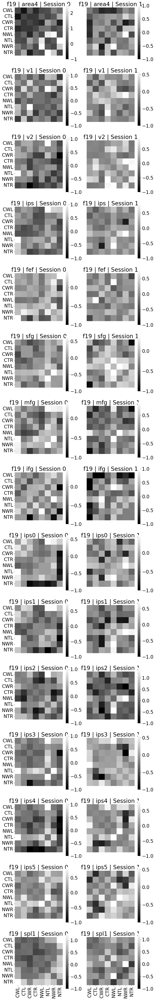

f19 stimulus


<Figure size 640x480 with 0 Axes>

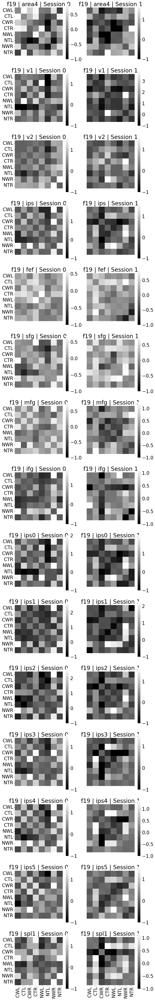

In [244]:
#use the dictionary to retrieve rdms to plot
for subj in subj_dict.keys():
    for epoch in epoch_dict.keys():
        idx_set = set(subj_dict[subj]) & set(epoch_dict[epoch])
        idx = list(idx_set)
        print(subj,epoch)
#         print([RDM[i].rdm_descriptors['name'] for i in idx])
        rdm = [RDM[i] for i in idx]
        plt.clf()
        fig = plot_rdms(rdm,len(order),int(len(rdm)/len(order))) # number of conditions, number of sessions
        plt.show()
        fig.savefig(subj+'/RDM_crossnobis_residual_'+epoch+'_all.png',bbox_inches = 'tight')

/tmp/ipykernel_9090/3331445406.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(2, len(order),figsize=(5*len(order),10)) # for six ROIs and 2 sessions per subject


KeyboardInterrupt: 

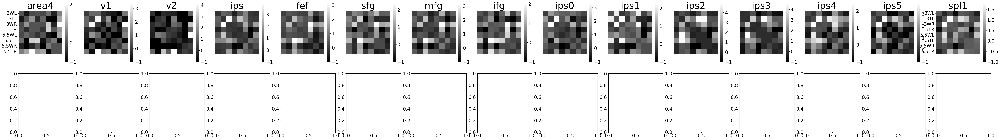

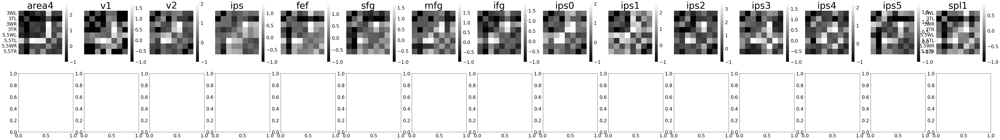

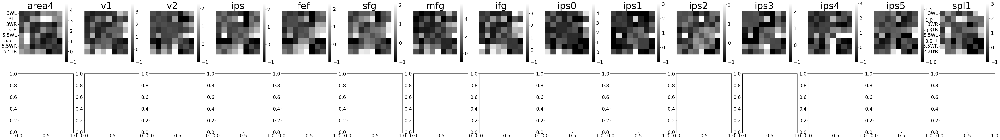

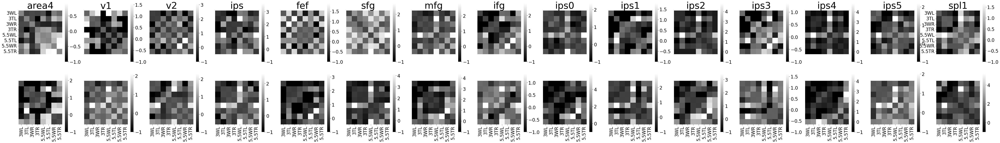

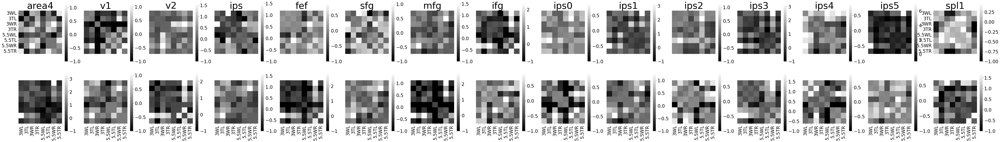

...

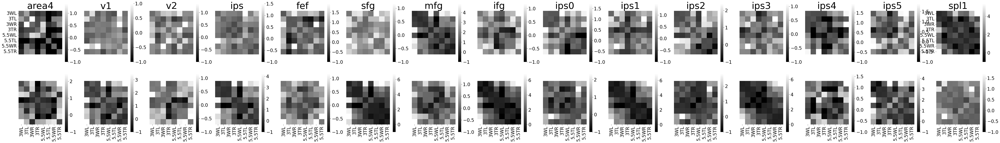

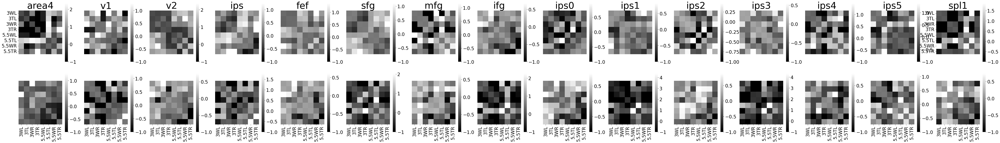

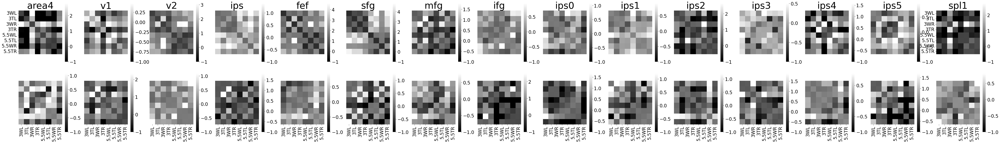

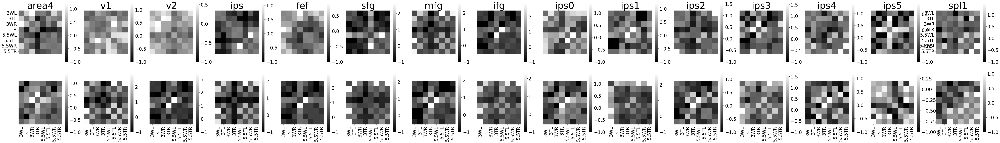

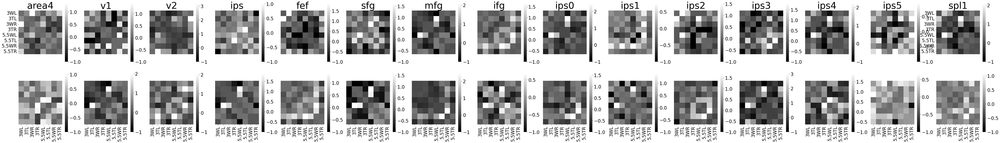

Error in callback <function flush_figures at 0x2aabafbe5300> (for post_execute):


KeyboardInterrupt: 

In [269]:
# Plot RDM for papers
for subj in subj_dict.keys():
    for epoch in epoch_dict.keys():
        idx_set = set(subj_dict[subj]) & set(epoch_dict[epoch])
        idx = list(idx_set)
        #print(subj,epoch)
#         print([RDM[i].rdm_descriptors['name'] for i in idx])
        rdm = [RDM[i] for i in idx]
    
        # Plot RDMs by ROI
        fig, ax = plt.subplots(2, len(order),figsize=(5*len(order),10)) # for six ROIs and 2 sessions per subject
        # define sizes of the plot
        SMALL_SIZE = 20
        MEDIUM_SIZE = 20
        BIGGER_SIZE = 100

        plt.rc('font', size=30)          # controls default text sizes
        plt.rc('axes', titlesize=40)     # fontsize of the axes title
        plt.rc('axes', labelsize=40)    # fontsize of the x and y labels
        plt.rc('xtick', labelsize=20)    # fontsize of the tick labels
        plt.rc('ytick', labelsize=20)    # fontsize of the tick labels
        plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
        plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title

        for pp in range(len(rdm)): # for each dataset
            sess = np.floor(pp/len(order)).astype(int)
            cols = np.mod(pp,len(order))
            xl = []
            yl = []
            if (pp == 0) | (pp == len(order)-1): # if it is the 0th (first), 2nd (actually the third), ... plot, we will plot conditions on y
                yl = rdm[pp].pattern_descriptors['conds']
            if pp >= len(order): 
                xl = rdm[pp].pattern_descriptors['conds'] # plot conditions on x for all figures

            sns.heatmap(rdm[pp].get_matrices().squeeze(),ax = ax[sess,cols],cmap='gray',annot=None,cbar=True,square=True,
                            xticklabels=xl,
                             yticklabels=yl,vmin=-1) #vmin=0, vmax=1,
            #ax[pp].set_title(RDM_mean[pp].rdm_descriptors['roi'][0])
            if pp < len(order):
                ax[sess,cols].set_title(order[cols])


        fig.savefig('rdm_crossnobis_'+subj+'_'+epoch+'_.png',bbox_inches = 'tight',dpi = 300)


# Plot figures for the thesis

In [273]:
for subj in subj_dict.keys():
    for epoch in epoch_dict.keys():
        idx_set = set(subj_dict[subj]) & set(epoch_dict[epoch])
        idx = list(idx_set)
        #print(subj,epoch)
#         print([RDM[i].rdm_descriptors['name'] for i in idx])
        rdm1 = [RDM[i] for i in idx]

In [287]:
print(rdm[pp].rdm_descriptors)

{'subj': ['f19'], 'roi': ['v1'], 'name': 'f19 | v1 | Session 0', 'index': [0], 'session': 0, 'session_name': 'S5934', 'epoch': 'stimulus'}


In [329]:
tlt = rdm[pp].rdm_descriptors['subj'][0] + ' | ' + 'Session '+str(rdm[pp].rdm_descriptors['session']+1) + ' | '+ rdm[pp].rdm_descriptors['roi'][0]
print(tlt)

f10 | Session 2 | ifg


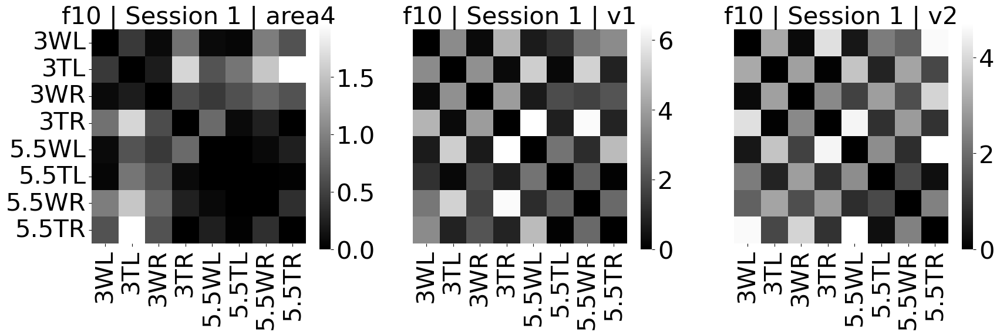

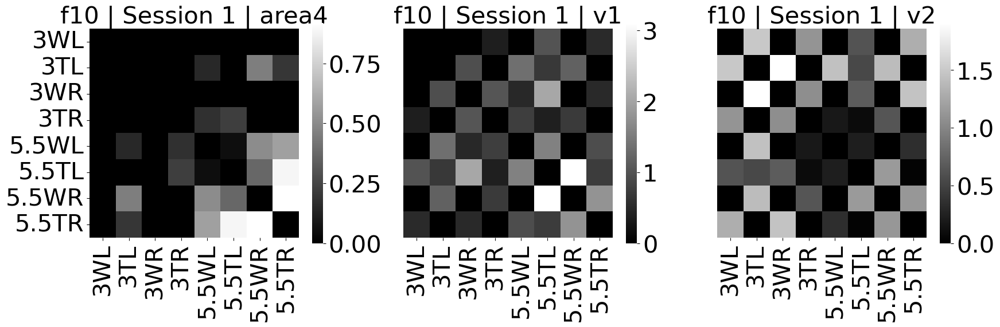

In [345]:
subj = 'f10'

for epoch in ['stimulus','delay']:
    
    idx_set = set(subj_dict[subj]) & set(epoch_dict[epoch])
    idx = list(idx_set)
    rdm1 = [RDM[i] for i in idx]
    idx = [0,2,4]
    rdm = [rdm1[i] for i in idx]

    # Plot RDMs by ROI - visual areas
    fig, ax = plt.subplots(1,3,figsize=(20,5)) # for six ROIs and 2 sessions per subject
    # define sizes of the plot
    SMALL_SIZE = 20
    MEDIUM_SIZE = 20
    BIGGER_SIZE = 100

    plt.rc('font', size=30)          # controls default text sizes
    plt.rc('axes', titlesize=30)     # fontsize of the axes title
    plt.rc('axes', labelsize=40)    # fontsize of the x and y labels
    plt.rc('xtick', labelsize=30)    # fontsize of the tick labels
    plt.rc('ytick', labelsize=30)    # fontsize of the tick labels
    plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
    plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title

    for pp in range(len(rdm)): # for each dataset
      #  sess = np.floor(pp/len(order)).astype(int)
      #  cols = np.mod(pp,len(order))
        xl = []
        yl = []
        if pp == 0:#len(rdm)-1: # if it is the 0th (first), 2nd (actually the third), ... plot, we will plot conditions on y
            yl = rdm[pp].pattern_descriptors['conds']
    #     if pp >= len(order): 
        xl = rdm[pp].pattern_descriptors['conds'] # plot conditions on x for all figures

        sns.heatmap(rdm[pp].get_matrices().squeeze(),ax = ax[pp],cmap='gray',annot=None,cbar=True,square=True,
                        xticklabels=xl,
                         yticklabels=yl,vmin=0) #vmin=0, vmax=1,
        #ax[pp].set_title(RDM_mean[pp].rdm_descriptors['roi'][0])
       # if pp < len(order):
        tlt = rdm[pp].rdm_descriptors['subj'][0] + ' | ' + 'Session '+str(rdm[pp].rdm_descriptors['session']+1) + ' | '+ rdm[pp].rdm_descriptors['roi'][0]
        ax[pp].set_title(tlt)

        fig.savefig('Fig_rdm_crossnobis_visual_'+subj+'_'+epoch+'_sess1.png',bbox_inches = 'tight',dpi = 300)

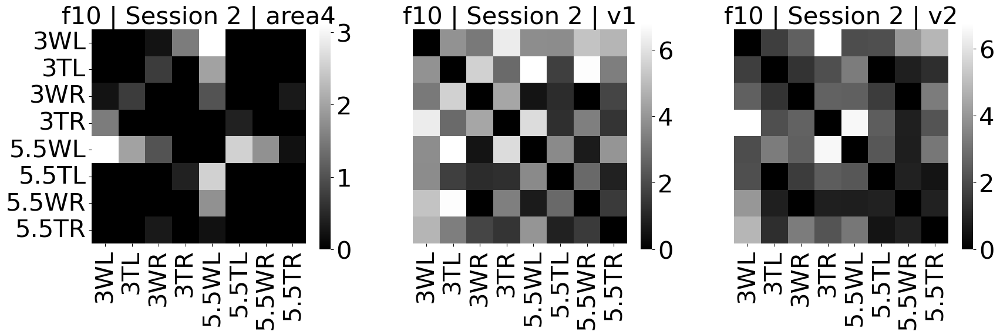

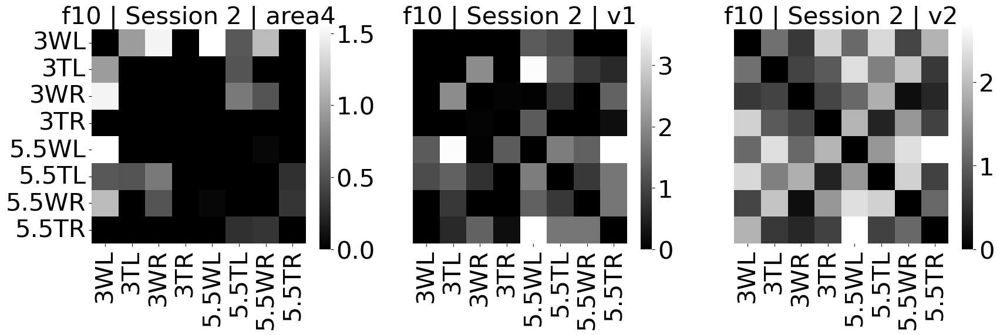

In [346]:
subj = 'f10'

for epoch in ['stimulus','delay']:
    
    idx_set = set(subj_dict[subj]) & set(epoch_dict[epoch])
    idx = list(idx_set)
    rdm1 = [RDM[i] for i in idx]
    idx = [1,3,5]
    rdm = [rdm1[i] for i in idx]

    # Plot RDMs by ROI - visual areas
    fig, ax = plt.subplots(1,3,figsize=(20,5)) # for six ROIs and 2 sessions per subject
    # define sizes of the plot
    SMALL_SIZE = 20
    MEDIUM_SIZE = 20
    BIGGER_SIZE = 100

    plt.rc('font', size=30)          # controls default text sizes
    plt.rc('axes', titlesize=30)     # fontsize of the axes title
    plt.rc('axes', labelsize=40)    # fontsize of the x and y labels
    plt.rc('xtick', labelsize=30)    # fontsize of the tick labels
    plt.rc('ytick', labelsize=30)    # fontsize of the tick labels
    plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
    plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title

    for pp in range(len(rdm)): # for each dataset
      #  sess = np.floor(pp/len(order)).astype(int)
      #  cols = np.mod(pp,len(order))
        xl = []
        yl = []
        if pp == 0:#len(rdm)-1: # if it is the 0th (first), 2nd (actually the third), ... plot, we will plot conditions on y
            yl = rdm[pp].pattern_descriptors['conds']
    #     if pp >= len(order): 
        xl = rdm[pp].pattern_descriptors['conds'] # plot conditions on x for all figures

        sns.heatmap(rdm[pp].get_matrices().squeeze(),ax = ax[pp],cmap='gray',annot=None,cbar=True,square=True,
                        xticklabels=xl,
                         yticklabels=yl,vmin=0) #vmin=0, vmax=1,
        #ax[pp].set_title(RDM_mean[pp].rdm_descriptors['roi'][0])
       # if pp < len(order):
        tlt = rdm[pp].rdm_descriptors['subj'][0] + ' | ' + 'Session '+str(rdm[pp].rdm_descriptors['session']+1) + ' | '+ rdm[pp].rdm_descriptors['roi'][0]
        ax[pp].set_title(tlt)

        fig.savefig('Fig_rdm_crossnobis_visual_'+subj+'_'+epoch+'_sess2.png',bbox_inches = 'tight',dpi = 300)

In [303]:
subj = 'f12'
epoch = 'stimulus'
idx_set = set(subj_dict[subj]) & set(epoch_dict[epoch])
idx = list(idx_set)
rdm1 = [RDM[i] for i in idx]
idx = [0,16,18,20,28]
rdm = [rdm1[i] for i in idx]

In [304]:
print(order)

['area4', 'v1', 'v2', 'ips', 'fef', 'sfg', 'mfg', 'ifg', 'ips0', 'ips1', 'ips2', 'ips3', 'ips4', 'ips5', 'spl1']


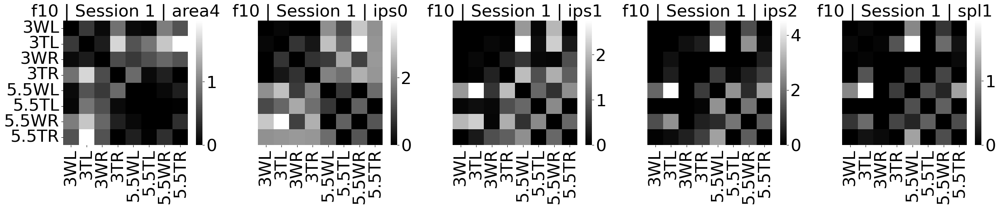

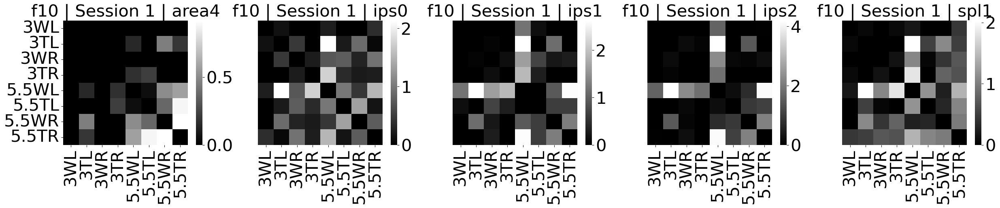

In [352]:
subj = 'f10'

for epoch in ['stimulus','delay']:
    
    idx_set = set(subj_dict[subj]) & set(epoch_dict[epoch])
    idx = list(idx_set)
    rdm1 = [RDM[i] for i in idx]
    idx = [0,16,18,20,28]
    rdm = [rdm1[i] for i in idx]

    # Plot RDMs by ROI - parietal areas
    fig, ax = plt.subplots(1,5,figsize=(30,4)) # for six ROIs and 2 sessions per subject
    # define sizes of the plot
    SMALL_SIZE = 20
    MEDIUM_SIZE = 20
    BIGGER_SIZE = 100

    plt.rc('font', size=30)          # controls default text sizes
    plt.rc('axes', titlesize=30)     # fontsize of the axes title
    plt.rc('axes', labelsize=40)    # fontsize of the x and y labels
    plt.rc('xtick', labelsize=30)    # fontsize of the tick labels
    plt.rc('ytick', labelsize=30)    # fontsize of the tick labels
    plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
    plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title

    for pp in range(len(rdm)): # for each dataset
      #  sess = np.floor(pp/len(order)).astype(int)
      #  cols = np.mod(pp,len(order))
        xl = []
        yl = []
        if pp == 0:#len(rdm)-1: # if it is the 0th (first), 2nd (actually the third), ... plot, we will plot conditions on y
            yl = rdm[pp].pattern_descriptors['conds']
    #     if pp >= len(order): 
        xl = rdm[pp].pattern_descriptors['conds'] # plot conditions on x for all figures

        sns.heatmap(rdm[pp].get_matrices().squeeze(),ax = ax[pp],cmap='gray',annot=None,cbar=True,square=True,
                        xticklabels=xl,
                         yticklabels=yl,vmin=0) #vmin=0, vmax=1,
        #ax[pp].set_title(RDM_mean[pp].rdm_descriptors['roi'][0])
       # if pp < len(order):
        tlt = rdm[pp].rdm_descriptors['subj'][0] + ' | ' + 'Session '+str(rdm[pp].rdm_descriptors['session']+1) + ' | '+ rdm[pp].rdm_descriptors['roi'][0]
        ax[pp].set_title(tlt)
        fig.savefig('Fig_rdm_crossnobis_parietal_'+subj+'_'+epoch+'_sess1.png',bbox_inches = 'tight',dpi = 300)

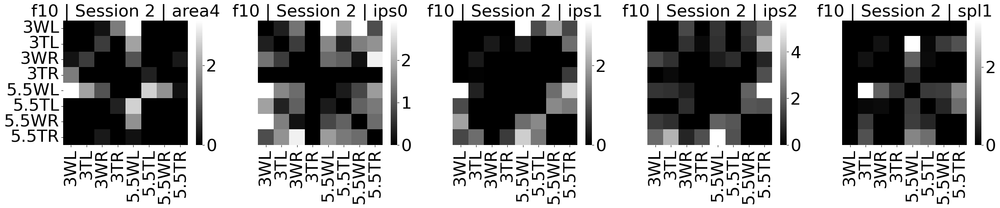

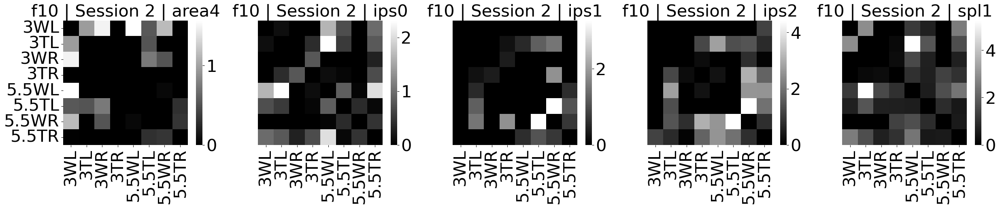

In [353]:
subj = 'f10'

for epoch in ['stimulus','delay']:
    
    idx_set = set(subj_dict[subj]) & set(epoch_dict[epoch])
    idx = list(idx_set)
    rdm1 = [RDM[i] for i in idx]
    idx = [1,17,19,21,29]
    rdm = [rdm1[i] for i in idx]

    # Plot RDMs by ROI - parietal areas
    fig, ax = plt.subplots(1,5,figsize=(30,4)) # for six ROIs and 2 sessions per subject
    # define sizes of the plot
    SMALL_SIZE = 20
    MEDIUM_SIZE = 20
    BIGGER_SIZE = 100

    plt.rc('font', size=30)          # controls default text sizes
    plt.rc('axes', titlesize=30)     # fontsize of the axes title
    plt.rc('axes', labelsize=40)    # fontsize of the x and y labels
    plt.rc('xtick', labelsize=30)    # fontsize of the tick labels
    plt.rc('ytick', labelsize=30)    # fontsize of the tick labels
    plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
    plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title

    for pp in range(len(rdm)): # for each dataset
      #  sess = np.floor(pp/len(order)).astype(int)
      #  cols = np.mod(pp,len(order))
        xl = []
        yl = []
        if pp == 0:#len(rdm)-1: # if it is the 0th (first), 2nd (actually the third), ... plot, we will plot conditions on y
            yl = rdm[pp].pattern_descriptors['conds']
    #     if pp >= len(order): 
        xl = rdm[pp].pattern_descriptors['conds'] # plot conditions on x for all figures

        sns.heatmap(rdm[pp].get_matrices().squeeze(),ax = ax[pp],cmap='gray',annot=None,cbar=True,square=True,
                        xticklabels=xl,
                         yticklabels=yl,vmin=0) #vmin=0, vmax=1,
        #ax[pp].set_title(RDM_mean[pp].rdm_descriptors['roi'][0])
       # if pp < len(order):
        tlt = rdm[pp].rdm_descriptors['subj'][0] + ' | ' + 'Session '+str(rdm[pp].rdm_descriptors['session']+1) + ' | '+ rdm[pp].rdm_descriptors['roi'][0]
        ax[pp].set_title(tlt)
        fig.savefig('Fig_rdm_crossnobis_parietal_'+subj+'_'+epoch+'_sess2.png',bbox_inches = 'tight',dpi = 300)

In [308]:
subj = 'f12'
epoch = 'stimulus'
idx_set = set(subj_dict[subj]) & set(epoch_dict[epoch])
idx = list(idx_set)
rdm1 = [RDM[i] for i in idx]
idx = [0,8,10,12,14]
rdm = [rdm1[i] for i in idx]

In [302]:
print(order)

['area4', 'v1', 'v2', 'ips', 'fef', 'sfg', 'mfg', 'ifg', 'ips0', 'ips1', 'ips2', 'ips3', 'ips4', 'ips5', 'spl1']


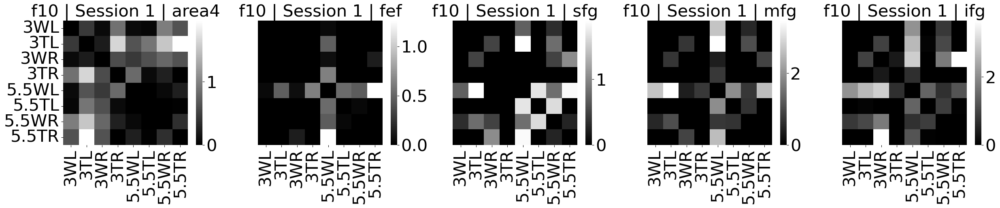

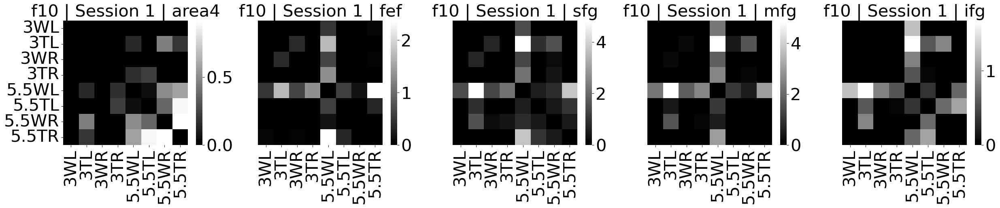

In [354]:
subj = 'f10'

for epoch in ['stimulus','delay']:
    
    idx_set = set(subj_dict[subj]) & set(epoch_dict[epoch])
    idx = list(idx_set)
    rdm1 = [RDM[i] for i in idx]
    idx = [0,8,10,12,14]
    rdm = [rdm1[i] for i in idx]

    # Plot RDMs by ROI - parietal areas
    fig, ax = plt.subplots(1,5,figsize=(30,4)) # for six ROIs and 2 sessions per subject
    # define sizes of the plot
    SMALL_SIZE = 20
    MEDIUM_SIZE = 20
    BIGGER_SIZE = 100

    plt.rc('font', size=30)          # controls default text sizes
    plt.rc('axes', titlesize=30)     # fontsize of the axes title
    plt.rc('axes', labelsize=40)    # fontsize of the x and y labels
    plt.rc('xtick', labelsize=30)    # fontsize of the tick labels
    plt.rc('ytick', labelsize=30)    # fontsize of the tick labels
    plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
    plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title

    for pp in range(len(rdm)): # for each dataset
      #  sess = np.floor(pp/len(order)).astype(int)
      #  cols = np.mod(pp,len(order))
        xl = []
        yl = []
        if pp == 0:#len(rdm)-1: # if it is the 0th (first), 2nd (actually the third), ... plot, we will plot conditions on y
            yl = rdm[pp].pattern_descriptors['conds']
    #     if pp >= len(order): 
        xl = rdm[pp].pattern_descriptors['conds'] # plot conditions on x for all figures

        sns.heatmap(rdm[pp].get_matrices().squeeze(),ax = ax[pp],cmap='gray',annot=None,cbar=True,square=True,
                        xticklabels=xl,
                         yticklabels=yl,vmin=0) #vmin=0, vmax=1,
        #ax[pp].set_title(RDM_mean[pp].rdm_descriptors['roi'][0])
       # if pp < len(order):
        tlt = rdm[pp].rdm_descriptors['subj'][0] + ' | ' + 'Session '+str(rdm[pp].rdm_descriptors['session']+1) + ' | '+ rdm[pp].rdm_descriptors['roi'][0]
        ax[pp].set_title(tlt)
        fig.savefig('Fig_rdm_crossnobis_frontal_'+subj+'_'+epoch+'_sess1.png',bbox_inches = 'tight',dpi = 300)

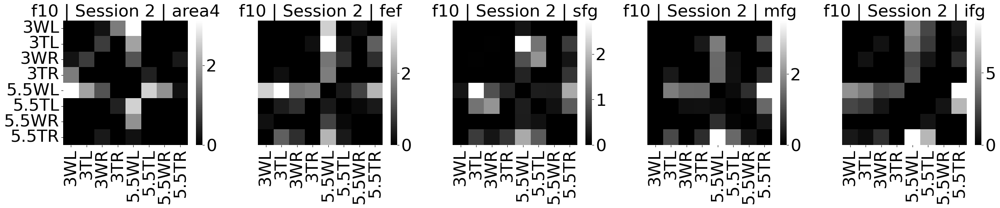

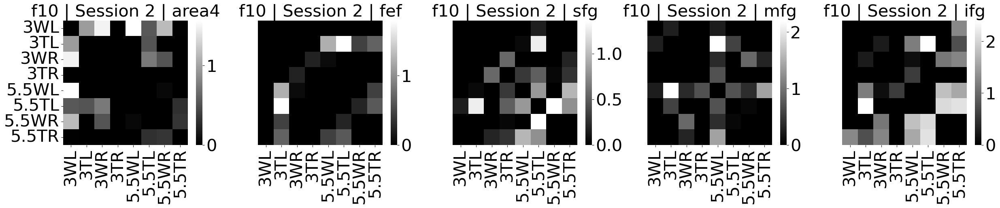

In [355]:
subj = 'f10'

for epoch in ['stimulus','delay']:
    
    idx_set = set(subj_dict[subj]) & set(epoch_dict[epoch])
    idx = list(idx_set)
    rdm1 = [RDM[i] for i in idx]
    idx = [1,9,11,13,15]
    rdm = [rdm1[i] for i in idx]

    # Plot RDMs by ROI - parietal areas
    fig, ax = plt.subplots(1,5,figsize=(30,4)) # for six ROIs and 2 sessions per subject
    # define sizes of the plot
    SMALL_SIZE = 20
    MEDIUM_SIZE = 20
    BIGGER_SIZE = 100

    plt.rc('font', size=30)          # controls default text sizes
    plt.rc('axes', titlesize=30)     # fontsize of the axes title
    plt.rc('axes', labelsize=40)    # fontsize of the x and y labels
    plt.rc('xtick', labelsize=30)    # fontsize of the tick labels
    plt.rc('ytick', labelsize=30)    # fontsize of the tick labels
    plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
    plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title

    for pp in range(len(rdm)): # for each dataset
      #  sess = np.floor(pp/len(order)).astype(int)
      #  cols = np.mod(pp,len(order))
        xl = []
        yl = []
        if pp == 0:#len(rdm)-1: # if it is the 0th (first), 2nd (actually the third), ... plot, we will plot conditions on y
            yl = rdm[pp].pattern_descriptors['conds']
    #     if pp >= len(order): 
        xl = rdm[pp].pattern_descriptors['conds'] # plot conditions on x for all figures

        sns.heatmap(rdm[pp].get_matrices().squeeze(),ax = ax[pp],cmap='gray',annot=None,cbar=True,square=True,
                        xticklabels=xl,
                         yticklabels=yl,vmin=0) #vmin=0, vmax=1,
        #ax[pp].set_title(RDM_mean[pp].rdm_descriptors['roi'][0])
       # if pp < len(order):
        tlt = rdm[pp].rdm_descriptors['subj'][0] + ' | ' + 'Session '+str(rdm[pp].rdm_descriptors['session']+1) + ' | '+ rdm[pp].rdm_descriptors['roi'][0]
        ax[pp].set_title(tlt)
        fig.savefig('Fig_rdm_crossnobis_frontal_'+subj+'_'+epoch+'_sess2.png',bbox_inches = 'tight',dpi = 300)

# Plot group-averaged RDM

In [314]:
with open('rdm_crossnobis_split_by_sess_all.pkg','rb') as f:
    RDM = pickle.load(f)

In [315]:
epochs = ['stimulus','delay', 'response']


In [316]:
#use the dictionary to retrieve rdms to plot - exp 1
for epoch in epochs:
    RDM_mean = []
    for roi in roi_dict.keys():
        idx = []
        for subj in exp1_subjects:
            idx_set = set(roi_dict[roi]) & set(epoch_dict[epoch]) & set(subj_dict[subj])
            idx.extend(list(idx_set))
        #print(len(idx)) # for now, 8 subjects * 2 sessions + 1 subject * 1 session = 17
        #print(idx)
        rdm = copy.deepcopy(RDM[idx[0]])
        rdm.rdm_descriptors.pop('subj', None)
        rdm.rdm_descriptors.pop('session', None)
        rdm.rdm_descriptors.pop('name', None)
        for i in idx[1:]:
            rdm1 = copy.deepcopy(RDM[i])
            rdm1.rdm_descriptors.pop('subj', None)
            rdm1.rdm_descriptors.pop('session', None)
            rdm1.rdm_descriptors.pop('name', None)
            rdm.append(rdm1)

        rdm_mean = rdm.mean()
        rdm_mean.rdm_descriptors['roi'] = [roi]
        #model_rdms.pattern_descriptors['conds'] = cond_names
        #print(rdm_mean)

        if roi == 'area4':
            RDM_mean = rdm_mean
        else:
            RDM_mean.append(rdm_mean)

    # store the mean RDM
    # save the RDMs
    with open(epoch+'_rdm_crossnobis_roi_mean_exp1.pkg','wb') as f:
        pickle.dump(RDM_mean,f)

In [317]:
#use the dictionary to retrieve rdms to plot - exp 2
for epoch in epochs:
    RDM_mean = []
    for roi in roi_dict.keys():
        idx = []
        for subj in exp2_subjects:
            idx_set = set(roi_dict[roi]) & set(epoch_dict[epoch]) & set(subj_dict[subj])
            idx.extend(list(idx_set))
            #print(len(idx)) # for now, 8 subjects * 2 sessions + 1 subject * 1 session = 17
        rdm = copy.deepcopy(RDM[idx[0]])
        rdm.rdm_descriptors.pop('subj', None)
        rdm.rdm_descriptors.pop('session', None)
        rdm.rdm_descriptors.pop('name', None)
        for i in idx[1:]:
            rdm1 = copy.deepcopy(RDM[i])
            rdm1.rdm_descriptors.pop('subj', None)
            rdm1.rdm_descriptors.pop('session', None)
            rdm1.rdm_descriptors.pop('name', None)
            rdm.append(rdm1)

        rdm_mean = rdm.mean()
        rdm_mean.rdm_descriptors['roi'] = [roi]
        #model_rdms.pattern_descriptors['conds'] = cond_names
        #print(rdm_mean)

        if roi == 'area4':
            RDM_mean = rdm_mean
        else:
            RDM_mean.append(rdm_mean)

    # store the mean RDM
    # save the RDMs
    with open(epoch+'_rdm_crossnobis_roi_mean_exp2.pkg','wb') as f:
        pickle.dump(RDM_mean,f)

In [318]:
print(RDM_mean)

rsatoolbox.rdm.RDMs
15 RDM(s) over 8 conditions

dissimilarity_measure = 
crossnobis

dissimilarities[0] = 
[[ 0.         -0.0776376  -0.00913106 -0.0209511  -0.02300666  0.03055679
  -0.00044587 -0.04543644]
 [-0.0776376   0.         -0.0055719  -0.03068698 -0.03361505 -0.03615731
  -0.00891933 -0.03601075]
 [-0.00913106 -0.0055719   0.          0.01921914 -0.01264653  0.12899026
   0.09923335  0.0105112 ]
 [-0.0209511  -0.03068698  0.01921914  0.         -0.02015214 -0.00909786
  -0.00053587 -0.01246901]
 [-0.02300666 -0.03361505 -0.01264653 -0.02015214  0.          0.04030482
   0.06864206 -0.03082216]
 [ 0.03055679 -0.03615731  0.12899026 -0.00909786  0.04030482  0.
   0.02126737 -0.00522332]
 [-0.00044587 -0.00891933  0.09923335 -0.00053587  0.06864206  0.02126737
   0.         -0.03945648]
 [-0.04543644 -0.03601075  0.0105112  -0.01246901 -0.03082216 -0.00522332
  -0.03945648  0.        ]]

descriptors: 
noise = [[ 2.78832682e-01 -3.14504892e-02 -3.20041386e-02 ...  4.97368401e-0

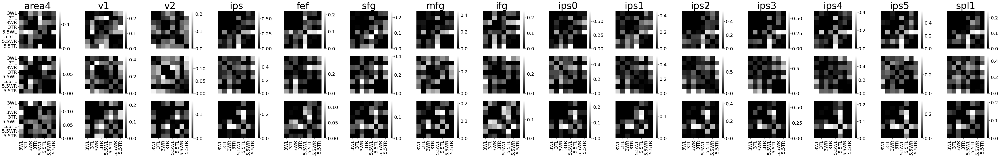

In [323]:
# Plot RDMs by ROI - exp1
fig, ax = plt.subplots(3, len(order),figsize=(5*len(order),10)) # for six ROIs and 2 sessions per subject
# define sizes of the plot
SMALL_SIZE = 20
MEDIUM_SIZE = 20
BIGGER_SIZE = 100

plt.rc('font', size=30)          # controls default text sizes
plt.rc('axes', titlesize=40)     # fontsize of the axes title
plt.rc('axes', labelsize=40)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=20)    # fontsize of the tick labels
plt.rc('ytick', labelsize=20)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title
    
for epoch in range(3):
    with open(epochs[epoch]+'_rdm_crossnobis_roi_mean_exp1.pkg','rb') as f:
        RDM_mean = pickle.load(f)

    for pp in range(len(RDM_mean)): # for each dataset
        xl = []
        yl = []
        if pp == 0: # if it is the 0th (first), 2nd (actually the third), ... plot, we will plot conditions on y
            yl = RDM_mean[pp].pattern_descriptors['conds']
        if epoch == 2: 
            xl = RDM_mean[pp].pattern_descriptors['conds'] # plot conditions on x for all figures

        sns.heatmap(RDM_mean[pp].get_matrices().squeeze(),ax = ax[epoch,pp],cmap='gray',annot=None,cbar=True,square=True,
                        xticklabels=xl,
                         yticklabels=yl,vmin=0) #vmin=0, vmax=1,
        #ax[pp].set_title(RDM_mean[pp].rdm_descriptors['roi'][0])
        if epoch == 0:
            ax[epoch,pp].set_title(order[pp])
        

fig.savefig('rdm_crossnobis_roi_mean_exp1.png',bbox_inches = 'tight',dpi = 300)


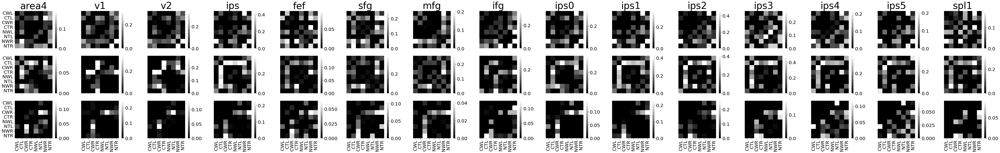

In [322]:
# Plot RDMs by ROI - exp2
fig, ax = plt.subplots(3, len(order),figsize=(5*len(order),10)) # for six ROIs and 2 sessions per subject
# define sizes of the plot
SMALL_SIZE = 20
MEDIUM_SIZE = 20
BIGGER_SIZE = 100

plt.rc('font', size=30)          # controls default text sizes
plt.rc('axes', titlesize=40)     # fontsize of the axes title
plt.rc('axes', labelsize=40)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=20)    # fontsize of the tick labels
plt.rc('ytick', labelsize=20)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title
    
for epoch in range(3):
    with open(epochs[epoch]+'_rdm_crossnobis_roi_mean_exp2.pkg','rb') as f:
        RDM_mean = pickle.load(f)

    for pp in range(len(RDM_mean)): # for each dataset
        xl = []
        yl = []
        if pp == 0: # if it is the 0th (first), 2nd (actually the third), ... plot, we will plot conditions on y
            yl = RDM_mean[pp].pattern_descriptors['conds']
        if epoch == 2: 
            xl = RDM_mean[pp].pattern_descriptors['conds'] # plot conditions on x for all figures

        sns.heatmap(RDM_mean[pp].get_matrices().squeeze(),ax = ax[epoch,pp],cmap='gray',annot=None,cbar=True,square=True,
                        xticklabels=xl,
                         yticklabels=yl,vmin=0) #vmin=0, vmax=1,
        #ax[pp].set_title(RDM_mean[pp].rdm_descriptors['roi'][0])
        if epoch == 0:
            ax[epoch,pp].set_title(order[pp])
        

fig.savefig('rdm_crossnobis_roi_mean_exp2.png',bbox_inches = 'tight',dpi = 300)


In [288]:
print(RDM_mean)

rsatoolbox.rdm.RDMs
15 RDM(s) over 8 conditions

dissimilarity_measure = 
crossnobis

dissimilarities[0] = 
[[ 0.          0.05533966 -0.0477316  -0.04072143  0.01643434 -0.08405781
   0.0438045   0.11340346]
 [ 0.05533966  0.          0.04679137  0.04085441  0.10328156 -0.03481288
   0.19149406  0.13379444]
 [-0.0477316   0.04679137  0.         -0.03982225 -0.0656622  -0.07523514
   0.04324941  0.04106359]
 [-0.04072143  0.04085441 -0.03982225  0.         -0.03806976 -0.04646243
   0.04769898  0.01649557]
 [ 0.01643434  0.10328156 -0.0656622  -0.03806976  0.          0.06214964
  -0.01906835  0.10740069]
 [-0.08405781 -0.03481288 -0.07523514 -0.04646243  0.06214964  0.
  -0.01342058  0.1006856 ]
 [ 0.0438045   0.19149406  0.04324941  0.04769898 -0.01906835 -0.01342058
   0.          0.12898151]
 [ 0.11340346  0.13379444  0.04106359  0.01649557  0.10740069  0.1006856
   0.12898151  0.        ]]

descriptors: 
noise = [[ 2.80830639e-01 -3.53827991e-02 -2.38970791e-02 ...  6.16346076e-03

### MDS plot - 3D - need to be debugged later

In [309]:
print(RDM.n_rdm)


15
dict_keys(['delay', 'response', 'stimulus'])


In [328]:
SMALL_SIZE = 30
MEDIUM_SIZE = 30
BIGGER_SIZE = 100

plt.rc('font', size=SMALL_SIZE)
plt.rc('axes', titlesize=MEDIUM_SIZE)
plt.rc('axes', labelsize=SMALL_SIZE)
plt.rc('xtick', labelsize=SMALL_SIZE)
plt.rc('ytick', labelsize=SMALL_SIZE)
plt.rc('legend', fontsize=SMALL_SIZE)
plt.rc('figure', titlesize=BIGGER_SIZE)

nrows, ncols = 3, RDM.n_rdm
fig = plt.figure(figsize=(25, 8))
    
for idx,epoch in enumerate(epochs):
    print(idx)
    with open(epoch+'_rdm_crossnobis_roi_mean_exp1.pkg','rb') as f:
        RDM = pickle.load(f)
        
    # Do customized plotting
    seed = np.random.RandomState(seed=1)
    MDS = sk.manifold.MDS #if weights is None else Weighted_MDS
    embedding = MDS(
    n_components=3,
    random_state=seed,
    dissimilarity='precomputed',
    # normalized_stress='auto' # drop:py37
    ) # Just show the first THREE dimensions

    rdm_mats = RDM.get_matrices()
    coords = np.full((RDM.n_rdm, RDM.n_cond, 3), np.nan) 
    # for each RDM, there are 8 conditions, and we store the x,y,z coordinates of each condition
    

    for r in range(RDM.n_rdm):
        #     fitKwargs = dict()
        #     if weights is not None:
        #         fitKwargs['weight'] = weight_to_matrices(weights)[r, :, :]
        # if the RDM contains NAN values
        rdm = rdm_mats[r,:,:]

        # create a mask for non-diagnal element
        non_diagonal_mask = ~np.eye(rdm.shape[0],dtype=bool)
        # create a mask for non-NAN element
        non_nan_mask = ~np.isnan(rdm)
        # combine two masks to find non-NAN and non-diagnonal element
        valid_mask = non_diagonal_mask & non_nan_mask
        # get row and column indices of these elements
        rows, cols = np.where(valid_mask)
        # retrieve valid data from RDM
        rdm_new = rdm[np.min(rows):np.max(rows)+1,np.min(cols):np.max(cols)+1]
        
        # perform MDS
        coords[r,np.min(rows):np.max(rows)+1] = embedding.fit_transform(rdm_new)


    # Plotting
    rdm_descriptor = 'roi'
    pattern_descriptor = None

    for r in range(RDM.n_rdm):
        ax = fig.add_subplot(nrows,ncols, r + 1 + ncols*idx, projection='3d')

        if r >= RDM.n_rdm:
            ax.axis('off')
            break

        ax.scatter(coords[r, 0:2, 0], coords[r, 0:2, 1], coords[r, 0:2, 2], s=100, facecolors='none', linewidths=2,
                   edgecolors=[np.array([61, 90, 128]) / 255] * 2, marker='o') # 3WL, 3TL
        ax.scatter(coords[r, 2:4, 0], coords[r, 2:4, 1], coords[r, 2:4, 2], s=100, facecolors='none', linewidths=2,
                   edgecolors=[np.array([166, 75, 53]) / 255] * 2, marker='o') # 3WR, 3TR
        ax.scatter(coords[r, 4:6, 0], coords[r, 4:6, 1], coords[r, 4:6, 2], s=100, facecolors='none', linewidths=2,
                   edgecolors=[np.array([61, 90, 128]) / 255], marker='v') # 5.5WL, 5.5TL
        ax.scatter(coords[r, 6:8, 0], coords[r, 6:8, 1], coords[r, 6:8, 2], s=100, facecolors='none', linewidths=2,
                   edgecolors=[np.array([166, 75, 53]) / 255], marker='v') # 5.5WR, 5.5TR
#                 # Plotting planes
#         ax.plot_trisurf(coords[r, [0,1,4,5], 0], coords[r, [0,1,4,5], 1], coords[r, [0,1,4,5], 2],
#                         color=np.array([61, 90, 128]) / 255, alpha=0.3)
#         ax.plot_trisurf(coords[r, [2,3,6,7], 0], coords[r, [2,3,6,7], 1], coords[r, [2,3,6,7], 2], 
#                         color=np.array([166, 75, 53]) / 255, alpha=0.3)
        
        # 5.5 dva: triangle (v); 3 dva: circle (o)
        # Left: blue; Right: red
        # Wide: darker; Tall: lighter
        
        # Connect darker (wide) and lighter (tall) as planes
        # Connect triangles (5.5dva) and circles (3dva) as planes
        
        ax.legend = RDM[0].pattern_descriptors['conds']
        ax.set_xlim(-0.2, 0.2)
        ax.set_ylim(-0.2, 0.2)
        ax.set_zlim(-0.2, 0.2)
        ax.set_aspect('auto')

        if idx == 0:
            ax.set_title(order[r]) #RDM.rdm_descriptors[rdm_descriptor][r]

        if pattern_descriptor is not None:
            for p in range(coords.shape[1]):
                pat_desc = RDM.pattern_descriptors[pattern_descriptor][p]
                pat_coords = (coords[r, p, 0], coords[r, p, 1], coords[r, p, 2])
                label = ax.annotate(pat_desc, pat_coords)
                label.set_alpha(.6)

        ax.tick_params(axis='both', which='both', bottom=False, top=False,
                       right=False, left=False, labelbottom=False, labeltop=False,
                       labelleft=False, labelright=False)

plt.show()
#fig.savefig(epoch+'_rdm_crossnobis_roi_mean_exp1_mds.png',bbox_inches = 'tight',dpi = 300)

AttributeError: 'list' object has no attribute 'n_rdm'

# THE END